In [247]:
import rasterio as rio
import os
import numpy as np
import matplotlib.pyplot as plt
import shutil
from scipy.interpolate import interp2d
import pandas as pd

from geogrid import GeogridOptical
from autoRIFT import autoRIFT
from osgeo import gdal, osr
import struct
import re
from datetime import date
import datetime
import xml.etree.ElementTree as ET
import urllib.request
import time
import subprocess
import cv2
import scipy.io as sio

from autorift_utilities import rio_write
# os.environ['PROJ_LIB'] = '/Users/jukesliu/opt/anaconda3/envs/newautoriftenv/share/proj'

gdal.AllRegister() # register all GDAL drivers

## 1) Resample DEM and other autoRIFT/geogrid input rasters to the desired chip size

Recommended chip size is >= 16*pixel_resolution

#### Customizable parameters for geogrid:

    dhdx, dhdy:              x/y local surface slope maps (unitless)
    vx,vy:                   x/y reference velocity maps (in units of m/yr)
    srx, sry:                x/y velocity search range limit maps (in units of m/yr)
    csminx, csminy:          x/y chip size minimum maps (in units of m; constant ratio between x and y)
    csmaxx, csmaxy:          x/y chip size maximum maps (in units of m; constant ratio between x and y)
    ssm:                     stable surface mask (boolean)

In [277]:
######### ENTER CHIP SIZE, DEM INFO, AND REFERENCE VELOCITY INFO ########### 
CHIPSIZE_M = 100 # enter in desired grid size in meters (default is 32 pixels)

# enter in the path to your best DEM over the region
# dempath = '/Volumes/SGlacier/TG_autorift_inputs/'
dempath = '/Volumes/SGlacier/VG/autorift_input/'
demname = 'Nolan2021_ASTER_20070903_clipped_5m.tif'

# path to the reference files for geogrid (vx, vy, ssm)
# refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file
refvpath = '/Volumes/SGlacier/VG/autorift_input/'
vx_fname = '' # name of reference vx file (if you don't have anything, use empty quotes)
vy_fname = '' # name of reference vy file

sr_scaling = 16 # multiply by vx and vy to generate search range limits
############################################################################

### Check DEM (critical for georeferencing):

In [278]:
# Read and grab info from your DEM
refdem = rio.open(dempath+demname) # open DEM using rasterio
elev = refdem.read(1) # read in the first and only band (elevations)

# grab the x and y grid values from the DEM:
dem_x = np.linspace(refdem.bounds.left, refdem.bounds.right, num=np.shape(elev)[1])
dem_y = np.linspace(refdem.bounds.top, refdem.bounds.bottom, num=np.shape(elev)[0])

# grab the resampled x and y grid values from the DEM
new_x = np.arange(refdem.bounds.left, refdem.bounds.right, CHIPSIZE_M)
new_y = np.arange(refdem.bounds.top, refdem.bounds.bottom, -CHIPSIZE_M)

(68, 177)


/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/117720316.py:9: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new code, for regular grids use `RegularGridInterpolator` instead.
For scattered data, prefer `LinearNDInterpolator` or
`CloughTocher2DInterpolator`.

For more details see
`https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/117720316.py:10: DeprecationWarning:         `interp2d` is deprecated!
        `interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

        For legacy code, nearly bug-for-bug compatible replacements are
        `RectBivariateSpline` on regular

Resampled to new dimensions: (68, 177)


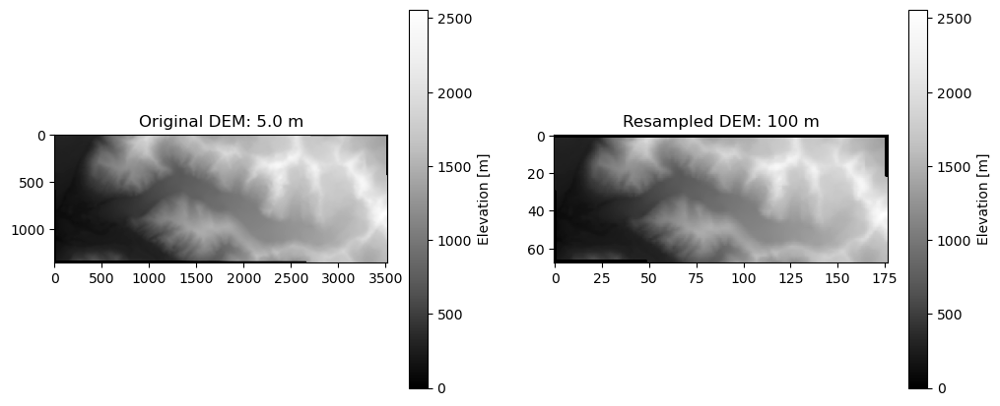

Save resampled DEM to /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif


In [279]:
dem_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m.tif'

if not os.path.exists(dempath+dem_outfile): # if the resampled DEM does not exist already
    # Create thew new x and y grid values using DEM bounds and the chipsize
    dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
    print(dem_resamp.shape)
    
    # Resample to your new DEM bounds
    f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
    dem_resamp = f(new_x,new_y) # resample the NIR data to the DSM coordinates
    dem_resamp = np.flipud(dem_resamp) # flip up down
    print("Resampled to new dimensions:",dem_resamp.shape)
    
    # Display the two DEMs as a visual check
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
    im1 = ax1.imshow(elev, cmap='Greys_r', vmin=0)
    ax1.set_title('Original DEM: '+str(refdem.transform[0])+' m') # original spatial resolution
    fig.colorbar(im1, ax=ax1,label='Elevation [m]')

    im2 = ax2.imshow(dem_resamp, cmap='Greys_r', vmin=0)
    ax2.set_title('Resampled DEM: '+str(CHIPSIZE_M)+' m') # new spatial resolution
    fig.colorbar(im2, ax=ax2,label='Elevation [m]')
    plt.show()
    
    # Save the resampled DEM to georeferenced tif file
    print("Save resampled DEM to", dempath+dem_outfile)
    rio_write(dempath+dem_outfile, dem_resamp, refdem, CHIPSIZE_M)
else:
    # load the empty grid
    dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
    print(dem_outfile, ' already exists.')

In [280]:
def generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling):
    import rasterio as rio
    import os
    
    # GRAB DEM INFO
    refdem = rio.open(dempath+demname) # open DEM using rasterio
    elev = refdem.read(1) # read in the first and only band (elevations)

    # grab the x and y grid values from the DEM:
    dem_x = np.linspace(refdem.bounds.left, refdem.bounds.right, num=np.shape(elev)[1])
    dem_y = np.linspace(refdem.bounds.top, refdem.bounds.bottom, num=np.shape(elev)[0])

    # grab the resampled x and y grid values from the DEM
    new_x = np.arange(refdem.bounds.left, refdem.bounds.right, CHIPSIZE_M)
    new_y = np.arange(refdem.bounds.top, refdem.bounds.bottom, -CHIPSIZE_M)
    
    # RESAMPLE THE DEM
    dem_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m.tif'
    if not os.path.exists(dempath+dem_outfile): # if the resampled DEM does not exist already
        # Create thew new x and y grid values using DEM bounds and the chipsize
        dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
        print(dem_resamp.shape)

        # Resample to your new DEM bounds
        f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
        dem_resamp = f(new_x,new_y) # resample the NIR data to the DSM coordinates
        dem_resamp = np.flipud(dem_resamp) # flip up down
        print("Resampled to new dimensions:",dem_resamp.shape)

        # Display the two DEMs as a visual check
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
        im1 = ax1.imshow(elev, cmap='Greys_r', vmin=0)
        ax1.set_title('Original DEM: '+str(refdem.transform[0])+' m') # original spatial resolution
        fig.colorbar(im1, ax=ax1,label='Elevation [m]')

        im2 = ax2.imshow(dem_resamp, cmap='Greys_r', vmin=0)
        ax2.set_title('Resampled DEM: '+str(CHIPSIZE_M)+' m') # new spatial resolution
        fig.colorbar(im2, ax=ax2,label='Elevation [m]')
        plt.show()

        # Save the resampled DEM to georeferenced tif file
        print("Save resampled DEM to", dempath+dem_outfile)
        rio_write(dempath+dem_outfile, dem_resamp, refdem, CHIPSIZE_M)
    else:
        # load the existing resampled DEM
        dem_r = rio.open(dempath+dem_outfile) # open DEM using rasterio
        dem_resamp = dem_r.read(1) # read in the first and only band (elevations)
        print(dem_outfile, ' already exists.')
    
    # CREATE DHDX, DHDY
    dhdx_outfile = demname[:-4]+'_dhdx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    dhdy_outfile = demname[:-4]+'_dhdy_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    if not os.path.exists(dempath+dhdx_outfile) or not os.path.exists(dempath+dhdy_outfile): # if either is missing
        # Produce dhdx and dhdy maps from resampled DEM
        dhdx = np.gradient(dem_resamp, axis=1)/CHIPSIZE_M
        dhdy = np.gradient(dem_resamp, axis=0)/CHIPSIZE_M

        # Filter out borders with high gradient values
        grad_thresh = 5
        dhdx[abs(dhdx) > grad_thresh] = 0; dhdy[abs(dhdy) > grad_thresh] = 0

        # absolute value of the max gradient values expected:
        dhmax = 1

        # Display the two DEMs as a visual check
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
        im1 = ax1.imshow(dhdx, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
        ax1.set_title('dhdx') # surface slope x
        fig.colorbar(im1, ax=ax1)

        im2 = ax2.imshow(dhdy, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
        ax2.set_title('dhdy') # surface slope y
        fig.colorbar(im2, ax=ax2)
        plt.show()

        # Save the gradient maps to tif files
        print("Save surface slope maps to", dempath)
        rio_write(dempath+dhdx_outfile, dhdx, refdem, CHIPSIZE_M) # dhdx
        rio_write(dempath+dhdy_outfile, dhdy, refdem, CHIPSIZE_M)
    else:
        print(dhdy_outfile, 'and', dhdx_outfile, 'already exist.')

    # VX, VY, SRX, SRY
    vx_outfile = 'vx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    vy_outfile = 'vy_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    srx_outfile = 'srx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    sry_outfile = 'sry_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    if vx_fname != '':
        if not os.path.exists(refvpath+vx_outfile) or not os.path.exists(refvpath+vy_outfile): # if either vx, vy missing
            # open the files with rasterio
            vx_reader = rio.open(refvpath+vx_fname); vx0 = vx_reader.read(1)
            vy_reader = rio.open(refvpath+vy_fname); vy0 = vy_reader.read(1)
            vx0[vx0 < -3e5] = 0
            vy0[vy0 < -3e5] = 0
            vx_x = np.linspace(vx_reader.bounds.left, vx_reader.bounds.right, num=np.shape(vx0)[1])
            vx_y = np.linspace(vx_reader.bounds.top, vx_reader.bounds.bottom, num=np.shape(vx0)[0])
            vy_x = np.linspace(vy_reader.bounds.left, vy_reader.bounds.right, num=np.shape(vy0)[1])
            vy_y = np.linspace(vy_reader.bounds.top, vy_reader.bounds.bottom, num=np.shape(vy0)[0])

            # Resample to the DEM grid
            fx = interp2d(vx_x, vx_y, vx0)
            fy = interp2d(vy_x, vy_y, vy0)
            vx_resamp = np.flipud(fx(new_x,new_y)) 
            vy_resamp = np.flipud(fy(new_x,new_y)) # flip up down

            # Display the two velocity files as a visual check
            fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
            im1 = ax1.imshow(vx_resamp, cmap='Greys_r'); ax1.set_title('vx'); fig.colorbar(im1, ax=ax1)
            im2 = ax2.imshow(vy_resamp, cmap='Greys_r'); ax2.set_title('vy'); fig.colorbar(im2, ax=ax2)
            plt.show()

            # CALCULATE SEARCH RANGE LIMITS MULTIPLY VX AND VY BY SOME NUMBER
            srx_resamp = vx_resamp*sr_scaling; sry_resamp = vy_resamp*sr_scaling

            # Display the two search range files as a visual check
            fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
            im1 = ax1.imshow(srx_resamp, cmap='Greys_r'); ax1.set_title('srx'); fig.colorbar(im1, ax=ax1)
            im2 = ax2.imshow(sry_resamp, cmap='Greys_r'); ax2.set_title('sry'); fig.colorbar(im2, ax=ax2)
            plt.show()

            # save the reference velocity and search range maps
            rio_write(refvpath+vx_outfile, vx_resamp, refdem, CHIPSIZE_M) # vx
            rio_write(refvpath+vy_outfile, vy_resamp, refdem, CHIPSIZE_M) # vy
            rio_write(refvpath+srx_outfile, srx_resamp, refdem, CHIPSIZE_M) # srx
            rio_write(refvpath+sry_outfile, sry_resamp, refdem, CHIPSIZE_M) # sry
        else:
            print(vx_outfile, ',', vy_outfile, ',', srx_outfile, ',', sry_outfile, 'already exist.')  
    
    # MASKS
    ssm_outfile = 'ssm_'+str(CHIPSIZE_M)+'m.tif' # generate new filename

    if not os.path.exists(refvpath+ssm_outfile):  # overwrite all
        if os.path.exists(refvpath+'ice_mask_200mbuffer.tif'):
            # read it in, process (resample, mask, etc.) and resave
            ssmreader = rio.open(refvpath+'ice_mask_200mbuffer.tif')
            ssm = ssmreader.read(1)
            ssm[ssm > 0] = 1; #ssm[ssm < 0.0] = 0; # make binary
            ssm = ssm < 1 # find all stable areas (where.tif = 0)

            # do the same for Turner Glacier mask
            tgreader = rio.open(refvpath+'TG_mask.tif'); tg_mask = tgreader.read(1)
            tg_mask[tg_mask > 0] = 1; tg_mask = tg_mask > 0


            # grab x and y-values
            ssm_x = np.linspace(ssmreader.bounds.left, ssmreader.bounds.right, num=np.shape(ssm)[1])
            ssm_y = np.linspace(ssmreader.bounds.top, ssmreader.bounds.bottom, num=np.shape(ssm)[0])

            # Resample to the DEM grid
            f_ssm = interp2d(ssm_x, ssm_y, ssm)
            ssm_resamp = np.flipud(f_ssm(new_x,new_y))

            # plot
            fig, ax = plt.subplots(1,1)
            ssm_im = ax.imshow(ssm_resamp,cmap='gray',vmin=0)
            ax.set_title('Stable Surface Mask')
            fig.colorbar(ssm_im, ax=ax)
            plt.show()

            # export
            rio_write(refvpath+ssm_outfile, ssm_resamp, refdem, CHIPSIZE_M)
    else:
        print(ssm_outfile,'already exists.')
    
    return dem_outfile, dhdx_outfile, dhdy_outfile, #vx_outfile, vy_outfile, srx_outfile, sry_outfile, ssm_outfile
        

Nolan_ASTER_20070903_clipped_100m.tif  already exists.
Nolan_ASTER_20070903_clipped_dhdy_100m.tif and Nolan_ASTER_20070903_clipped_dhdx_100m.tif already exist.


/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/11044236.py:101: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new code, for regular grids use `RegularGridInterpolator` instead.
For scattered data, prefer `LinearNDInterpolator` or
`CloughTocher2DInterpolator`.

For more details see
`https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  fx = interp2d(vx_x, vx_y, vx0)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/11044236.py:102: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new cod

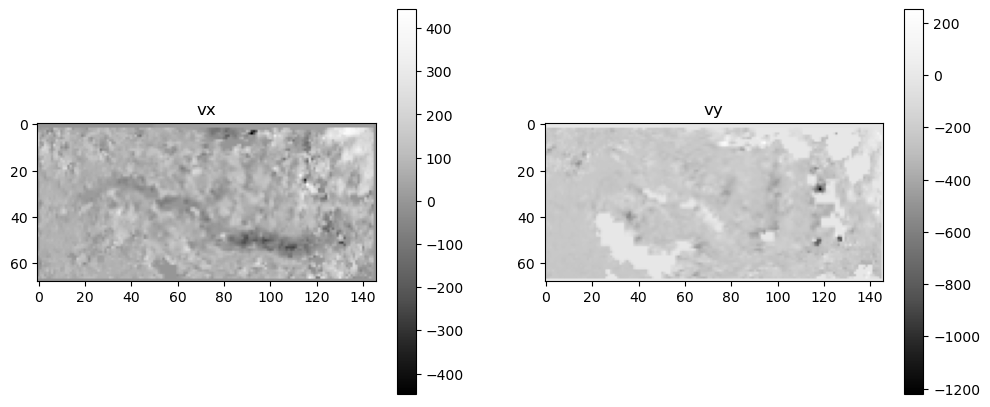

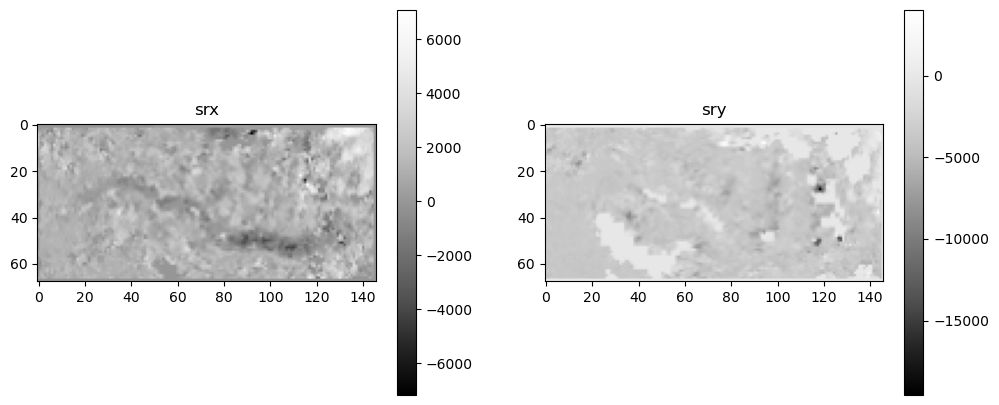

('Nolan_ASTER_20070903_clipped_100m.tif',
 'Nolan_ASTER_20070903_clipped_dhdx_100m.tif',
 'Nolan_ASTER_20070903_clipped_dhdy_100m.tif')

In [112]:
# # # ONE CHIPSIZE:
generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling)

# # MANY CHIPSIZES:
# # for CHIPSIZE_M in [100,150,160,200,300,350,400]:
# for CHIPSIZE_M in [100,200,300]:
#     generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling)
#     print(); print()

# # COULD MAKE AN EQUIVALENT LOOP FOR MAY SEARCH RANGE SCALING FACTORS - FIND OPTIMAL PARAMATERS

## 2) Run geogrid with resampled DEM and other inputs

In [138]:
###### SET PATH PROCESSING PATHS ##########################
out_path = '/Users/jukesliu/Desktop/TEST_out/' # output file path

# # LS test:
# imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/useable_images/'
# im1_name = 'LC08_L1TP_062018_20200401_20200410_01_T1_B8_BufferTurner.TIF'
# im2_name = 'LC08_L1TP_062018_20200417_20200423_01_T1_B8_BufferTurner.TIF'
# img_type = 'OPT'

# S2 test:
# imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel2/'
# im1_name = 'S2A_7VEG_20200427_B08_clipped.tif'
# im2_name = 'S2A_7VEG_20200510_B08_clipped.tif'
# img_type = 'OPT'

# # PS test:
imgpath = '/Volumes/SGlacier/TG_2020/NEW_TRY/'
im1_name = 'PS_20200306.tif'
im2_name = 'PS_20200312.tif'
img_type = 'OPT'

#########################################################

In [139]:
def run_geogrid_inhouse(out_path, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                        dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm): # optional inputs
    import rasterio as rio
    import os
    
    CHIPSIZE_M = MINCHIPSIZE # set minimum chip size equal
    ############ Clear all old geogrid files ##########################
    for file in os.listdir(out_path):
        if file.startswith('window') and file.endswith('.tif'):
            print('removed', file)
            os.remove(out_path+file)
    print('Old files cleared.'); print()

    dem_info = gdal.Info(dem, format='json') # grab info from DEM
    print('Obtained DEM info.'); print()
    ############ Run geogrid optical  ##########################
    print('Processing optical images with geogrid.'); print()
    obj = GeogridOptical() # initialize geogrid object

    ############ Coregister the optical data (from coregisterLoadMetadataOptical) #############
    x1a, y1a, xsize1, ysize1, x2a, y2a, xsize2, ysize2, trans = obj.coregister(indir_m, indir_s, 0)

    # grab dates from file names
    im1_name = indir_m.split('/')[-1]; im2_name = indir_s.split('/')[-1]
    if 'L' in im1_name and 'L' in im2_name:
        ds1 = im1_name.split('_')[3]
        ds2 = im2_name.split('_')[3]
    elif 'S2' in im1_name and 'S2' in im2_name:
        ds1 = im1_name.split('_')[2]
        ds2 = im2_name.split('_')[2]
    elif 'PS' in im1_name and 'PS' in im2_name:
        ds1 = im1_name.split('_')[1]
        ds2 = im2_name.split('_')[1]
    else:
        raise Exception('Optical data NOT supported yet!') 
    print('Optical images coregistered.'); print()

    ########### Load geogrid inputs and run (from runGeogridOptical) ################

    # grab info from above
    obj.startingX = trans[0]; obj.startingY = trans[3]
    obj.XSize = trans[1]; obj.YSize = trans[5]
    d0 = datetime.date(int(ds1[0:4]),int(ds1[4:6]),int(ds1[6:8]))
    d1 = datetime.date(int(ds2[0:4]),int(ds2[4:6]),int(ds2[6:8]))
    date_dt_base = d1 - d0
    obj.repeatTime = date_dt_base.total_seconds()
    obj.numberOfLines = ysize1; obj.numberOfSamples = xsize1
    obj.gridSpacingX = dem_info['geoTransform'][1] # output grid spacing is the same as the DEM

    # customize no data value and minimimum chip size
    obj.nodata_out = NO_DATA_VAL
    obj.chipSizeX0 = MINCHIPSIZE

    # set raster paths and names
    obj.dat1name = indir_m # first image
    obj.demname = dem # DEM
    obj.dhdxname = dhdx; obj.dhdyname = dhdy # surface slope
    obj.vxname = vx; obj.vyname = vy # reference velocity
    obj.srxname = srx; obj.sryname = sry # search range limits
    obj.csminxname = csminx; obj.csminyname = csminy # min chip size
    obj.csmaxxname = csmaxx; obj.csmaxyname = csmaxy # max chip size
    obj.ssmname = ssm # stable surface mask
    obj.winlocname = "window_location.tif"
    obj.winoffname = "window_offset.tif"
    obj.winsrname = "window_search_range.tif"
    obj.wincsminname = "window_chip_size_min.tif"
    obj.wincsmaxname = "window_chip_size_max.tif"
    obj.winssmname = "window_stable_surface_mask.tif"
    obj.winro2vxname = "window_rdr_off2vel_x_vec.tif"
    obj.winro2vyname = "window_rdr_off2vel_y_vec.tif"

    obj.runGeogrid() # RUN GEOGRID
    print('Optical geogrid finished.'); print()

    ############ Move files produced to the out_path directory ##############
    for file in os.listdir(os.getcwd()):
        if file.startswith('window') and file.endswith('.tif'):
            shutil.move(os.getcwd()+'/'+file, out_path+file)
    print('Geogrid output files moved')

### Set custom Geogrid parameters

     input "dhdxname"/"dhdyname"                          -> output "winro2vxname"/"winro2vyname"
     input "dhdxname"/"dhdyname" and "vxname"/"vyname"    -> output "winro2vxname"/"winro2vyname" and "winoffname" 
     input "dhdxname"/"dhdyname" and "srxname"/"sryname"  -> output "winro2vxname"/"winro2vyname" and "winsrname"
     input "csminxname"/"csminyname"                      -> output "wincsminname"
     input "csmaxxname"/"csmaxyname"                      -> output "wincsmaxname"
     input "ssmname"                                      -> output "winssmname"

#### Best  MINCHIPSIZE >= SCALAR*PIXRES where SCALAR = 16 or some other power of 2

    LS = 200
    S2 = 160
    PS = 100

In [ ]:
# ###### SET CUSTOM PARAMETERS FOR GEOGRID ################
# dem = dempath+dem_outfile # path to the resampled DEM produced in the previous step (outfile name)
# indir_m = imgpath+im1_name
# indir_s = imgpath+im2_name
# out_path = '/Volumes/SGlacier/TEST_out/'
# MINCHIPSIZE = 100 # smallest chip size allowed in image horizontal direction (in m)
# NO_DATA_VAL = -32767 # no data value in the output products
# temp_dir = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/coreg_files/'

# if MINCHIPSIZE > CHIPSIZE_M:
#     warning = 'Your minimum chip size for autoRIFT exceeds the output grid size (CHIPSIZE_M). '
#     warning += 'Please increase the resampled DEM gridsize (CHIPSIZE_M).'
#     print(warning)

# # optional inputs (set as '' to leave blank)
# dhdx = dempath+dhdx_outfile
# dhdy = dempath+dhdy_outfile
# # vx = refvpath+vx_outfile
# # vy = refvpath+vy_outfile
# # srx = refvpath+srx_outfile
# # sry = refvpath+sry_outfile
# # csminx = refvpath+csminx_fname
# # csminy = refvpath+csminy_fname
# # csmaxx = refvpath+csmaxx_fname
# # csmaxy = refvpath+csmaxy_fname
# # ssm = refvpath+ssm_outfile # stable surface mask 

# # dhdx = ''
# # dhdy = ''
# vx = ''
# vy = ''
# srx = ''
# sry = ''
# csminx = ''
# csminy = ''
# csmaxx = ''
# csmaxy = ''
# ssm = ''
# #########################################################

In [ ]:
# run_geogrid_inhouse(out_path, img_type, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
#                     dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm, # optional inputs
#                     temp_dir)

## 3) Run autoRIFT with new parameters

In [70]:
# identify files produced from geogrid
gp = out_path

# remove all empty grids
for grid in os.listdir(gp): 
    if grid.startswith('window') and grid.endswith('.tif'):
        reader = rio.open(gp+grid) # read dataset
        data_found = False 
        for band in range(1,reader.count+1):
            testband = reader.read(band) # read in the band
            if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                data_found = True
        if not data_found:
            print(grid, 'has no data. Removed.')
            os.remove(gp+grid)
        else:
            print(grid)

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/SGlacier/VG/autorift_output_VG/'

In [71]:
# fill in AutoRIFT parameters using the files - make all of these function arguments
mpflag = 0 # leave multiprocessing off

# GRID LOCATION (required) from window_location.tif
grid_location = rio.open(gp+'window_location.tif')
xGrid = grid_location.read(1) # 1st band in window location
yGrid = grid_location.read(2) # 2nd band in window location

# optional parameters (default None or zero until filled)
init_offset = None; search_range = None
chip_size_min = None; chip_size_max = None
offset2vx = None; offset2vy = None; stable_surface_mask = None
Dx0 = None; Dy0 = None; CSMINx0 = None
SRx0 = None; SRy0 = None;
CSMAXx0 = None; CSMAXy0 = None; SSM = None
noDataMask = np.zeros(xGrid.shape).astype(int)

if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
    init_offset = rio.open(gp+'window_offset.tif')
    Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
    search_range = rio.open(gp+'window_search_range.tif')
    SRx0 = search_range.read(1); SRy0 = search_range.read(2)
if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
    chip_size_min = rio.open(gp+'window_chip_size_min.tif')
    CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
    chip_size_max = rio.open(gp+'window_chip_size_max.tif')
    CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
    offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
    offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
    stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
    noDataMask = stable_surface_mask.read(1)
    
# other parameters
nodata = NO_DATA_VAL # use same as in previous steps
geogrid_run_info=None
print('AutoRIFT parameters loaded.')

RasterioIOError: /Volumes/SGlacier/VG/autorift_output_VG/window_location.tif: No such file or directory

In [ ]:
######################### CHOOSE FILTERS & SAMPLING ########################
# Filters:
# options are HPS (high pass), WAL (wallis), SOB (sobel), DB (logarithmic operator)
FILTER = 'WAL'
WALLISFILTERWIDTH = 32 # only for wallis filter, must be a power of 2

# Sampling:
SPARSE_SEARCH_SAMPLE_RATE = 16 # how many samples to skip to speed up processing
OVERSAMPLE_RATIO = 0 # enter in a constant scalar or 0 for default parameters
############################################################################
print('Filters and autoRIFT sample rates chosen.')

In [140]:
# AutoRIFT  
def run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATIO, OVERSAMPLE_RATIO, MINCHIPSIZE,
                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                         noDataMask, nodataval, geogrid_run_info):
    CHIPSIZE_M = MINCHIPSIZE # set minimum chip size equal
    
    # requires grid location from geogrid
    origSize = xGrid.shape # grab original size from xGrid
    
    print('Processing optical images with autoRIFT.'); print()
    optflag = 1 # turn on optical flag
    # Coregister and read in the two images (from loadProductOptical())
    obj = GeogridOptical()
    x1a, y1a, xsize1, ysize1, x2a, y2a, xsize2, ysize2, trans = obj.coregister(indir_m, indir_s, 0)

    # read dates from filenames
    indir_m = indir_m.split('/')[-1]; indir_s = indir_s.split('/')[-1]
    if 'L' in indir_m and 'L' in indir_s:
        ds1 = indir_m.split('_')[3]; ds2 = indir_s.split('_')[3]
        sat = 'LS'
    elif 'S2' in indir_m and 'S2' in indir_s:
        ds1 = indir_m.split('_')[2]; ds2 = indir_s.split('_')[2]
        sat = 'S2'
    elif 'PS' in indir_m and 'PS' in indir_s:
        ds1 = indir_m.split('_')[1]
        ds2 = indir_s.split('_')[1]
        sat = 'PS'
    else:
        raise Exception('Data type NOT supported yet!')
        
            
    print('DATES: ')
    print(ds1, ds2); print(sat)

    # read in the images
    DS1 = gdal.Open(indir_m); DS2 = gdal.Open(indir_s)
    I1 = DS1.ReadAsArray(xoff=x1a, yoff=y1a, xsize=xsize1, ysize=ysize1)
    I1 = I1.astype(np.float32)
    I2 = DS2.ReadAsArray(xoff=x2a, yoff=y2a, xsize=xsize2, ysize=ysize2)
    I2 = I2.astype(np.float32)
    DS1=None; DS2=None # clear DS1 and DS2

#     # Initialize autoRIFT object (from runAutorift())
#     obj = autoRIFT()
# #         obj.configure()

        
    ############# Initialize autoRIFT object (from runAutorift()) ##################
    obj = autoRIFT()
#     obj.configure()
    
    obj.MultiThread = mpflag # multiprocessing
    obj.I1 = I1; obj.I2 = I2 # assign the images
    obj.xGrid = xGrid; obj.yGrid = yGrid # assign the grid 

    # GENERATE NO DATA MASK
    # where offset searching will be skipped based on 
    # 1) imported nodata mask and/or 2) zero values in the image
    for ii in range(obj.xGrid.shape[0]):
        for jj in range(obj.xGrid.shape[1]):
            if (obj.yGrid[ii,jj] != nodata)&(obj.xGrid[ii,jj] != nodata):
                if (I1[obj.yGrid[ii,jj]-1,obj.xGrid[ii,jj]-1]==0)|(I2[obj.yGrid[ii,jj]-1,obj.xGrid[ii,jj]-1]==0):
                    noDataMask[ii,jj] = True
                    
    # SEARCH RANGE
    if SRx0 is None:
        # default is a zero array
#        ###########     uncomment to customize SearchLimit based on velocity distribution 
        if Dx0 is not None:
            obj.SearchLimitX = np.int32(4+(25-4)/(np.max(np.abs(Dx0[np.logical_not(noDataMask)]))-np.min(np.abs(Dx0[np.logical_not(noDataMask)])))*(np.abs(Dx0)-np.min(np.abs(Dx0[np.logical_not(noDataMask)]))))
        else:
            obj.SearchLimitX = 15
        obj.SearchLimitY = 15
#        ###########
        obj.SearchLimitX = obj.SearchLimitX * np.logical_not(noDataMask)
        obj.SearchLimitY = obj.SearchLimitY * np.logical_not(noDataMask)
    else:
        obj.SearchLimitX = SRx0
        obj.SearchLimitY = SRy0
       ############ add buffer to search range
        obj.SearchLimitX[obj.SearchLimitX!=0] = obj.SearchLimitX[obj.SearchLimitX!=0] + 2
        obj.SearchLimitY[obj.SearchLimitY!=0] = obj.SearchLimitY[obj.SearchLimitY!=0] + 2
    
    # CHIP SIZE
    if CSMINx0 is not None:
        obj.ChipSizeMaxX = CSMAXx0
        obj.ChipSizeMinX = CSMINx0
        
        gridspacingx = MINCHIPSIZE # use the grid spacing from above
        chipsizex0 = MINCHIPSIZE
        pixsizex = trans[1] # grab from coregister function
    
        obj.ChipSize0X = int(np.ceil(chipsizex0/pixsizex/4)*4)
        obj.GridSpacingX = int(obj.ChipSize0X*gridspacingx/chipsizex0)

        RATIO_Y2X = CSMINy0/CSMINx0
        obj.ScaleChipSizeY = np.median(RATIO_Y2X[(CSMINx0!=nodata)&(CSMINy0!=nodata)])
#         obj.ScaleChipSizeY = 1 # USE SCALE OF 1 for square pixels
    else:
        if ((optflag == 1)&(xGrid is not None)):
            obj.ChipSizeMaxX = 32 # pixels
            obj.ChipSizeMinX = 16 # pixels
            obj.ChipSize0X = 16 # pixels
    
    # DOWNSTREAM SEARCH OFFSET
    if Dx0 is not None:
        obj.Dx0 = Dx0
        obj.Dy0 = Dy0
    else:
        obj.Dx0 = obj.Dx0 * np.logical_not(noDataMask)
        obj.Dy0 = obj.Dy0 * np.logical_not(noDataMask)

    # REPLACE NO DATA VALUES WITH 0
    obj.xGrid[noDataMask] = 0
    obj.yGrid[noDataMask] = 0
    obj.Dx0[noDataMask] = 0
    obj.Dy0[noDataMask] = 0
    if SRx0 is not None:
        obj.SearchLimitX[noDataMask] = 0
        obj.SearchLimitY[noDataMask] = 0
    if CSMINx0 is not None:
        obj.ChipSizeMaxX[noDataMask] = 0
        obj.ChipSizeMinX[noDataMask] = 0
    
    # convert azimuth offset to vertical offset as used in autoRIFT convention for SAR images
    if optflag == 0:
        obj.Dy0 = -1 * obj.Dy0
        
    ############## AutoRIFT Pre-processing (from runAutorift()) ############################
    t1 = time.time()
    print("Pre-process Start!!!")
    
    # FILTERING:
    if FILTER == 'WAL': 
        obj.preprocess_filt_wal() # WALLIS FILTER
#         obj.zeroMask = 1 # removes edges
        obj.WallisFilterWidth = WALLISFILTERWIDTH # optional, default supposedly 21
    elif FILTER == 'HPS':
        obj.preprocess_filt_hps() # HIGH PASS FILTER
    elif FILTER == 'SOB':
        obj.preprocess_filt_sob() # SOBEL FILTER
    elif FILTER == 'LAP':
        obj.preprocess_filt_lap()
    elif FILTER == 'DB':
        obj.preprocess_db() # LOGARITHMIC OPERATOR (NO FILTER), FOR TOPOGRAPHY
    else:
        print(FILTER, 'not recognized. Using default high pass filter instead.')
        obj.preprocess_filt_hps() # HIGH PASS FILTER
        
    print("Pre-process Done!!!")
    print(time.time()-t1)
    
    # CONVERT TO UNIFORM DATA TYPE
    t1 = time.time()
#    obj.DataType = 0
    obj.uniform_data_type()
    print("Uniform Data Type Done!!!")
    print(time.time()-t1)
    
    # OTHER :
    obj.sparseSearchSampleRate = 1
#    obj.colfiltChunkSize = 4

    obj.OverSampleRatio = 64
    if CSMINx0 is not None:
        obj.OverSampleRatio = {obj.ChipSize0X:16,obj.ChipSize0X*2:32,obj.ChipSize0X*4:64,obj.ChipSize0X*8:64}
    
    # SEE ORIGINAL CODE TO EXPORT PREPROCESSED IMAGES
    
    ####################### Run AutoRIFT (from runAutorift())  ############################
    t1 = time.time()
    print("AutoRIFT Start!!!")
    obj.runAutorift()
    print("AutoRIFT Done!!!")
    print(time.time()-t1)
    
    kernel = np.ones((3,3),np.uint8)
    noDataMask = cv2.dilate(noDataMask.astype(np.uint8),kernel,iterations = 1)
    noDataMask = noDataMask.astype(np.bool)

    # AT THIS POINT, THESE VARIABLES WILL BE CREATED:
    # obj.Dx, obj.Dy, obj.InterpMask, obj.ChipSizeX, obj.GridSpacingX, 
    # obj.ScaleChipSizeY, obj.SearchLimitX, obj.SearchLimitY, obj.origSize, noDataMask
    
    # PLOT RESULTS
    fig, (ax1, ax2, ax3) = plt.subplots(1,3,figsize=(15,5))
    im1 = ax1.imshow(obj.Dx); ax1.set_title('Dx'); fig.colorbar(im1, ax=ax1)
    im2 = ax2.imshow(obj.Dy); ax2.set_title('Dy'); fig.colorbar(im2, ax=ax2)
    im3 = ax3.imshow(np.sqrt((obj.Dx**2) + (obj.Dy**2))); ax3.set_title('D_total'); fig.colorbar(im3,ax=ax3)
    plt.suptitle(ds1+' to '+ds2)
    plt.show()

    ####################### Write outputs (from runAutorift())  ############################
    t1 = time.time()
    print("Write Outputs Start!!!")
          
    # Write text file with parameters
    f =  open(out_path+'parameters_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.txt', 'w')
    f.write('Geogrid/AutoRIFT parameters for offset_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.tif:')
    f.write('NO_DATA_VAL: '+str(NO_DATA_VAL))
    f.write('Min chip size: '+str(MINCHIPSIZE))
    f.write('DEM: '+dem)
    f.write('dhdx: '+dhdx); f.write('dhdy: '+dhdy)
    f.write('vx: '+vx); f.write('vy: '+vy)
    f.write('srx: '+srx); f.write('sry: '+sry)
    f.write('csminx: '+csminx); f.write('csminy: '+csminy)
    f.write('csmaxx: '+csmaxx); f.write('csmaxy: '+csmaxy)
    f.write('stable surface mask: '+ssm)
    f.write('FILTER: '+FILTER)
    f.write('WALLISFILTERWIDTH: '+str(WALLISFILTERWIDTH))
    f.write('Spare search sample rate: '+str(SPARSE_SEARCH_SAMPLE_RATE))
    f.write('Oversample ratio: '+str(OVERSAMPLE_RATIO))
    if offset2vx is not None and offset2vy is not None:
        f.write('Velocity.TIF file created.')
    else:
        f.write('Velocity.TIF not created.')
    f.close() # close the parameter text file
          
    # open the window_location.tif file to gdalinfo
    ds = gdal.Open(gp+'window_location.tif')
    tran = ds.GetGeoTransform()
    proj = ds.GetProjection()
    srs = ds.GetSpatialRef()
    
    # initialize arrays
    DX = np.zeros(origSize,dtype=np.float32) * np.nan; DY = np.zeros(origSize,dtype=np.float32) * np.nan
    INTERPMASK = np.zeros(origSize,dtype=np.float32); CHIPSIZEX = np.zeros(origSize,dtype=np.float32)
    SEARCHLIMITX = np.zeros(origSize,dtype=np.float32); SEARCHLIMITY = np.zeros(origSize,dtype=np.float32)
    
    # fill in arays
    Dx = obj.Dx; Dy = obj.Dy; InterpMask = obj.InterpMask; ChipSizeX = obj.ChipSizeX
    SearchLimitX = obj.SearchLimitX; SearchLimitY = obj.SearchLimitY
    DX[0:Dx.shape[0],0:Dx.shape[1]] = Dx;  DY[0:Dy.shape[0],0:Dy.shape[1]] = Dy
    INTERPMASK[0:InterpMask.shape[0],0:InterpMask.shape[1]] = InterpMask
    CHIPSIZEX[0:ChipSizeX.shape[0],0:ChipSizeX.shape[1]] = ChipSizeX
    SEARCHLIMITX[0:SearchLimitX.shape[0],0:SearchLimitX.shape[1]] = SearchLimitX
    SEARCHLIMITY[0:SearchLimitY.shape[0],0:SearchLimitY.shape[1]] = SearchLimitY
    
    # mask out no data
    DX[noDataMask] = np.nan; DY[noDataMask] = np.nan
    INTERPMASK[noDataMask] = 0; CHIPSIZEX[noDataMask] = 0
    SEARCHLIMITX[noDataMask] = 0; SEARCHLIMITY[noDataMask] = 0
    if SSM is not None:
        SSM[noDataMask] = False
    DX[SEARCHLIMITX == 0] = np.nan; DY[SEARCHLIMITX == 0] = np.nan
    INTERPMASK[SEARCHLIMITX == 0] = 0; CHIPSIZEX[SEARCHLIMITX == 0] = 0
    if SSM is not None:
        SSM[SEARCHLIMITX == 0] = False

    # SAVE TO OFFSET.MAT FILE
    sio.savemat('offset_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.mat', # offset mat filename
                {'Dx':DX,'Dy':DY,'InterpMask':INTERPMASK,'ChipSizeX':CHIPSIZEX})
    print('Offset.mat written.')
    
    # CREATE THE GEOTIFFS
    driver = gdal.GetDriverByName('GTiff')
    
    # OFFSET.TIF
    outRaster = driver.Create("offset_"+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+".tif", # offset filename
                              int(xGrid.shape[1]), int(xGrid.shape[0]), 5, gdal.GDT_Float32)
    outRaster.SetGeoTransform(tran); outRaster.SetProjection(proj) # projections
    outband = outRaster.GetRasterBand(1); outband.WriteArray(DX) # DX
    outband.FlushCache()
    outband = outRaster.GetRasterBand(2); outband.WriteArray(DY) # DY
    outband.FlushCache()
    outband = outRaster.GetRasterBand(3); outband.WriteArray(np.sqrt((DX**2) + (DY**2))) # DY
    outband.FlushCache()
    outband = outRaster.GetRasterBand(4); outband.WriteArray(INTERPMASK) # INTERPMASK
    outband.FlushCache()
    outband = outRaster.GetRasterBand(5); outband.WriteArray(CHIPSIZEX) # CHIPSIZE
    outband.FlushCache()
    del outRaster
    print('Offset.tif written.')
    
    # VELOCITY.TIF
    if offset2vx is not None and offset2vy is not None:
        ds = gdal.Open(offset2vx) #### VX
        band = ds.GetRasterBand(1); offset2vx_1 = band.ReadAsArray()
        band = ds.GetRasterBand(2); offset2vx_2 = band.ReadAsArray()
        if ds.RasterCount > 2:
                band = ds.GetRasterBand(3)
                offset2vr = band.ReadAsArray()
        else:
                offset2vr = None
        band=None; ds=None
        offset2vx_1[offset2vx_1 == nodata] = np.nan
        offset2vx_2[offset2vx_2 == nodata] = np.nan

        ds = gdal.Open(offset2vy) #### VY
        band = ds.GetRasterBand(1); offset2vy_1 = band.ReadAsArray()
        band = ds.GetRasterBand(2); offset2vy_2 = band.ReadAsArray()
        if ds.RasterCount > 2:
                band = ds.GetRasterBand(3)
                offset2va = band.ReadAsArray()
        else:
                offset2va = None
        band=None; ds=None
        offset2vy_1[offset2vy_1 == nodata] = np.nan; offset2vy_2[offset2vy_2 == nodata] = np.nan
        
        if offset2va is not None:
            offset2va[offset2va == nodata] = np.nan

        VX = offset2vx_1 * DX + offset2vx_2 * DY
        VY = offset2vy_1 * DX + offset2vy_2 * DY
        VX = VX.astype(np.float32); VY = VY.astype(np.float32)

        outRaster = driver.Create("velocity_"+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+".tif", # velocity filename
                                  int(xGrid.shape[1]), int(xGrid.shape[0]), 3, gdal.GDT_Float32)
        outRaster.SetGeoTransform(tran); outRaster.SetProjection(proj)
        outband = outRaster.GetRasterBand(1); outband.WriteArray(VX) # VX
        outband.FlushCache()
        outband = outRaster.GetRasterBand(2); outband.WriteArray(VY) # VY
        outband.FlushCache()
        outband = outRaster.GetRasterBand(3); outband.WriteArray(np.sqrt((VX**2) + (VY**2))) # V
        outband.FlushCache()
        del outRaster
        print('Velocity.tif written.')
    
    print("Write Outputs Done!!!")
    print(time.time()-t1)
    
    # Move files produced to the out_path directory
    for file in os.listdir(os.getcwd()):
        if 'offset' in file or ('velocity' in file and '.tif' in file):
            shutil.move(os.getcwd()+'/'+file, out_path+file)

In [ ]:
# run autoRIFT with function
run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, OVERSAMPLE_RATIO, MINCHIPSIZE,
                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                         noDataMask, nodata, geogrid_run_info)

# 4) Run geogrid and autoRIFT on all images in a folder

## Check that the image files and dates are being read correctly

In [307]:
s2path = '/Volumes/SGlacier/VG/sentinel2_VG/' # input S2 images
LSpath = '/Volumes/SGlacier/VG/Variegated_LS_images/' # input LS images
PSpath = '/Volumes/SGlacier/PS_noncloudy_VG/'

# s2path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel2/' # input S2 images
# LS8path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/useable_images/' # input LS8 images
# PSpath = '/Volumes/SGlacier/PS_March2020/'
# S1path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/'
# PSpath = '/Volumes/SGlacier/surge_projects/Working_clipped_2019/'
# boxpath = '/Users/surging/Documents/TG/BoxTurner/BoxTurner_UTM_07.shp' # the shapefile for Turner
# autoriftpath = '/Users/surging/Documents/TG/autoRIFT/' # path to the autorift scripts
# vmap_path = '/Users/surging/Documents/TG/vmap_test/' # output velocity map folder
# basepath = '/Users/surging/Documents/TG/optical-offset-tracking/' # path where this script is located

######### Set minimum and maximum time separation and the platform (L8, S2, PS, S1) ###############
platform = 'LS'
startdate = '20100701' # inclusive start date
enddate = '20240801' # inclusive end date
min_dt = 5 # minimum time separation between images
max_dt = 60 # maximum time separation between images
###############################################################################################

In [308]:
# assign the folder path based on the platform
if platform == 'S2': # sentinel-2
    path = s2path
    ext = '_clipped.tif' # image filename extension
    img_type = 'OPT'
    date_split_idx = 2 # split filename by underscore, index corresponds to image date
elif platform == 'LS': # landsat 8
    path = LSpath
    ext = '_clipped.TIF'
    img_type = 'OPT'
    date_split_idx = 3
elif platform == 'PS': # PlanetScope
    path = PSpath
    ext = '.tif'  
    img_type = 'OPT'
    date_split_idx = 1
else:
    print('Platform', platform, 'not recognized. Options are "S2", "LS", "PS"')

# record all possible images and their dates
dates = []; files = []  
for file in os.listdir(path):
    if file.endswith(ext):
        date = file.split('_')[date_split_idx] # grab the date from the filename
        dates.append(date); files.append(file) # store the date and filename
files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
files_df

,filename,date
0,LC08_L1TP_062018_20131007_20200913_02_T1_B8_Bu...,20131007
1,LC08_L1TP_062018_20131124_20200912_02_T1_B8_Bu...,20131124
2,LC08_L1TP_062018_20140228_20200911_02_T1_B8_Bu...,20140228
3,LC08_L1TP_062018_20140503_20200911_02_T1_B8_Bu...,20140503
4,LC08_L1TP_062018_20140604_20200911_02_T1_B8_Bu...,20140604
...,...,...
85,LC09_L1TP_062018_20221024_20230324_02_T1_B8_Bu...,20221024
86,LC08_L1TP_061018_20221025_20221107_02_T1_B8_Bu...,20221025
87,LC08_L1TP_062018_20221117_20221128_02_T2_B8_Bu...,20221117
88,LC09_L1TP_061018_20221118_20230321_02_T1_B8_Bu...,20221118


In [309]:
# filter out those before and afte the input start and end date
files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
files_df = files_df.reset_index(drop=True) # reset index for searching
files_df

,filename,date
0,LC08_L1TP_062018_20131007_20200913_02_T1_B8_Bu...,20131007
1,LC08_L1TP_062018_20131124_20200912_02_T1_B8_Bu...,20131124
2,LC08_L1TP_062018_20140228_20200911_02_T1_B8_Bu...,20140228
3,LC08_L1TP_062018_20140503_20200911_02_T1_B8_Bu...,20140503
4,LC08_L1TP_062018_20140604_20200911_02_T1_B8_Bu...,20140604
...,...,...
85,LC09_L1TP_062018_20221024_20230324_02_T1_B8_Bu...,20221024
86,LC08_L1TP_061018_20221025_20221107_02_T1_B8_Bu...,20221025
87,LC08_L1TP_062018_20221117_20221128_02_T2_B8_Bu...,20221117
88,LC09_L1TP_061018_20221118_20230321_02_T1_B8_Bu...,20221118


In [310]:
# # drop duplicate dates for S2, keep the original over the PS imitation
# if platform == 'S2':
#     unique_dates = list(set(files_df.date))
#     for date in unique_dates:
#         date_df = files_df[files_df.date == date]
#         if len(date_df) > 1: # if there's a duplicate
#             for idx, row in date_df.iterrows():
#                 if row.filename.startswith('S2P'):
#                     files_df = files_df.drop(idx)
# files_df

## Set final run parameters and paths

In [315]:
CHIPSIZE_LIST = [100] # chipsizes to run [meters]
PLATFORM_LIST = ['S2','LS','PS'] # LS, S2 or PS or any combination of the two

In [316]:
########## PARAMETERS FOR GEOGRID #################################################### 
# out_path = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/output_AutoRIFT/' # output file path
out_path = '/Volumes/SGlacier/all_autorift_output_VG_sref/' # output file path
dem = dempath+dem_outfile # path to the resampled DEM produced in the previous step (outfile name)
#             MINCHIPSIZE = CHIPSIZE_M # smallest chip size allowed in image horizontal direction (in m)
#             print(MINCHIPSIZE)
NO_DATA_VAL = -32767 # no data value in the output products
temp_dir = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/coreg_files/'

# PARAMETERS FOR AUTORIFT CHOSEN
# options are HPS (high pass), WAL (wallis), SOB (sobel), DB (logarithmic operator)
FILTER = 'HPS'
WALLISFILTERWIDTH = 32 # only for wallis filter, must be a power of 2

# Sampling:
SPARSE_SEARCH_SAMPLE_RATE = 16 # how many samples to skip to speed up processing
OVERSAMPLE_RATIO = 0 # enter in a constant scalar or 0 for default parameters
print('Filters and autoRIFT sample rates chosen.')
############################################################################################

Filters and autoRIFT sample rates chosen.


In [318]:
######### ENTER DEM INFO, AND REFERENCE VELOCITY INFO ########### 
# enter in the path to your best DEM over the region
# # dempath = '/Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/'
# dempath = '/Volumes/SGlacier/VG/autorift_input/'
# demname = 'Nolan_ASTER_20070903_clipped.tif'

# path to the reference files for geogrid (vx, vy, ssm)
# refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file
refvpath = '/Volumes/SGlacier/VG/autorift_input/' 
# refvpath = '/Volumes/SGlacier/TG_autorift_inputs/' 
vx_fname = 'vx_reference_filled_x100.tif' # name of reference vx file
vy_fname = 'vy_reference_filled_x100.tif' # name of reference vy file

sr_scaling = 16 # multiply by vx and vy to generate search range limits
############################################################################

Number of files found: 66
Nolan2021_ASTER_20070903_clipped_5m_100m.tif  already exists.
Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif and Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif already exist.


/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/11044236.py:101: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new code, for regular grids use `RegularGridInterpolator` instead.
For scattered data, prefer `LinearNDInterpolator` or
`CloughTocher2DInterpolator`.

For more details see
`https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  fx = interp2d(vx_x, vx_y, vx0)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/11044236.py:102: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new cod

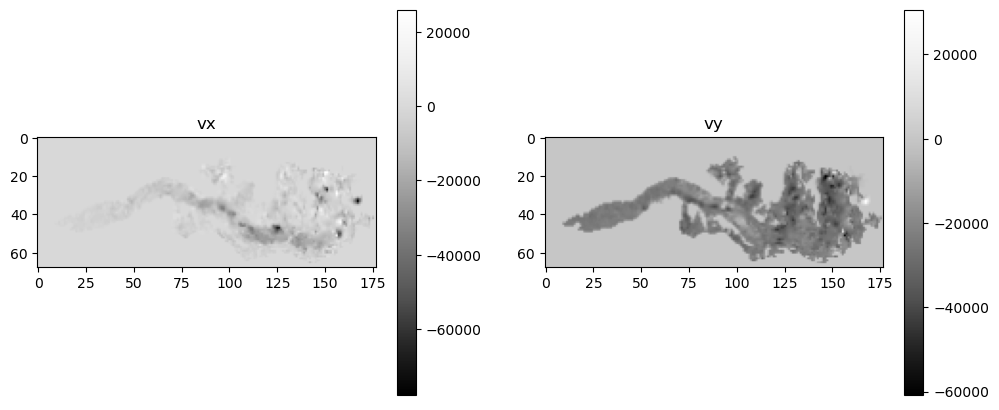

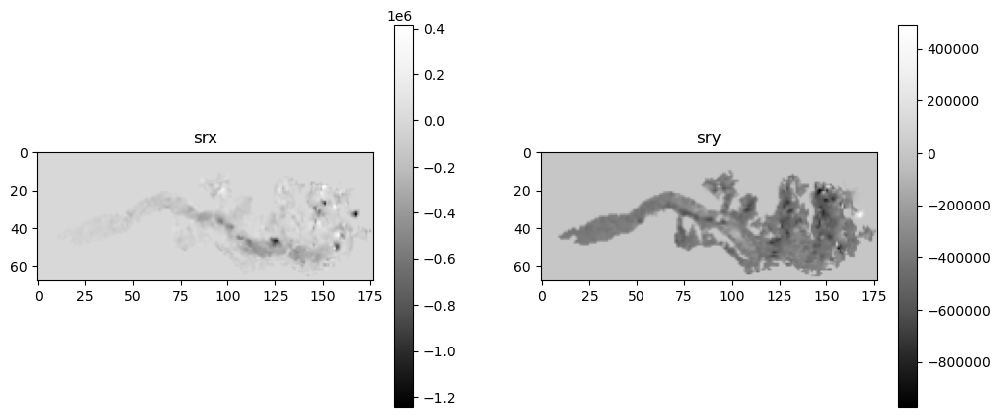

S2A_7VEG_20170423_B08_VG_clipped.tif S2A_7VEG_20170602_B08_VG_clipped.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x vector: window_rdr_off2vel_x_vec.tif
Window rdr_off2vel_y vector: window_rdr_off2vel_y_vec.tif
Output Nodata Value: -32767

Starting pro

/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_30345/450998986.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  noDataMask = noDataMask.astype(np.bool)


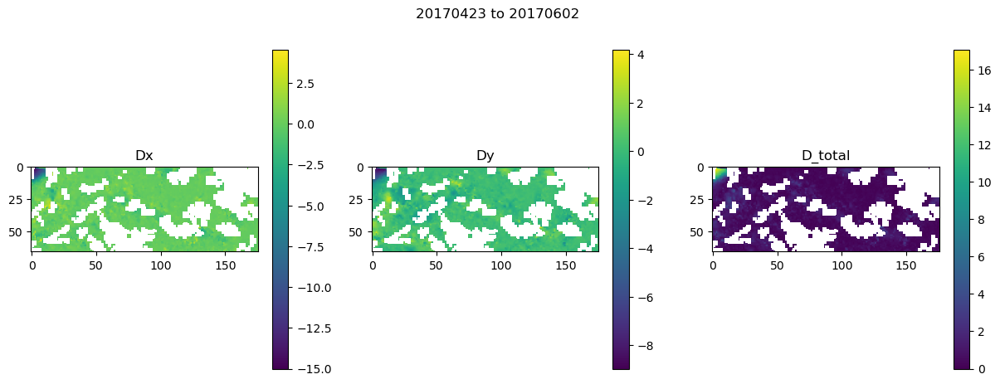

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.026060104370117188
20170602 20171114
20170602 20180123
20170602 20180202
20170602 20180217
20170602 20180324
20170602 20180329
20170602 20180413
20170602 20180508
20170602 20180518
20170602 20180702
20170602 20180722
20170602 20180801
20170602 20180831
20170602 20180910
20170602 20180930
20170602 20190118
20170602 20190202
20170602 20190207
20170602 20190212
20170602 20190222
20170602 20190227
20170602 20190329
20170602 20190413
20170602 20190428
20170602 20190513
20170602 20190607
20170602 20190627
20170602 20190707
20170602 20190722
20170602 20190806
20170602 20190811
20170602 20190821
20170602 20190905
20170602 20190915
20170602 20191020
20170602 20191025
20170602 20191109
20170602 20200202
20170602 20200323
20170602 20200330
20170602 20200402
20170602 20200419
20170602 20200502
20170602 20200512
20170602 20200527
20170602 20200626
20170602 20200701
20170602 20200716
20170602

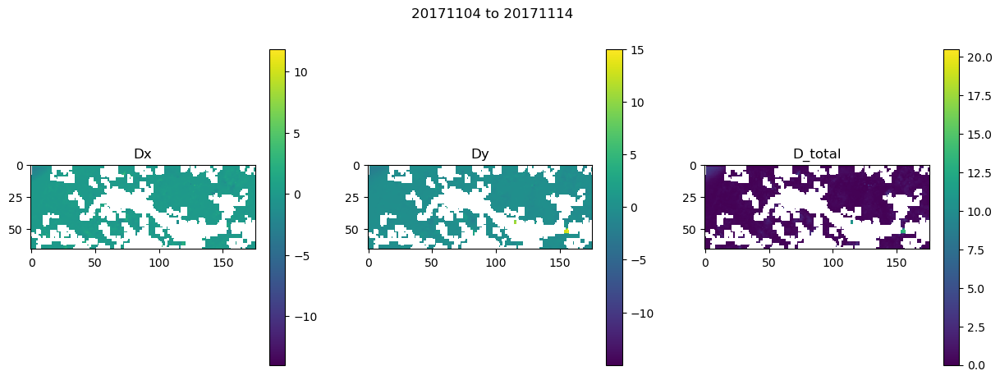

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019068002700805664
20171114 20180202
20171114 20180217
20171114 20180324
20171114 20180329
20171114 20180413
20171114 20180508
20171114 20180518
20171114 20180702
20171114 20180722
20171114 20180801
20171114 20180831
20171114 20180910
20171114 20180930
20171114 20190118
20171114 20190202
20171114 20190207
20171114 20190212
20171114 20190222
20171114 20190227
20171114 20190329
20171114 20190413
20171114 20190428
20171114 20190513
20171114 20190607
20171114 20190627
20171114 20190707
20171114 20190722
20171114 20190806
20171114 20190811
20171114 20190821
20171114 20190905
20171114 20190915
20171114 20191020
20171114 20191025
20171114 20191109
20171114 20200202
20171114 20200323
20171114 20200330
20171114 20200402
20171114 20200419
20171114 20200502
20171114 20200512
20171114 20200527
20171114 20200626
20171114 20200701
20171114 20200716
20171114 20200731
20171114 20200914
20171114

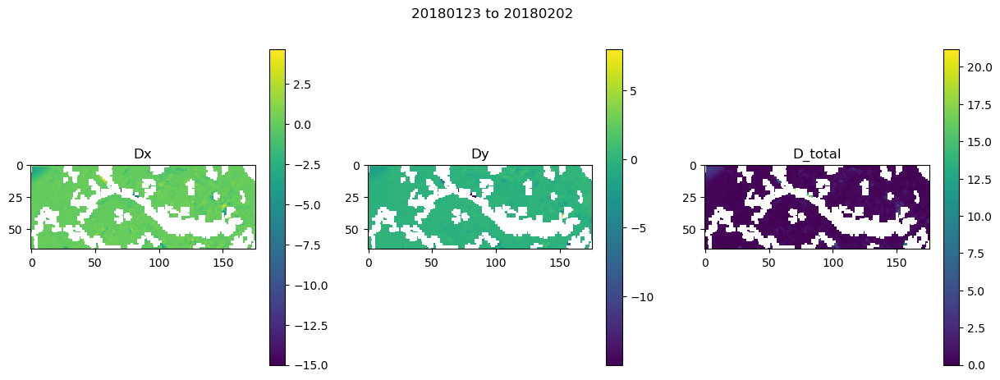

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019611120223999023
S2B_7VEG_20180202_B08_VG_clipped.tif S2A_7VEG_20180217_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

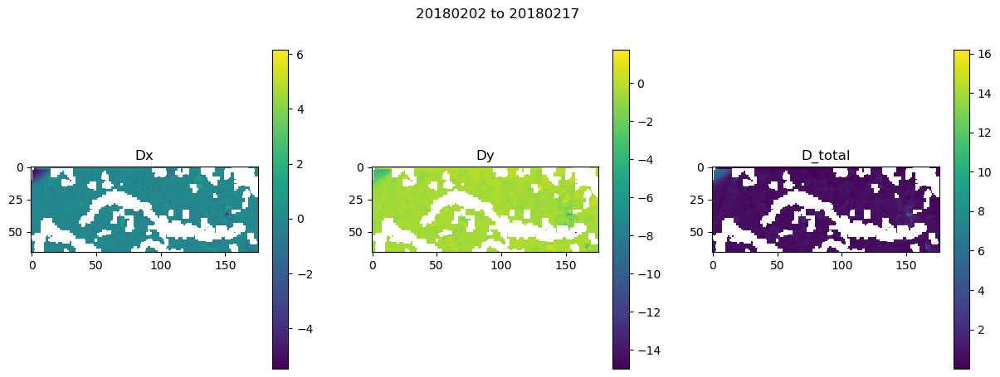

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01889204978942871
S2A_7VEG_20180217_B08_VG_clipped.tif S2B_7VEG_20180324_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3024000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

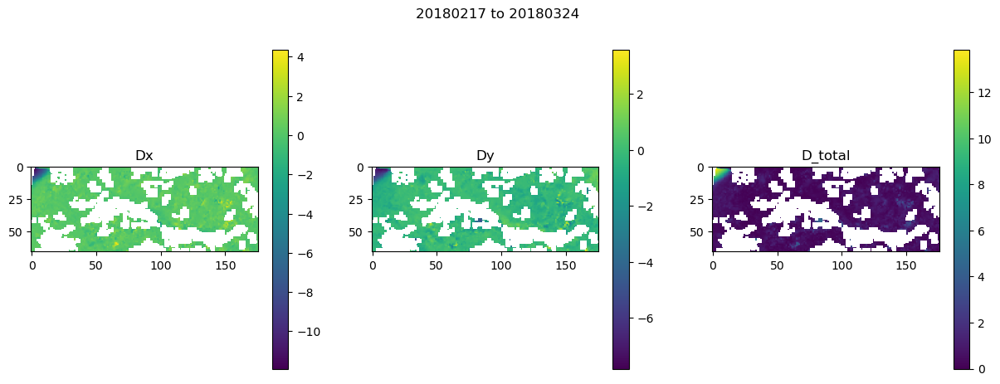

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019467830657958984
S2B_7VEG_20180324_B08_VG_clipped.tif S2A_7VEG_20180329_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

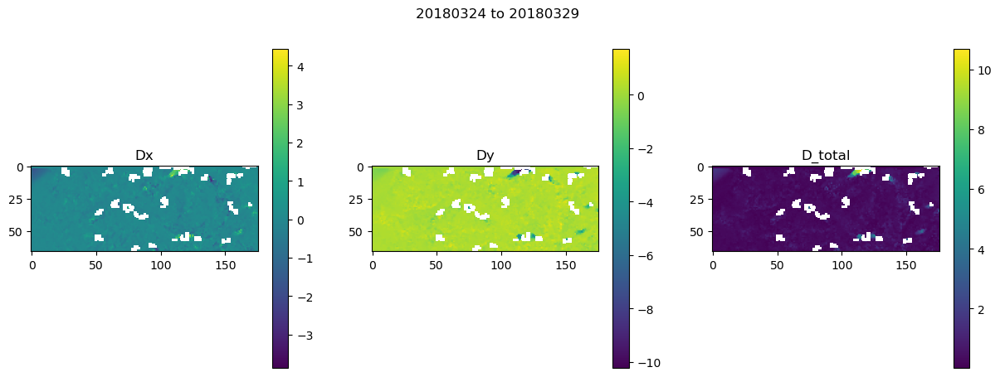

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018786191940307617
S2A_7VEG_20180329_B08_VG_clipped.tif S2B_7VEG_20180413_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

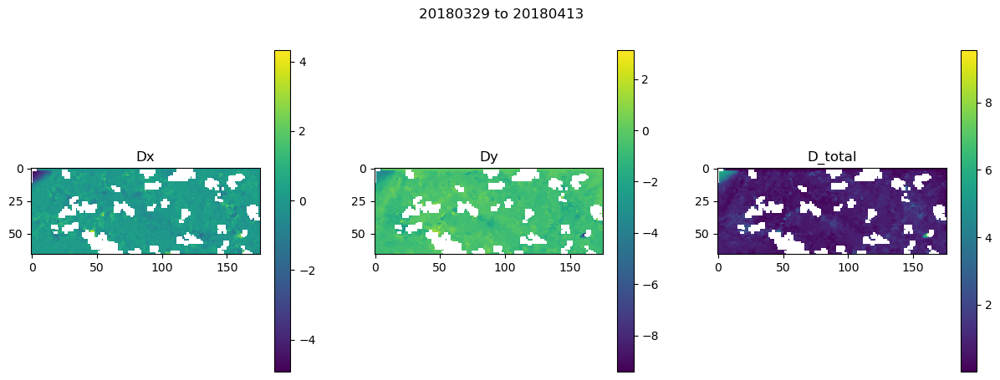

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01841592788696289
S2B_7VEG_20180413_B08_VG_clipped.tif S2A_7VEG_20180508_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

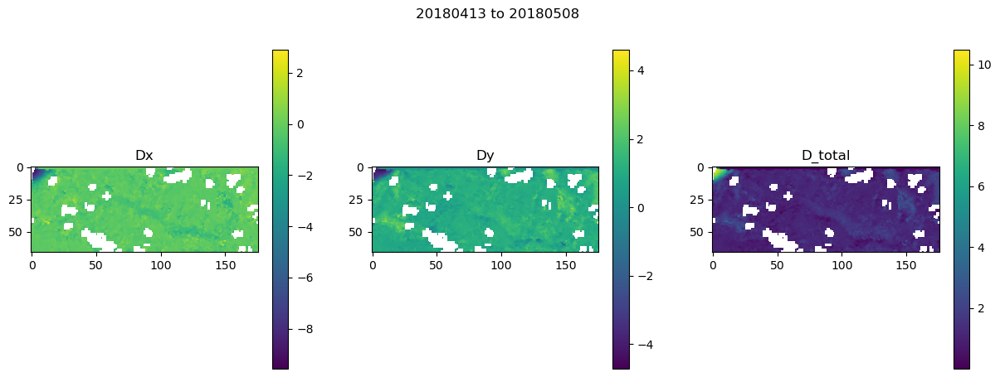

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01866316795349121
S2A_7VEG_20180508_B08_VG_clipped.tif S2A_7VEG_20180518_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

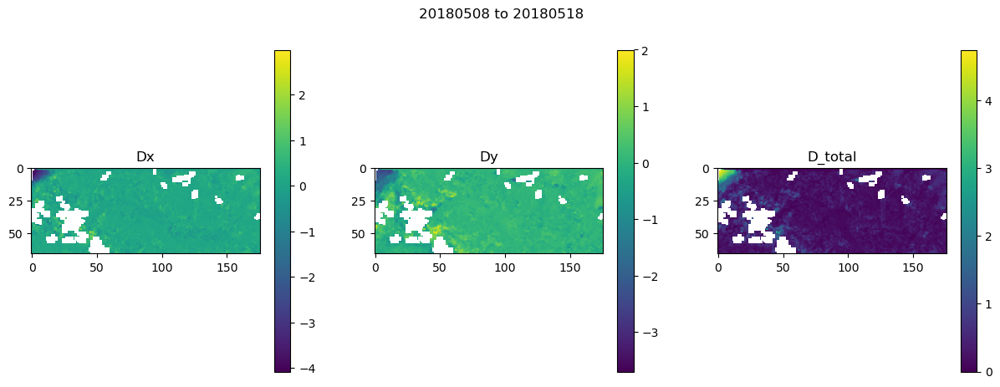

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019073009490966797
S2A_7VEG_20180518_B08_VG_clipped.tif S2B_7VEG_20180702_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3888000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

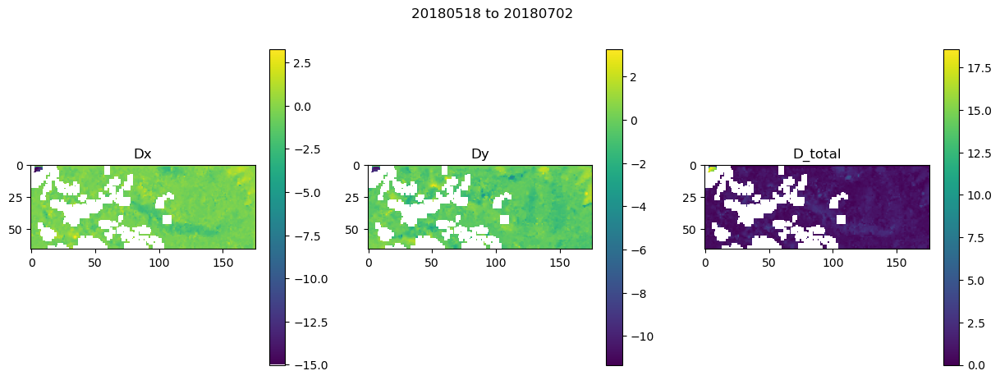

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018898963928222656
S2B_7VEG_20180702_B08_VG_clipped.tif S2B_7VEG_20180722_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

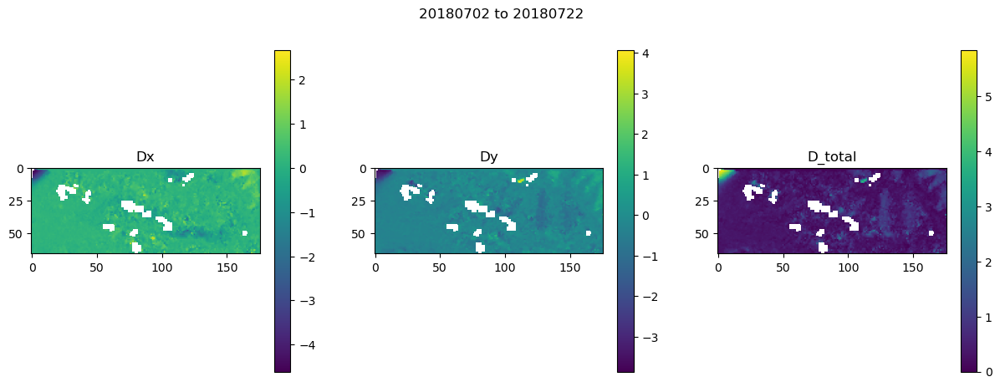

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018726110458374023
S2B_7VEG_20180722_B08_VG_clipped.tif S2B_7VEG_20180801_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

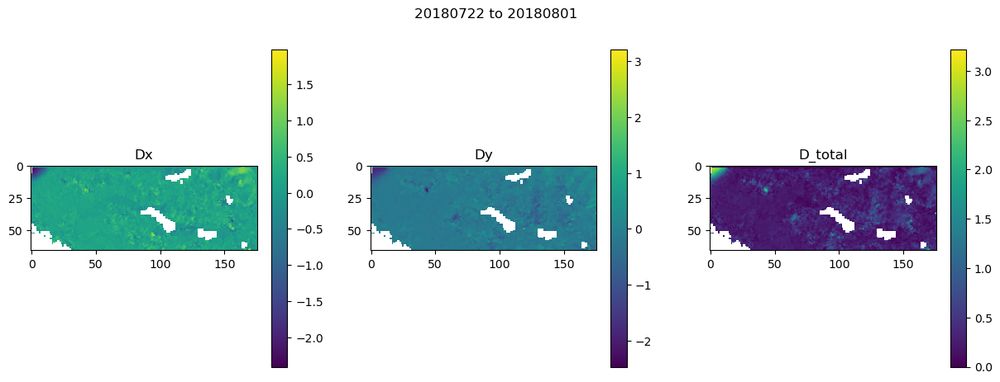

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019006967544555664
S2B_7VEG_20180801_B08_VG_clipped.tif S2B_7VEG_20180831_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2592000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

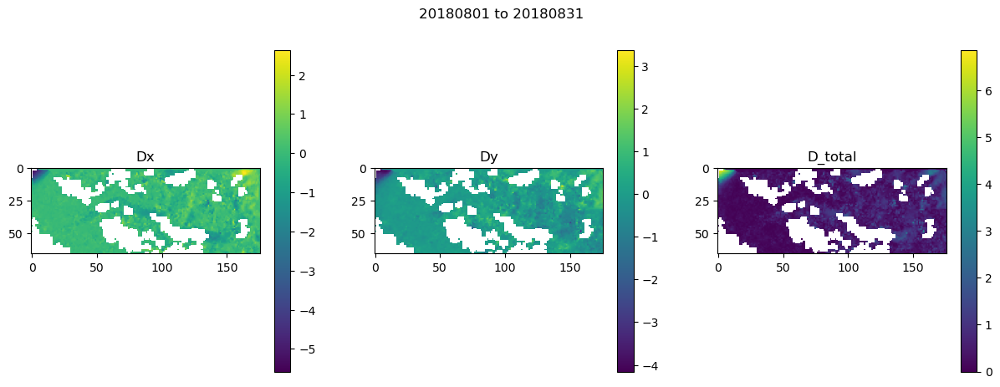

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017384052276611328
S2B_7VEG_20180831_B08_VG_clipped.tif S2B_7VEG_20180910_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

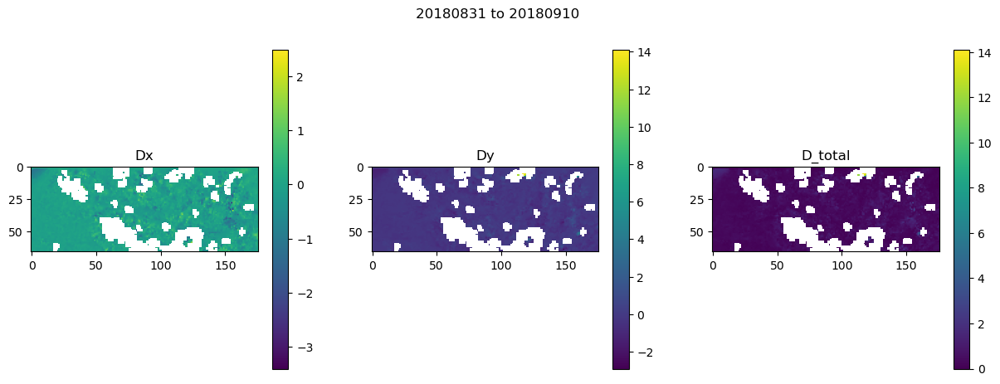

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02063298225402832
S2B_7VEG_20180910_B08_VG_clipped.tif S2B_7VEG_20180930_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

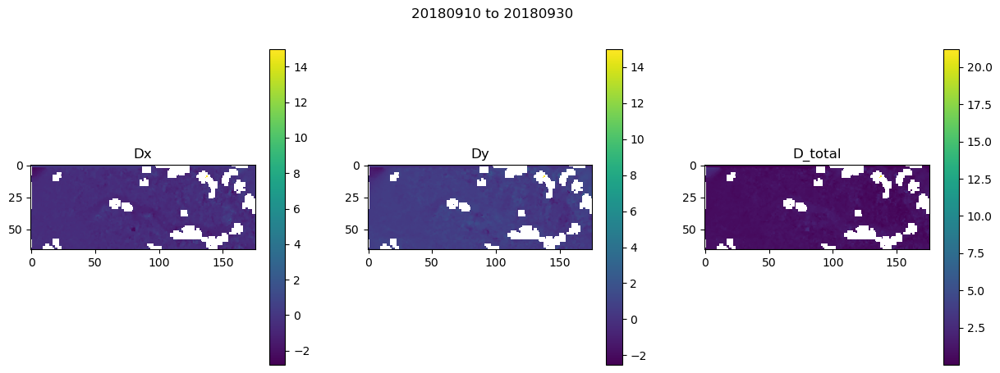

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01825690269470215
20180930 20190202
20180930 20190207
20180930 20190212
20180930 20190222
20180930 20190227
20180930 20190329
20180930 20190413
20180930 20190428
20180930 20190513
20180930 20190607
20180930 20190627
20180930 20190707
20180930 20190722
20180930 20190806
20180930 20190811
20180930 20190821
20180930 20190905
20180930 20190915
20180930 20191020
20180930 20191025
20180930 20191109
20180930 20200202
20180930 20200323
20180930 20200330
20180930 20200402
20180930 20200419
20180930 20200502
20180930 20200512
20180930 20200527
20180930 20200626
20180930 20200701
20180930 20200716
20180930 20200731
20180930 20200914
20180930 20210211
20180930 20210402
20180930 20210422
20180930 20210502
20180930 20210611
20180930 20210701
20180930 20210716
20180930 20210731
20180930 20210815
20180930 20210830
20180930 20210919
20180930 20211004
20180930 20220820
No image pair with correct 

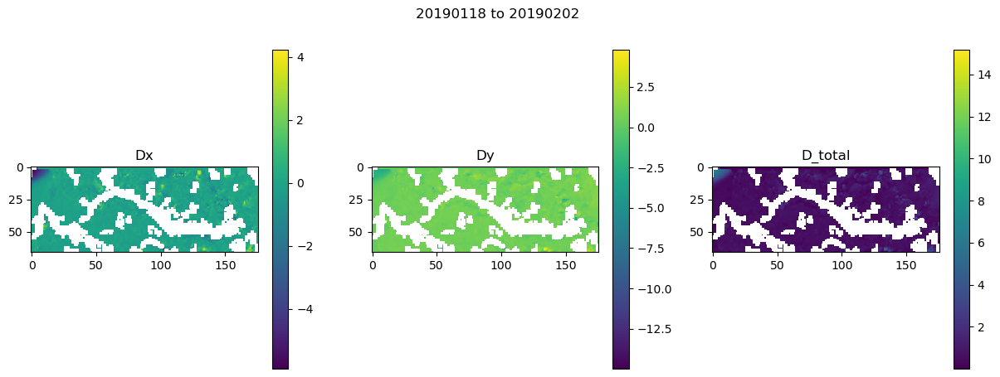

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01892876625061035
S2A_7VEG_20190202_B08_VG_clipped.tif S2B_7VEG_20190207_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

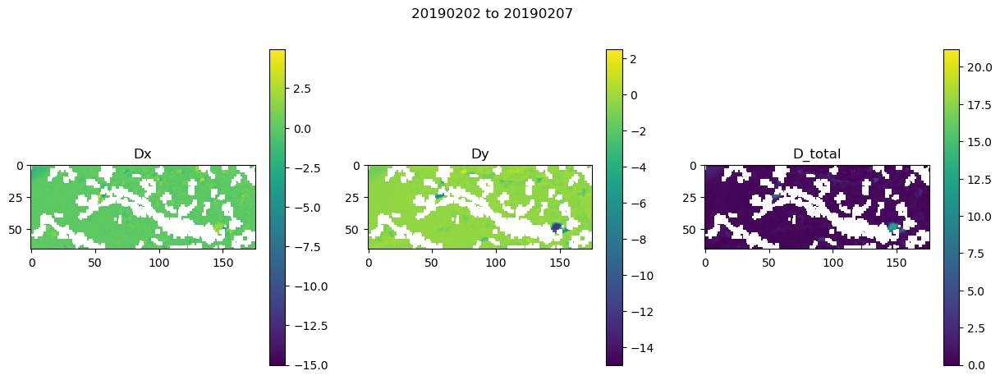

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01951003074645996
S2B_7VEG_20190207_B08_VG_clipped.tif S2A_7VEG_20190212_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

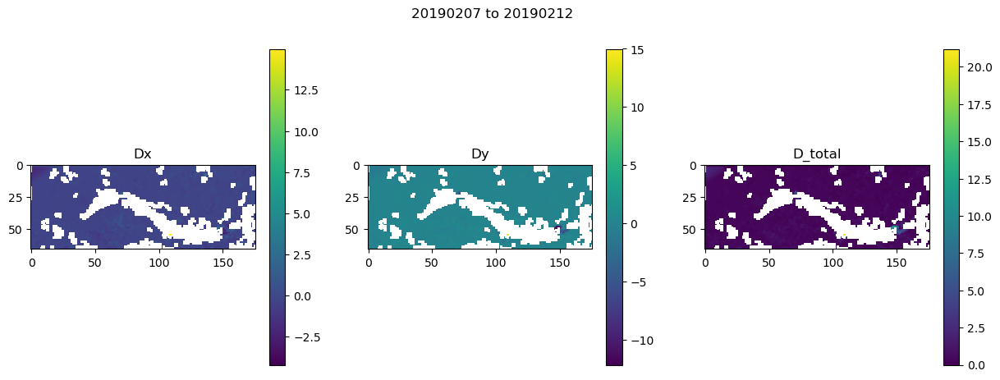

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018225908279418945
S2A_7VEG_20190212_B08_VG_clipped.tif S2A_7VEG_20190222_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

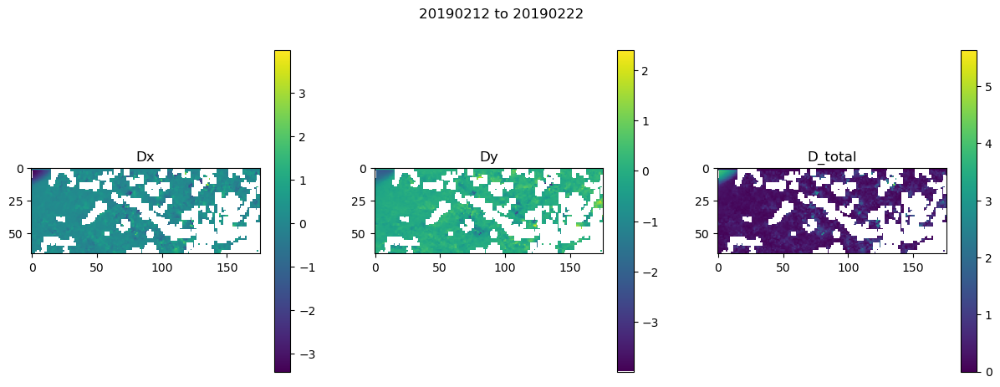

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019311904907226562
S2A_7VEG_20190222_B08_VG_clipped.tif S2B_7VEG_20190227_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

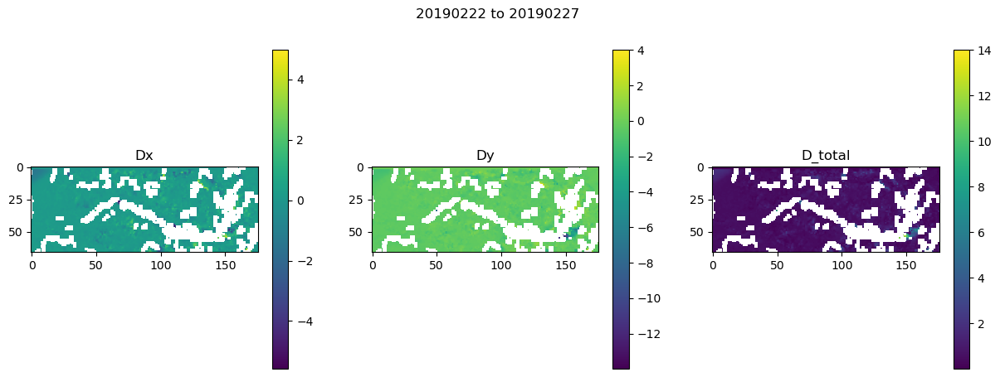

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019022226333618164
S2B_7VEG_20190227_B08_VG_clipped.tif S2B_7VEG_20190329_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2592000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

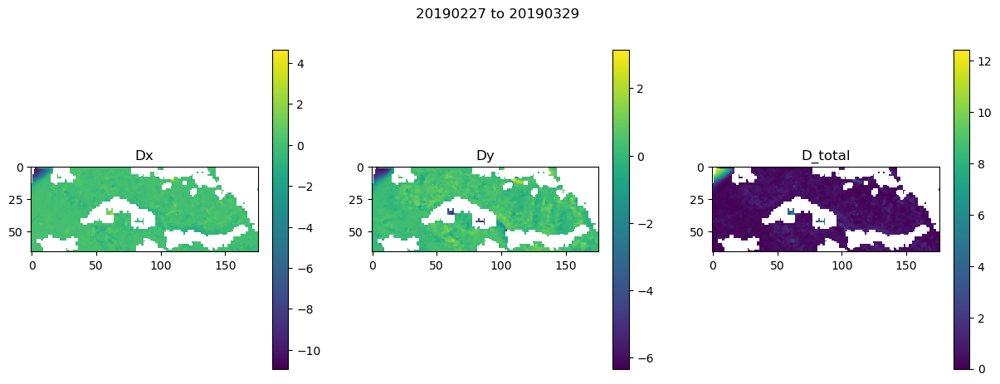

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0199432373046875
S2B_7VEG_20190329_B08_VG_clipped.tif S2A_7VEG_20190413_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

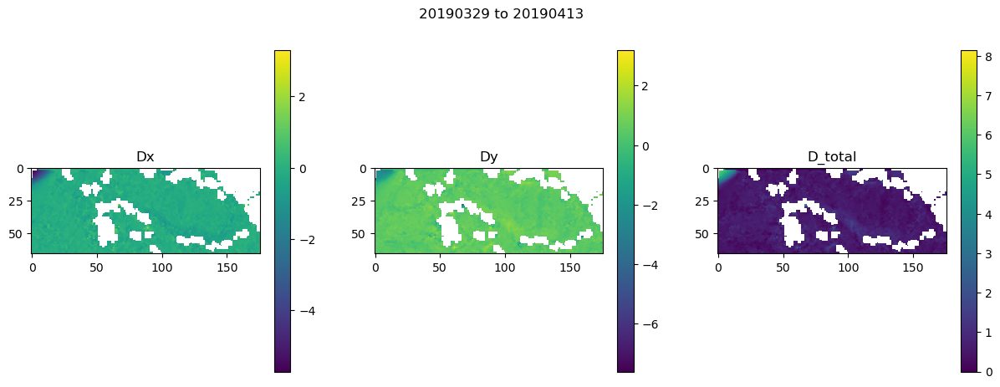

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018465042114257812
S2A_7VEG_20190413_B08_VG_clipped.tif S2B_7VEG_20190428_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

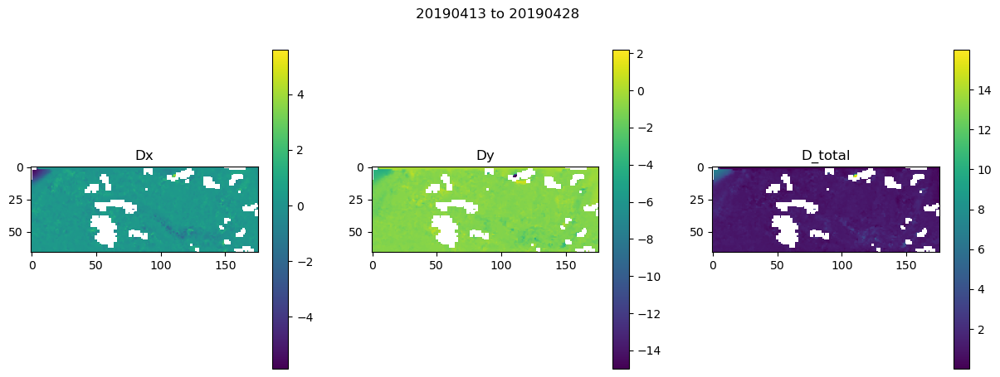

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018895864486694336
S2B_7VEG_20190428_B08_VG_clipped.tif S2A_7VEG_20190513_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

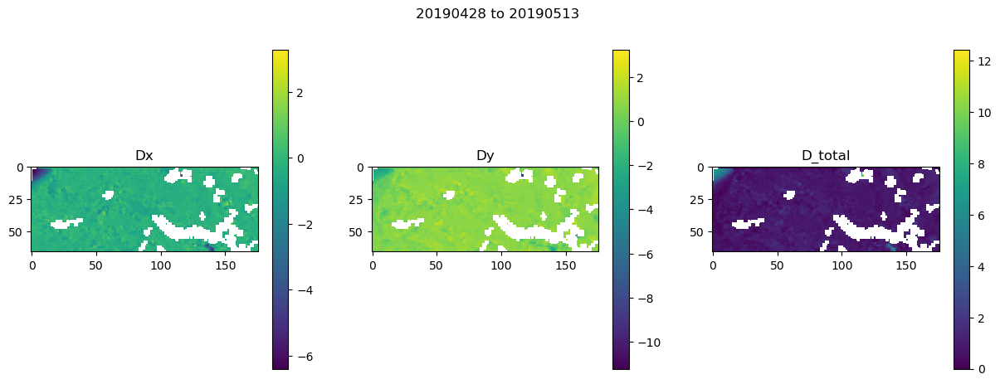

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018522024154663086
S2A_7VEG_20190513_B08_VG_clipped.tif S2B_7VEG_20190607_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

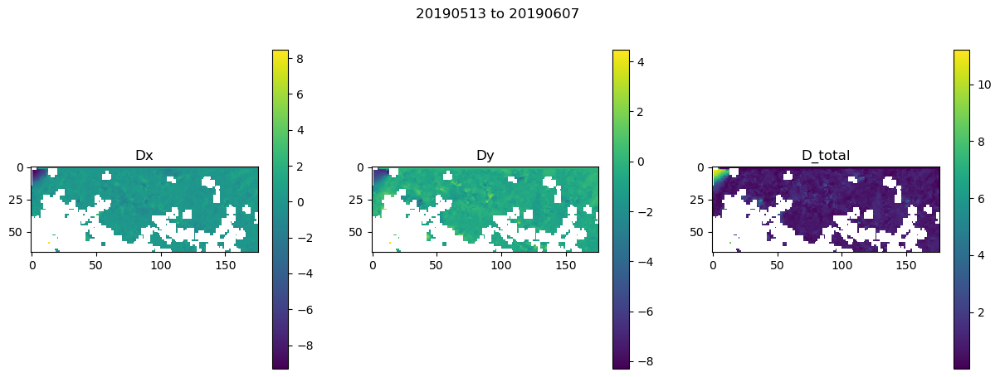

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018830060958862305
S2B_7VEG_20190607_B08_VG_clipped.tif S2B_7VEG_20190627_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

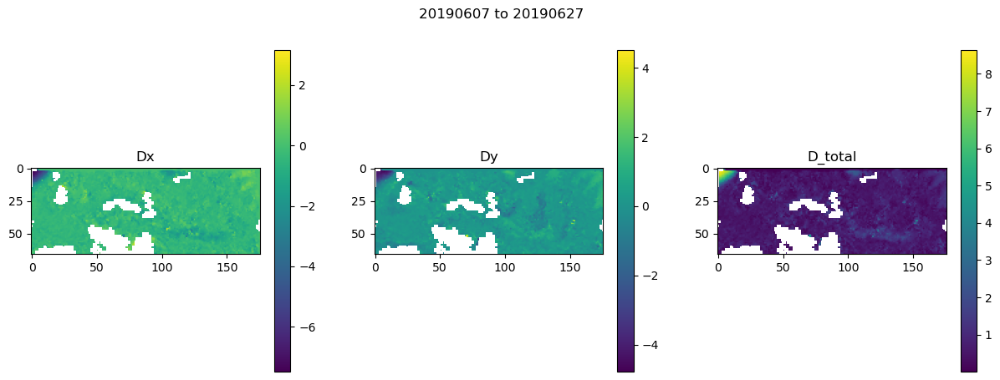

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020821809768676758
S2B_7VEG_20190627_B08_VG_clipped.tif S2B_7VEG_20190707_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

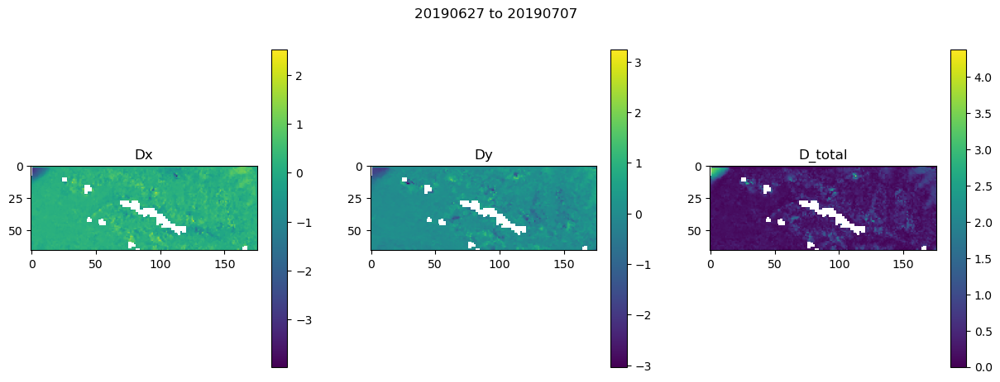

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019899845123291016
S2B_7VEG_20190707_B08_VG_clipped.tif S2A_7VEG_20190722_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

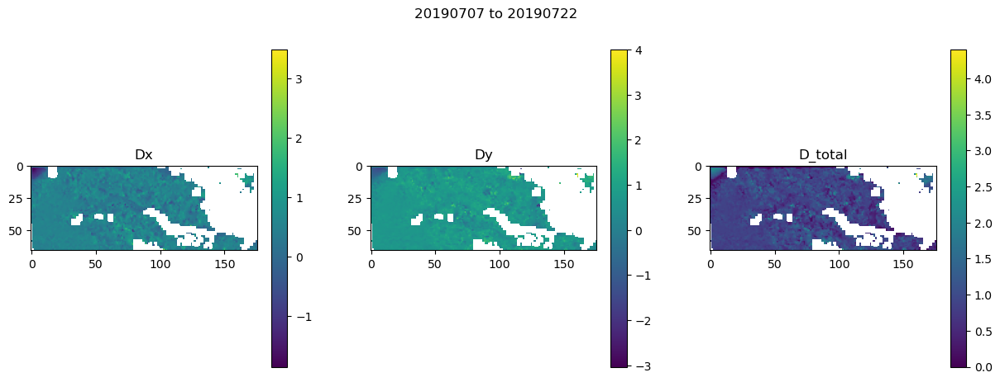

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019405841827392578
S2A_7VEG_20190722_B08_VG_clipped.tif S2B_7VEG_20190806_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

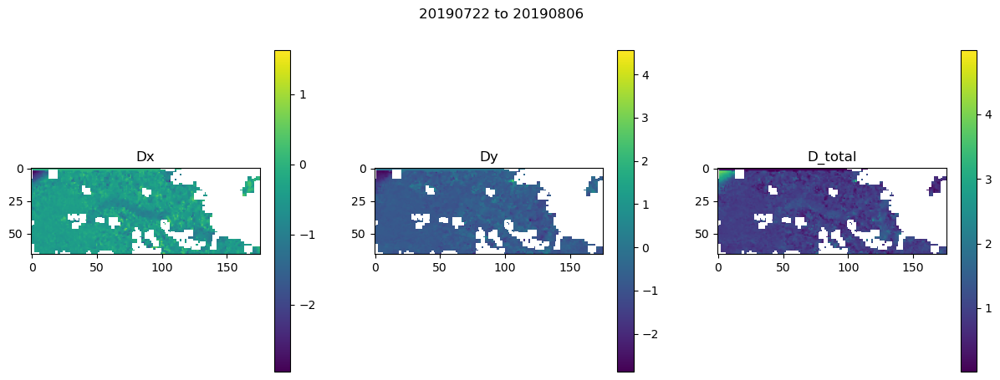

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018558979034423828
S2B_7VEG_20190806_B08_VG_clipped.tif S2A_7VEG_20190811_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

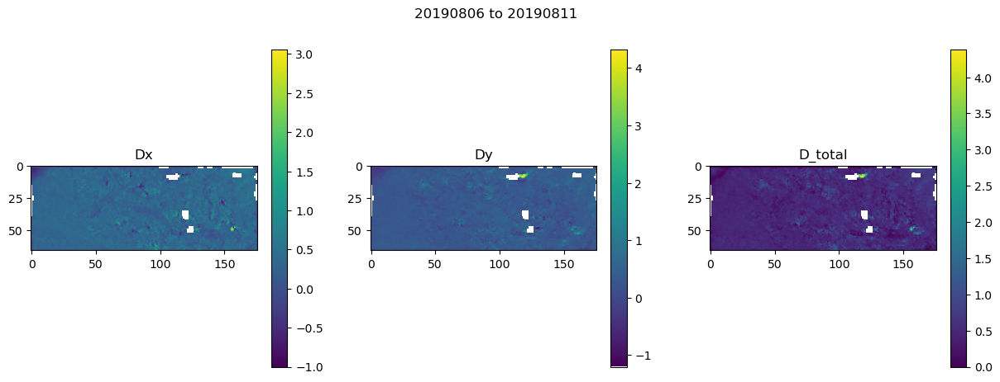

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02014303207397461
S2A_7VEG_20190811_B08_VG_clipped.tif S2A_7VEG_20190821_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

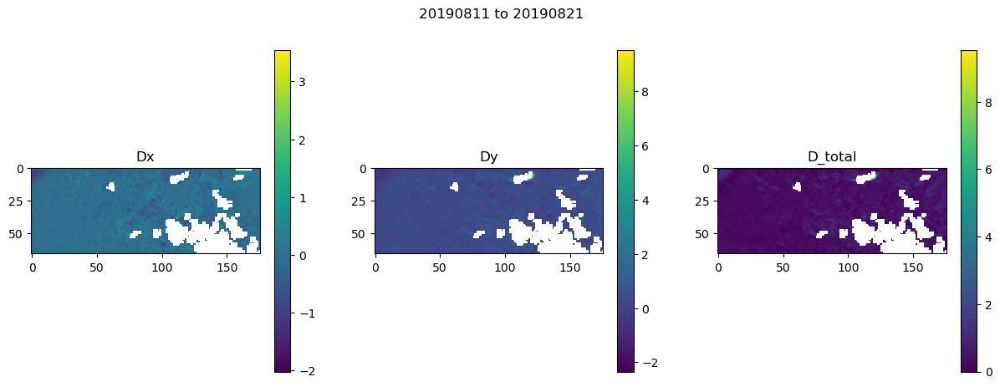

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01993393898010254
S2A_7VEG_20190821_B08_VG_clipped.tif S2B_7VEG_20190905_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

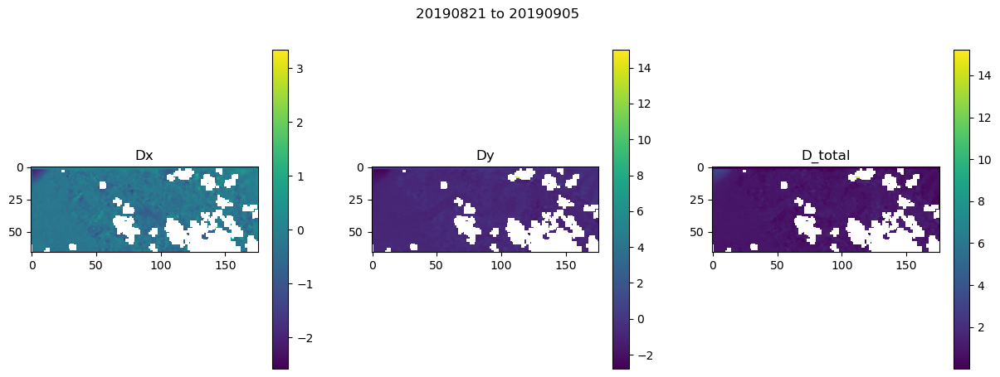

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018783092498779297
S2B_7VEG_20190905_B08_VG_clipped.tif S2B_7VEG_20190915_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

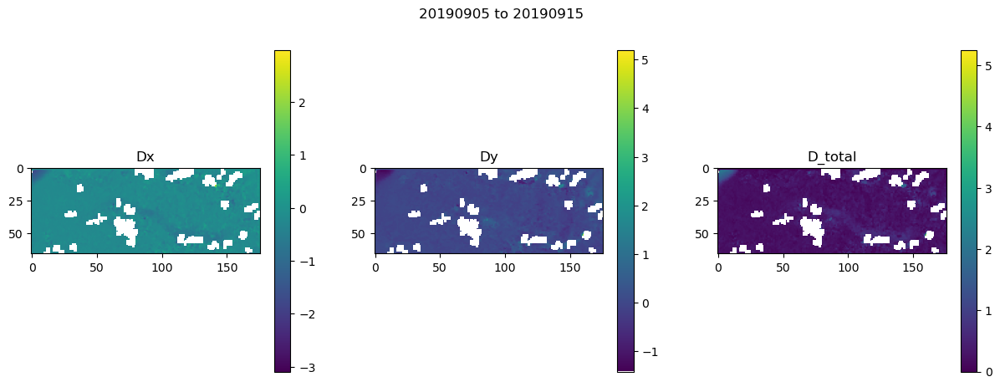

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01926398277282715
S2B_7VEG_20190915_B08_VG_clipped.tif S2A_7VEG_20191020_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3024000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

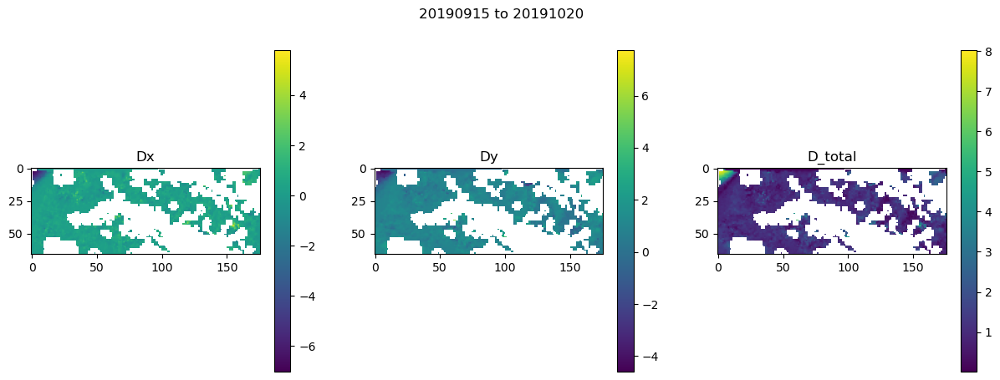

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02054595947265625
S2A_7VEG_20191020_B08_VG_clipped.tif S2B_7VEG_20191025_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

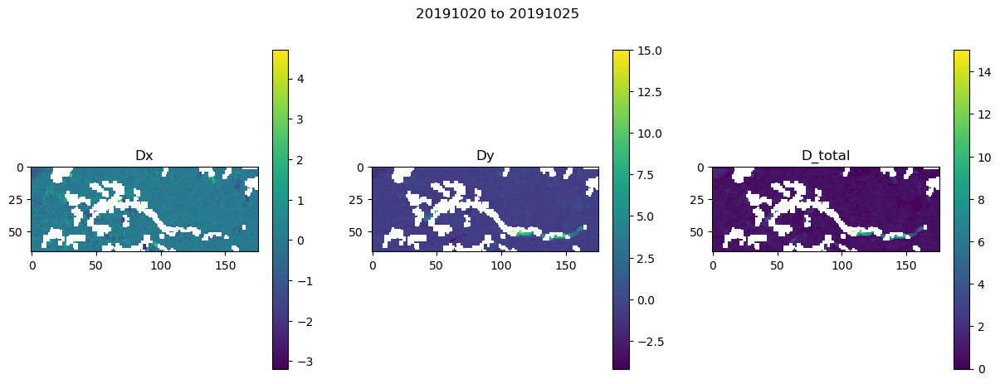

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018553733825683594
S2B_7VEG_20191025_B08_VG_clipped.tif S2A_7VEG_20191109_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

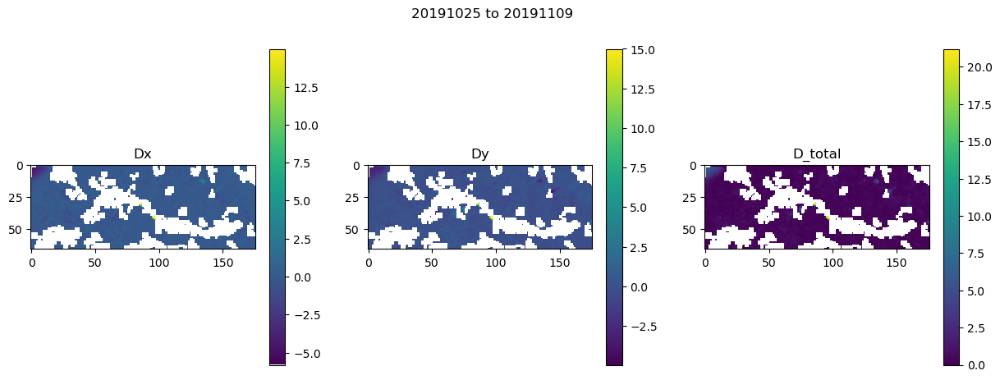

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018900156021118164
20191109 20200323
20191109 20200330
20191109 20200402
20191109 20200419
20191109 20200502
20191109 20200512
20191109 20200527
20191109 20200626
20191109 20200701
20191109 20200716
20191109 20200731
20191109 20200914
20191109 20210211
20191109 20210402
20191109 20210422
20191109 20210502
20191109 20210611
20191109 20210701
20191109 20210716
20191109 20210731
20191109 20210815
20191109 20210830
20191109 20210919
20191109 20211004
20191109 20220820
No image pair with correct time separation found. Skip to next.
S2B_7VEG_20200202_B08_VG_clipped.tif S2B_7VEG_20200323_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-

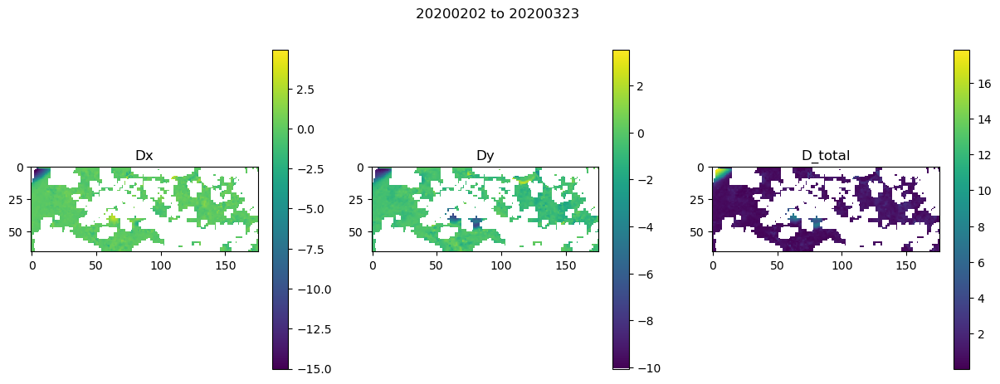

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01920604705810547
S2B_7VEG_20200323_B08_VG_clipped.tif S2B_7VEG_20200330_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

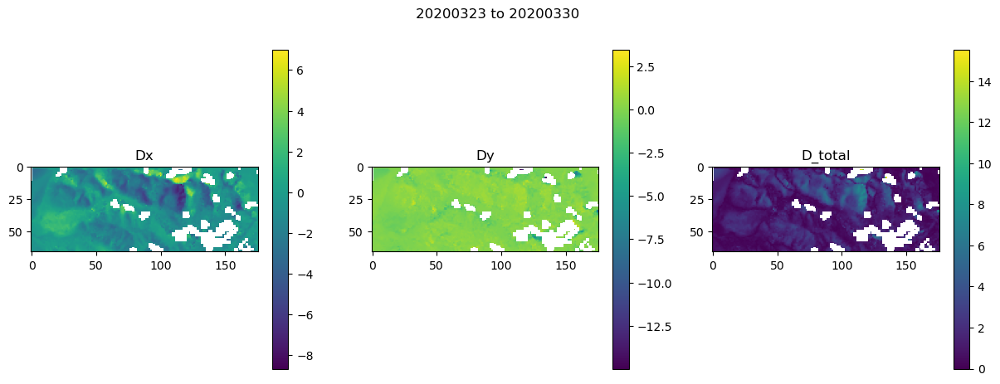

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019189834594726562
20200330 20200419
S2B_7VEG_20200330_B08_VG_clipped.tif S2B_7VEG_20200419_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan202

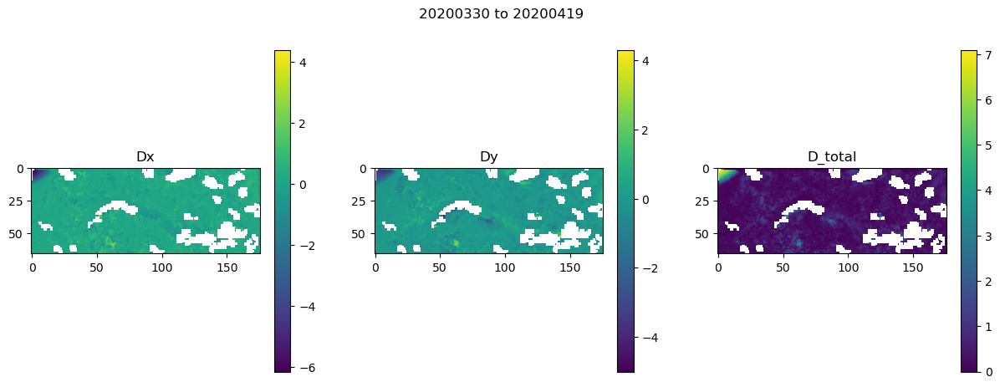

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02039313316345215
S2B_7VEG_20200419_B08_VG_clipped.tif S2B_7VEG_20200502_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1123200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

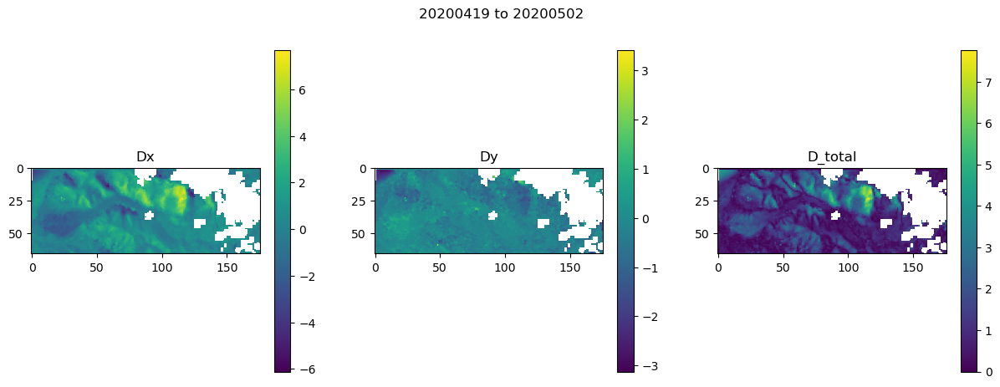

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.026969194412231445
S2B_7VEG_20200502_B08_VG_clipped.tif S2B_7VEG_20200512_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

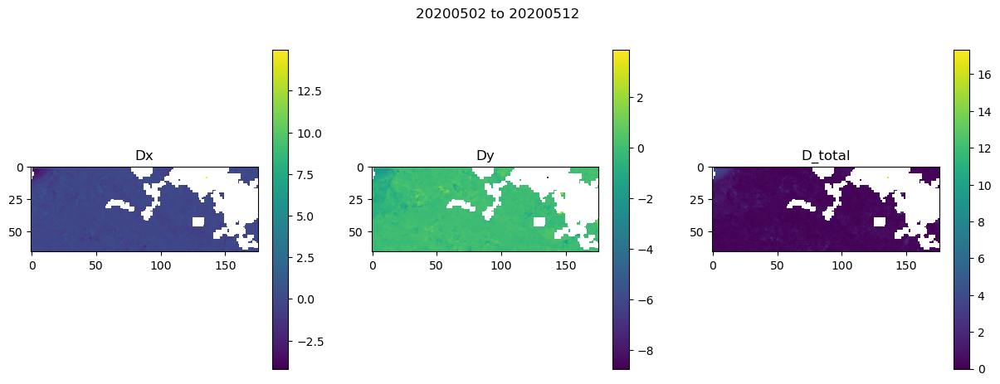

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01970505714416504
S2B_7VEG_20200512_B08_VG_clipped.tif S2A_7VEG_20200527_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

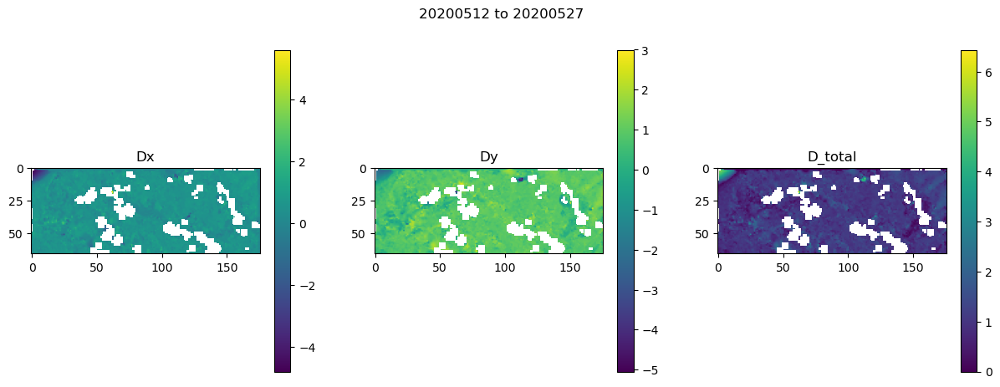

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01867508888244629
S2A_7VEG_20200527_B08_VG_clipped.tif S2A_7VEG_20200626_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2592000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

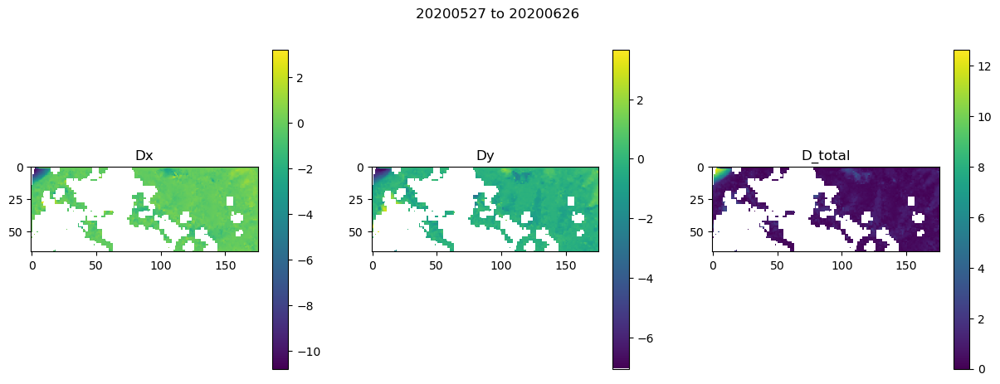

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019420146942138672
S2A_7VEG_20200626_B08_VG_clipped.tif S2B_7VEG_20200701_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

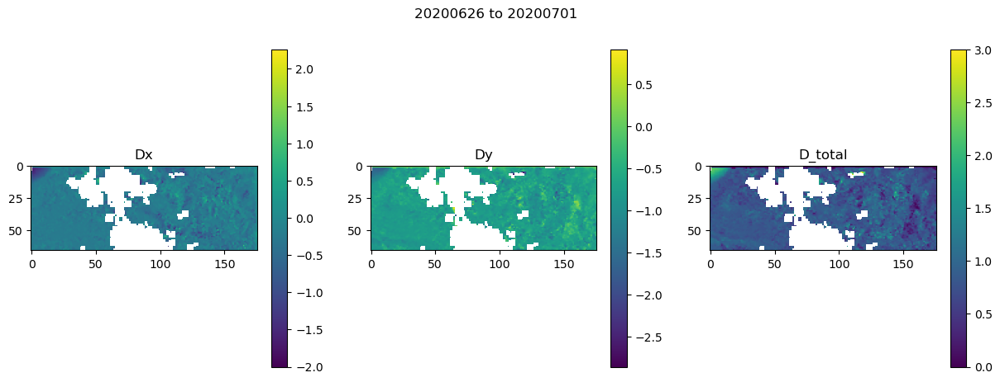

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0192720890045166
S2B_7VEG_20200701_B08_VG_clipped.tif S2A_7VEG_20200716_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

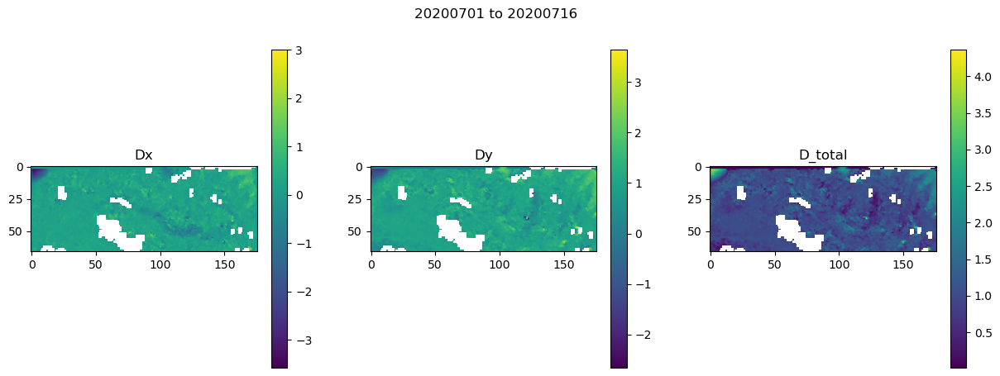

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019407033920288086
S2A_7VEG_20200716_B08_VG_clipped.tif S2B_7VEG_20200731_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

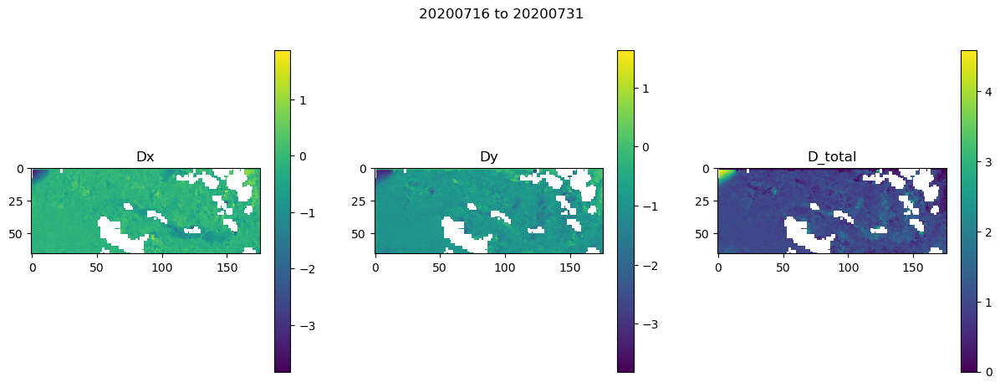

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019240379333496094
S2B_7VEG_20200731_B08_VG_clipped.tif S2A_7VEG_20200914_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3888000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

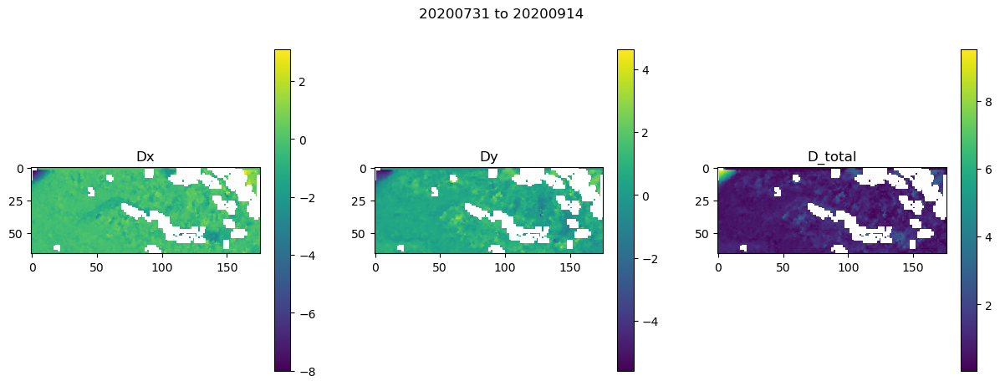

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019862890243530273
20200914 20210402
20200914 20210422
20200914 20210502
20200914 20210611
20200914 20210701
20200914 20210716
20200914 20210731
20200914 20210815
20200914 20210830
20200914 20210919
20200914 20211004
20200914 20220820
No image pair with correct time separation found. Skip to next.
S2A_7VEG_20210211_B08_VG_clipped.tif S2A_7VEG_20210402_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 4320000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0

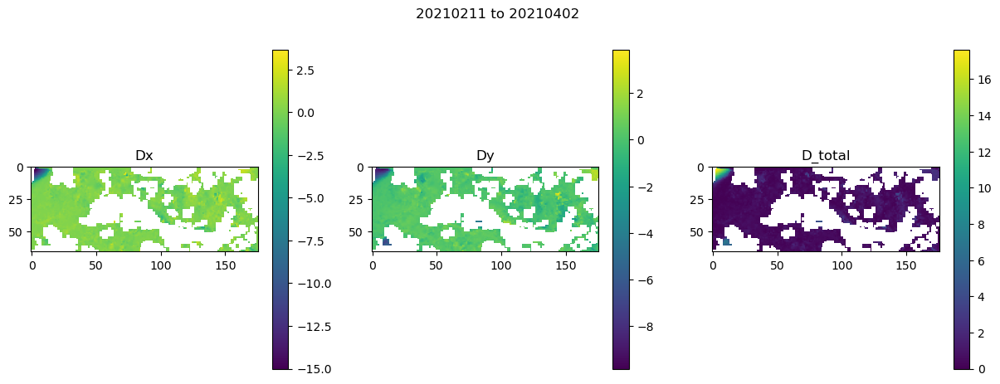

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019093036651611328
S2A_7VEG_20210402_B08_VG_clipped.tif S2A_7VEG_20210422_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

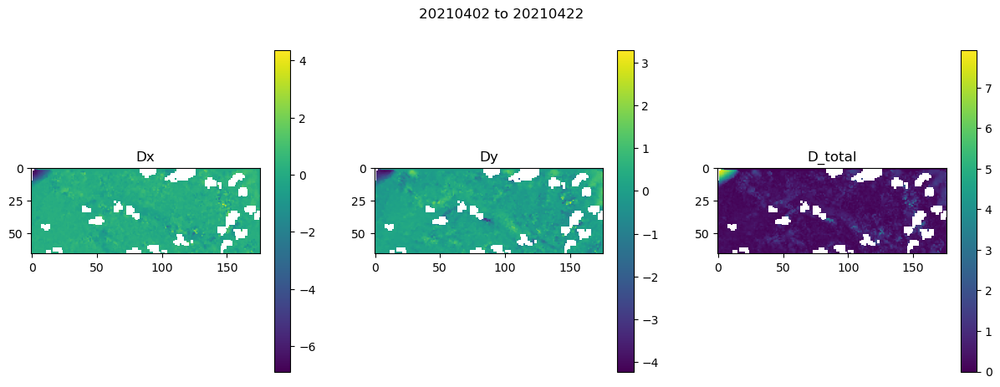

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019776105880737305
S2A_7VEG_20210422_B08_VG_clipped.tif S2A_7VEG_20210502_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

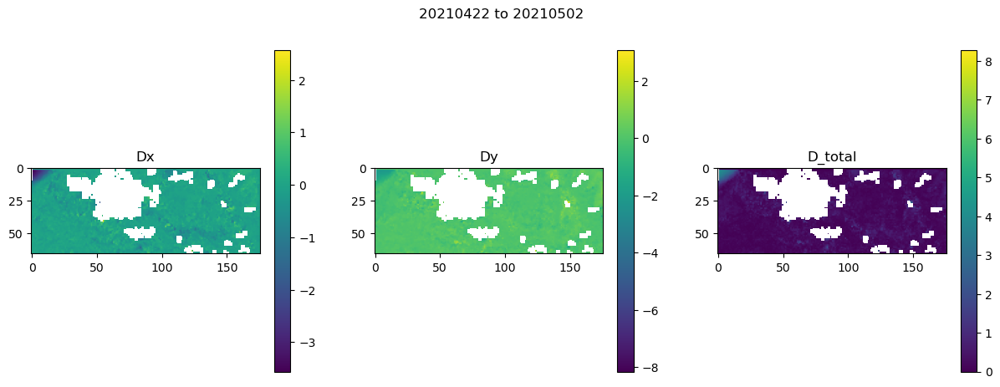

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0195772647857666
S2A_7VEG_20210502_B08_VG_clipped.tif S2A_7VEG_20210611_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cli

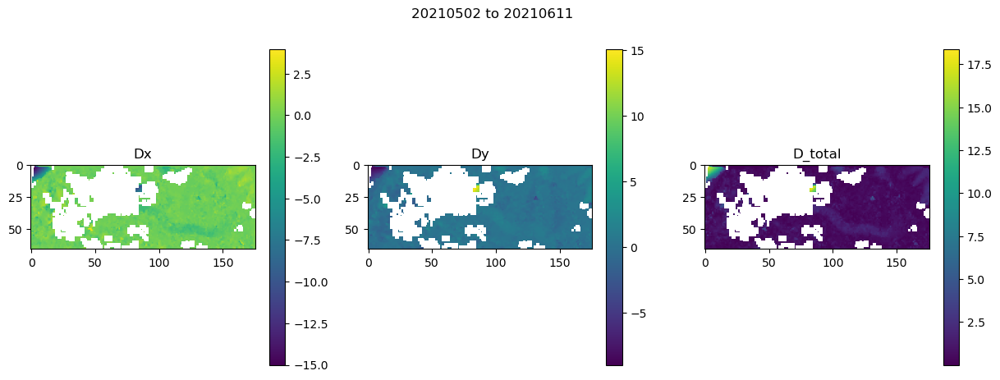

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02044081687927246
S2A_7VEG_20210611_B08_VG_clipped.tif S2A_7VEG_20210701_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

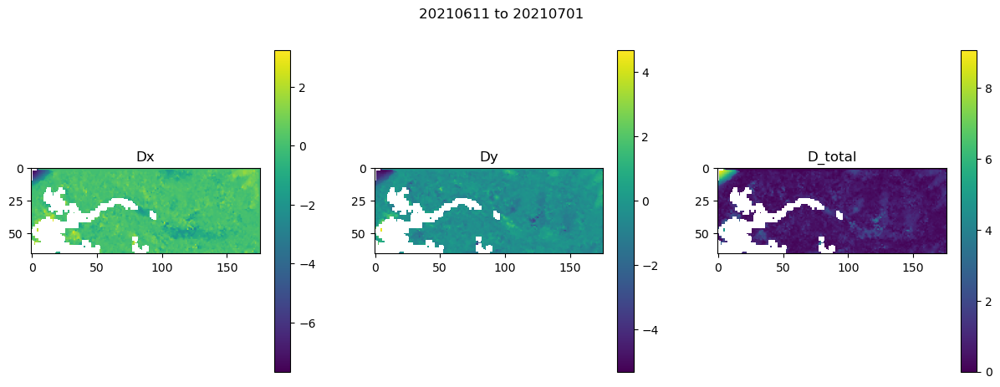

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02042698860168457
S2A_7VEG_20210701_B08_VG_clipped.tif S2B_7VEG_20210716_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

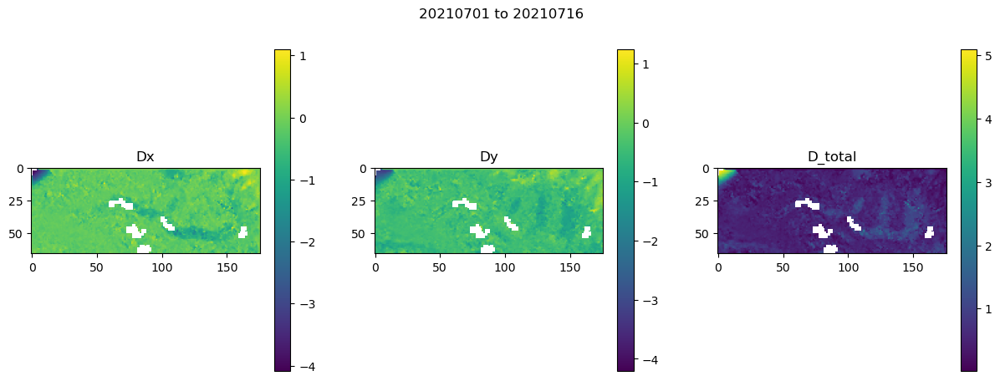

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01901388168334961
S2B_7VEG_20210716_B08_VG_clipped.tif S2A_7VEG_20210731_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

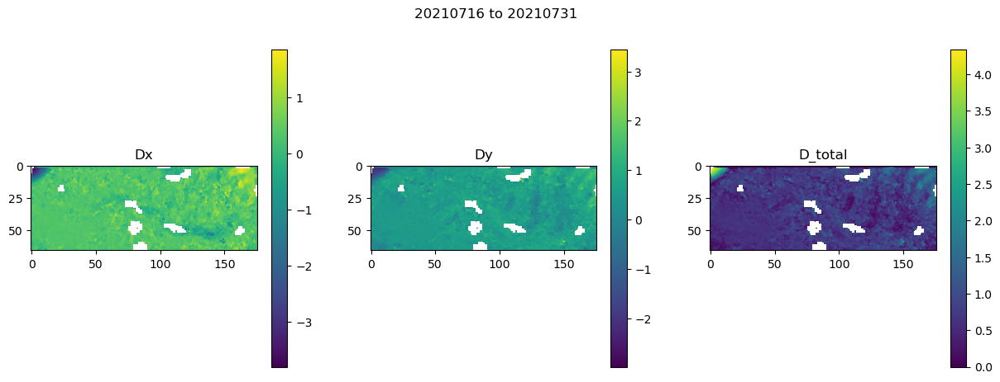

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018991947174072266
S2A_7VEG_20210731_B08_VG_clipped.tif S2B_7VEG_20210815_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

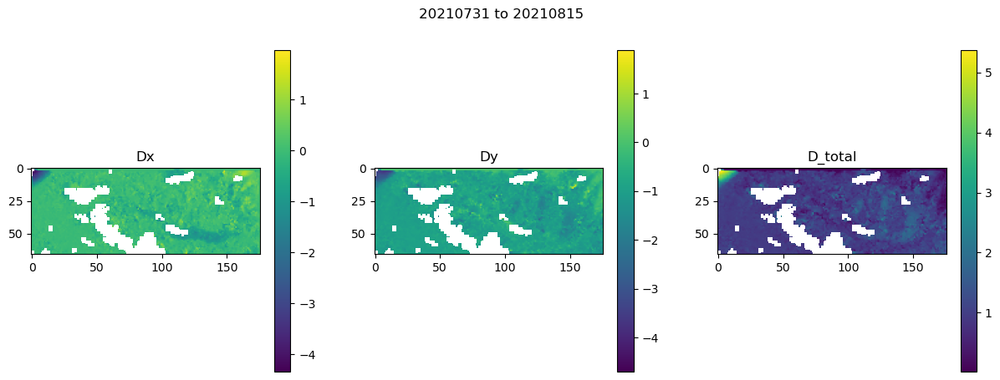

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021404266357421875
S2B_7VEG_20210815_B08_VG_clipped.tif S2A_7VEG_20210830_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

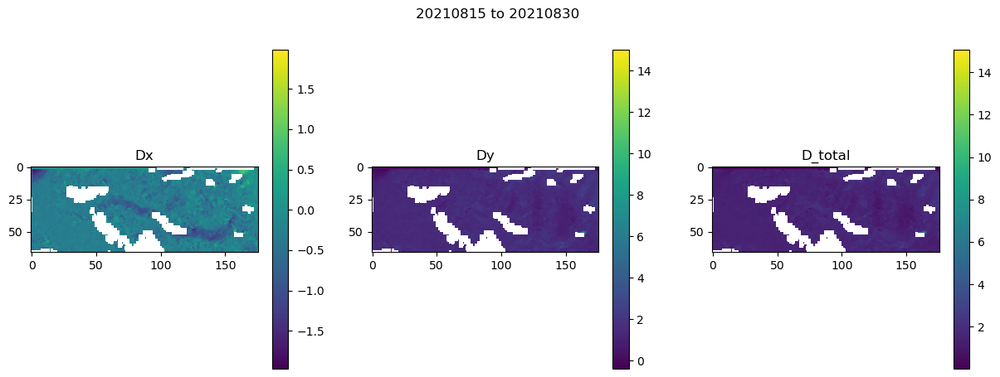

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018872976303100586
S2A_7VEG_20210830_B08_VG_clipped.tif S2A_7VEG_20210919_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_c

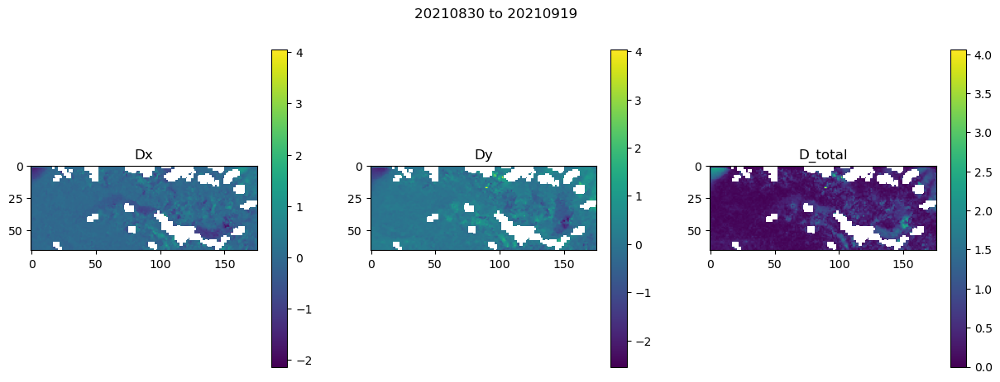

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01983475685119629
S2A_7VEG_20210919_B08_VG_clipped.tif S2B_7VEG_20211004_B08_VG_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  10.0
Y-direction coordinate: 6656590.0  -10.0
Dimensions: 1760  676

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_cl

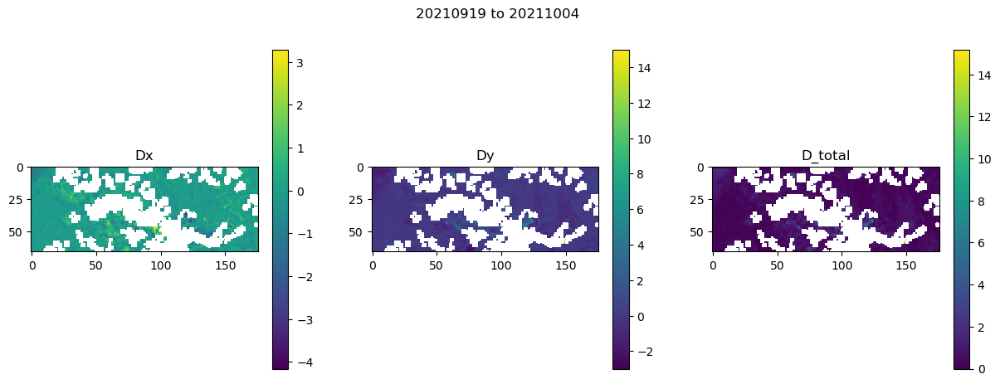

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019312143325805664
No image pair with correct time separation found. Skip to next.
Finished searching.
Number of files found: 90
Nolan2021_ASTER_20070903_clipped_5m_100m.tif  already exists.
Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif and Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif already exist.
vx_100m.tif , vy_100m.tif , srx_100m.tif , sry_100m.tif already exist.
LC08_L1TP_062018_20131007_20200913_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20131124_20200912_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Di

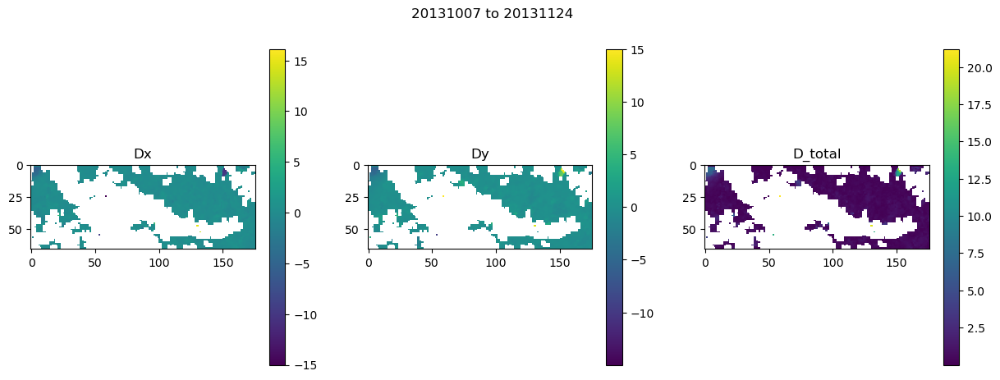

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01921701431274414
20131124 20140503
20131124 20140604
20131124 20140722
20131124 20140823
20131124 20141019
20131124 20141120
20131124 20150107
20131124 20150319
20131124 20150506
20131124 20150515
20131124 20150522
20131124 20150531
20131124 20150623
20131124 20150709
20131124 20150725
20131124 20151006
20131124 20151114
20131124 20151123
20131124 20151130
20131124 20151216
20131124 20160110
20131124 20160117
20131124 20160314
20131124 20160321
20131124 20160330
20131124 20160508
20131124 20160609
20131124 20160711
20131124 20161008
20131124 20161015
20131124 20161031
20131124 20161116
20131124 20161211
20131124 20170103
20131124 20170204
20131124 20170220
20131124 20170324
20131124 20170527
20131124 20171221
20131124 20171230
20131124 20180131
20131124 20180207
20131124 20180428
20131124 20180615
20131124 20180903
20131124 20181115
20131124 20190109
20131124 20190118
20131124 

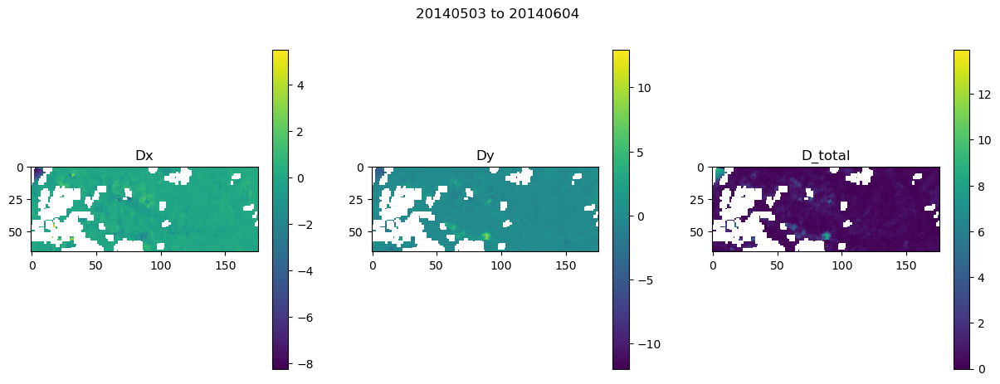

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01920318603515625
LC08_L1TP_062018_20140604_20200911_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20140722_20200911_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 4147200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

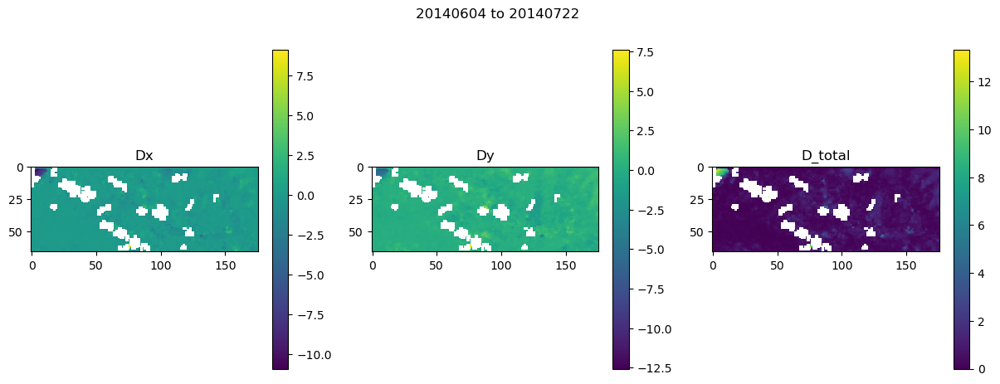

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019365787506103516
LC08_L1TP_062018_20140722_20200911_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20140823_20200911_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

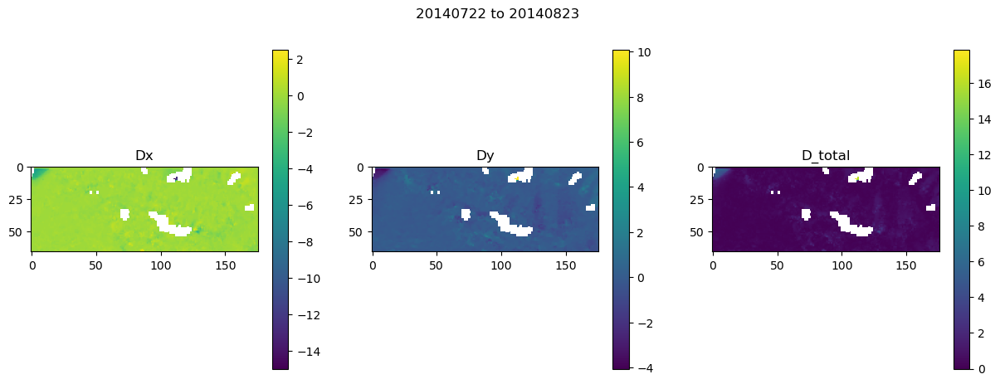

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019524812698364258
LC08_L1TP_062018_20140823_20200911_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20141019_20200910_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 4924800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

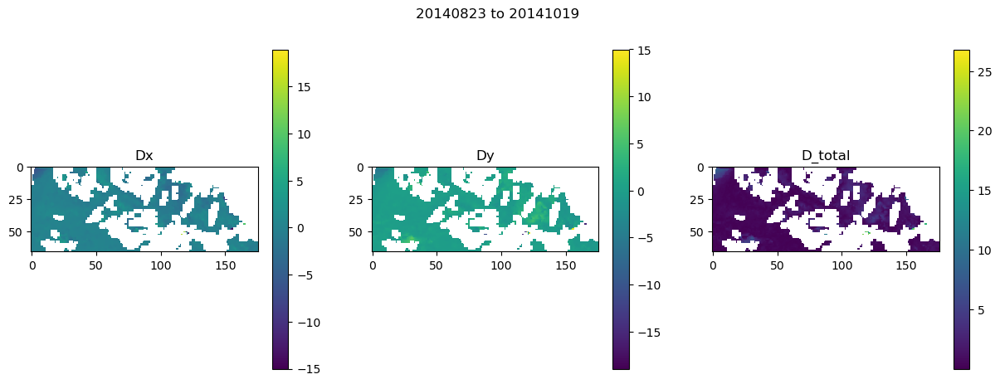

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018649816513061523
LC08_L1TP_061018_20141019_20200910_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20141120_20200910_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

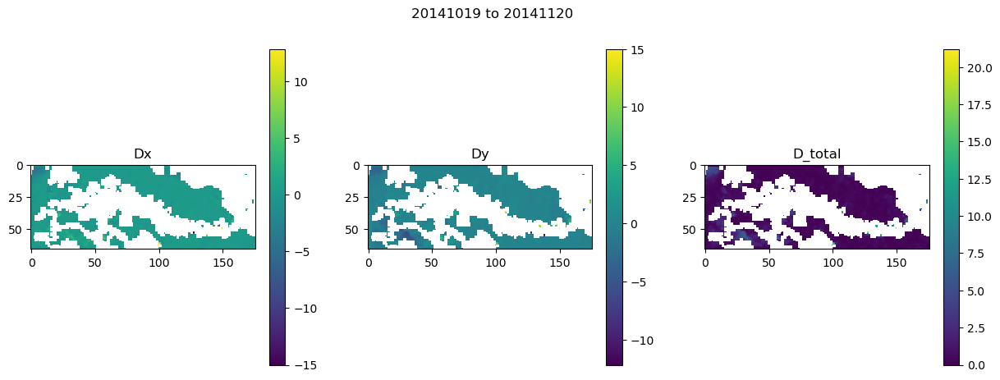

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018670082092285156
LC08_L1TP_061018_20141120_20200910_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20150107_20200910_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 4147200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

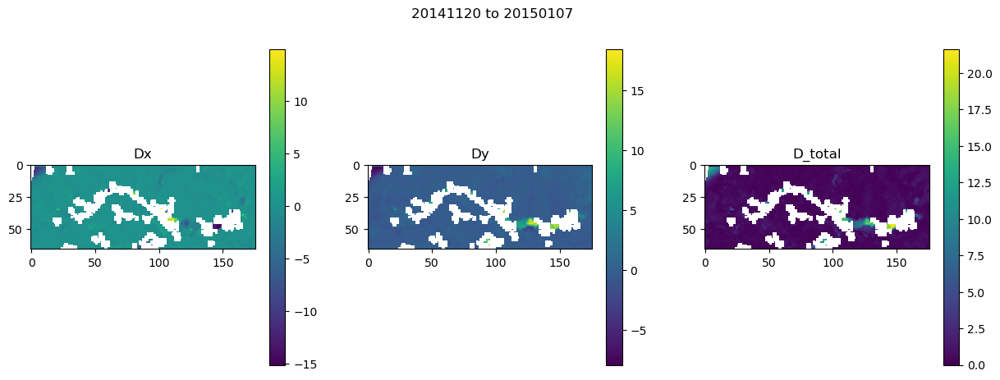

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01914811134338379
20150107 20150506
20150107 20150515
20150107 20150522
20150107 20150531
20150107 20150623
20150107 20150709
20150107 20150725
20150107 20151006
20150107 20151114
20150107 20151123
20150107 20151130
20150107 20151216
20150107 20160110
20150107 20160117
20150107 20160314
20150107 20160321
20150107 20160330
20150107 20160508
20150107 20160609
20150107 20160711
20150107 20161008
20150107 20161015
20150107 20161031
20150107 20161116
20150107 20161211
20150107 20170103
20150107 20170204
20150107 20170220
20150107 20170324
20150107 20170527
20150107 20171221
20150107 20171230
20150107 20180131
20150107 20180207
20150107 20180428
20150107 20180615
20150107 20180903
20150107 20181115
20150107 20190109
20150107 20190118
20150107 20190210
20150107 20190219
20150107 20190226
20150107 20190307
20150107 20190330
20150107 20190415
20150107 20190501
20150107 20190627
20150107 

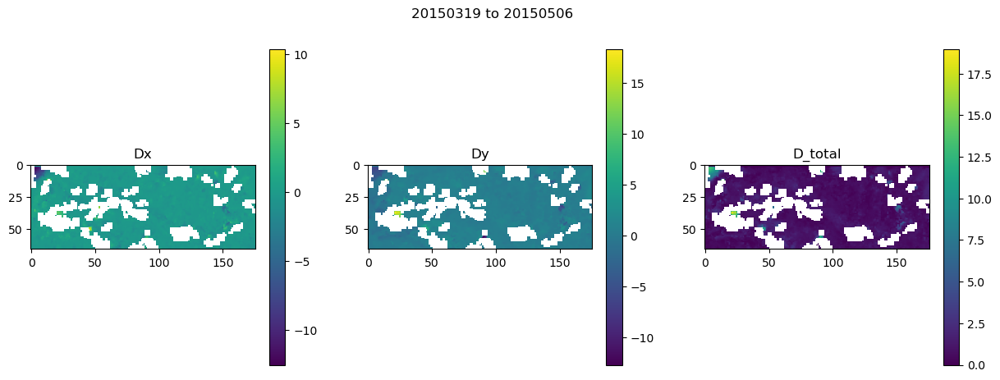

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018877029418945312
LC08_L1TP_062018_20150506_20200909_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20150515_20200909_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

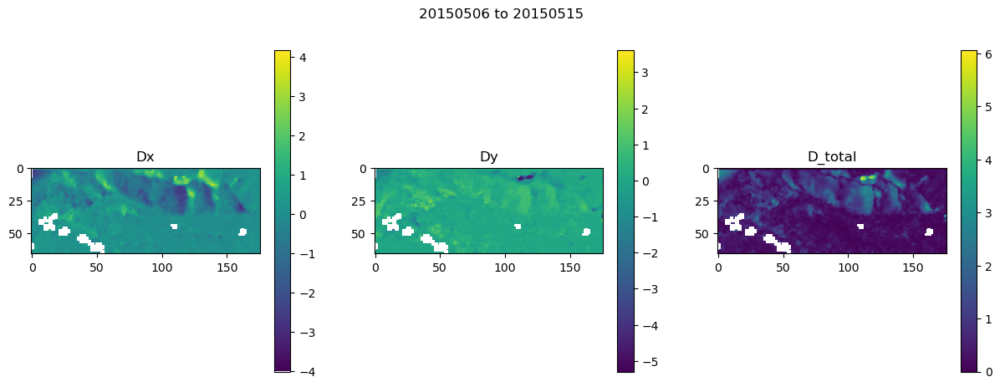

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019657135009765625
LC08_L1TP_061018_20150515_20200909_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20150522_20200909_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

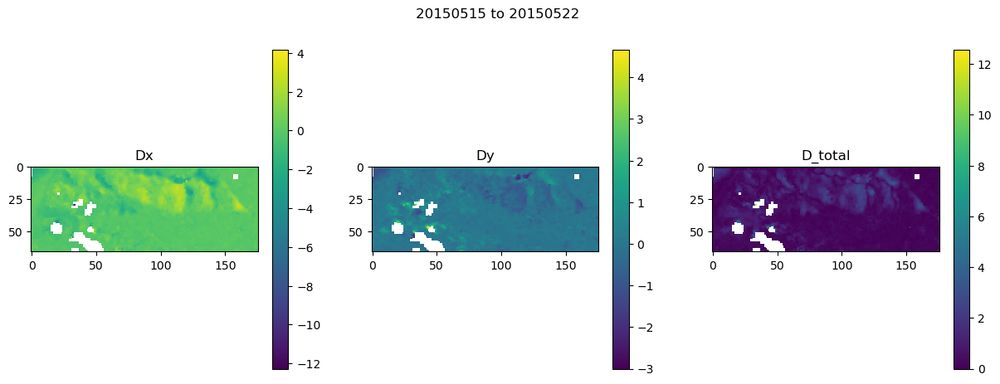

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01906895637512207
LC08_L1TP_062018_20150522_20200909_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20150531_20200909_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

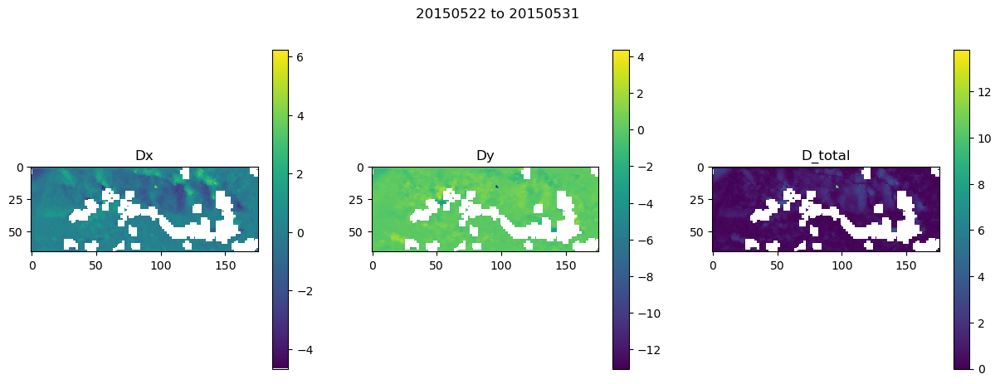

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019900083541870117
LC08_L1TP_061018_20150531_20200909_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20150623_20200909_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1987200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

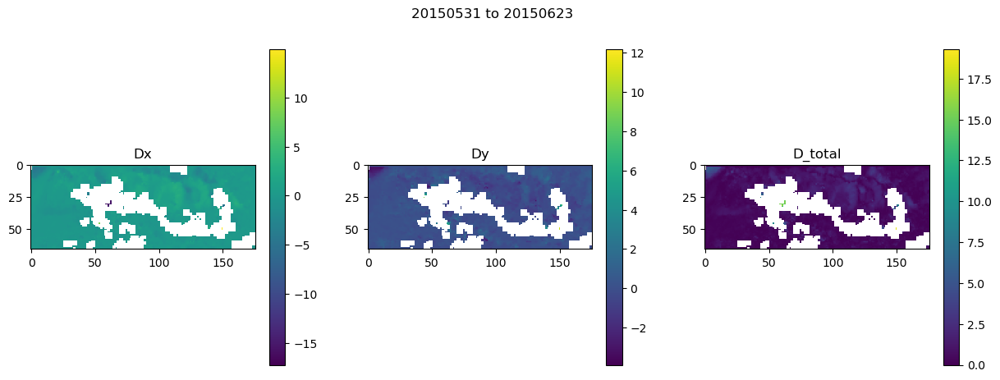

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01891779899597168
LC08_L1TP_062018_20150623_20200909_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20150709_20200909_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

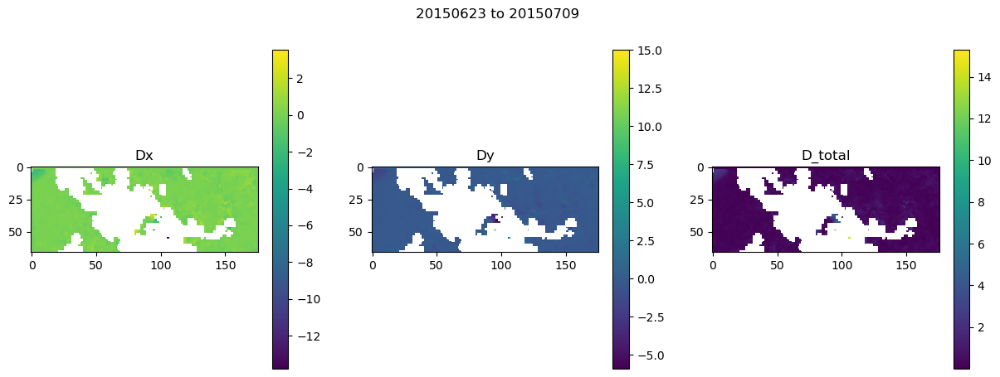

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019058942794799805
LC08_L1TP_062018_20150709_20200909_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20150725_20200908_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

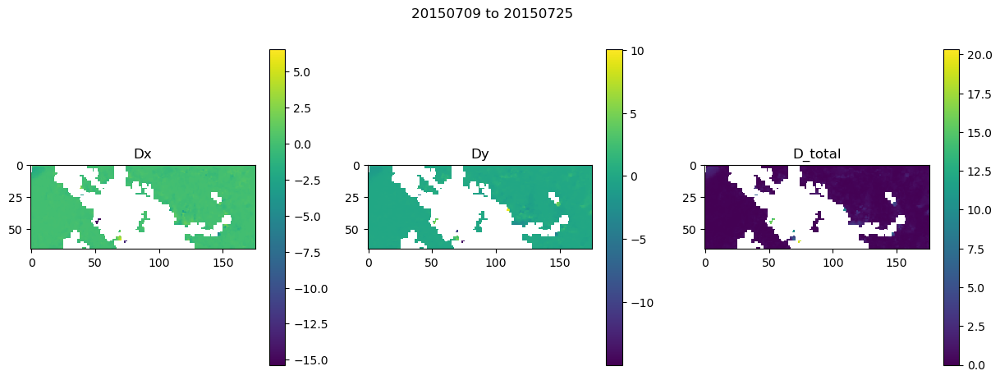

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018651247024536133
20150725 20151114
20150725 20151123
20150725 20151130
20150725 20151216
20150725 20160110
20150725 20160117
20150725 20160314
20150725 20160321
20150725 20160330
20150725 20160508
20150725 20160609
20150725 20160711
20150725 20161008
20150725 20161015
20150725 20161031
20150725 20161116
20150725 20161211
20150725 20170103
20150725 20170204
20150725 20170220
20150725 20170324
20150725 20170527
20150725 20171221
20150725 20171230
20150725 20180131
20150725 20180207
20150725 20180428
20150725 20180615
20150725 20180903
20150725 20181115
20150725 20190109
20150725 20190118
20150725 20190210
20150725 20190219
20150725 20190226
20150725 20190307
20150725 20190330
20150725 20190415
20150725 20190501
20150725 20190627
20150725 20190713
20150725 20200213
20150725 20200401
20150725 20200417
20150725 20200512
20150725 20200528
20150725 20200731
20150725 20201010
20150725

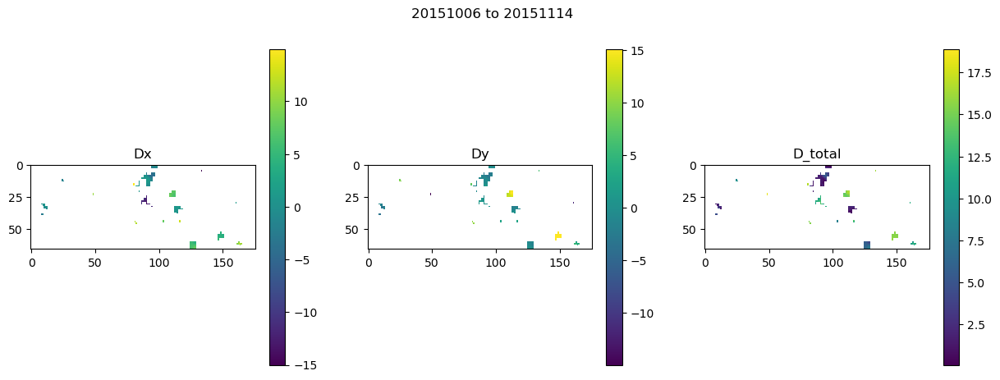

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02003788948059082
LC08_L1TP_062018_20151114_20200908_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20151123_20200908_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

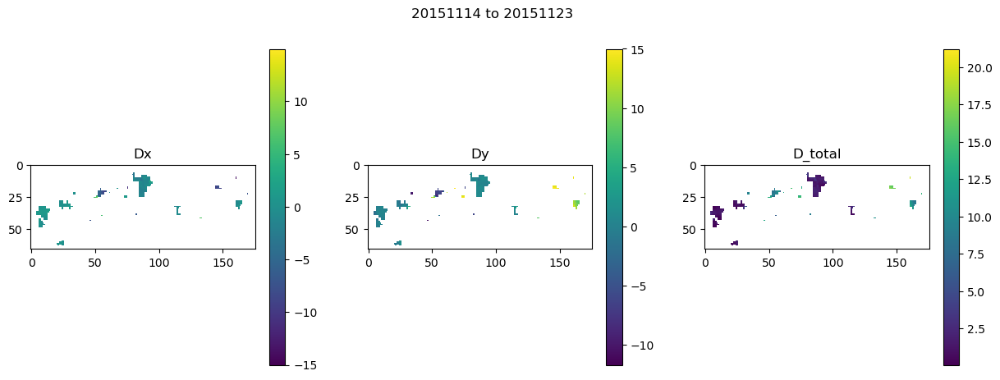

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018891096115112305
LC08_L1TP_061018_20151123_20200908_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20151130_20200908_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

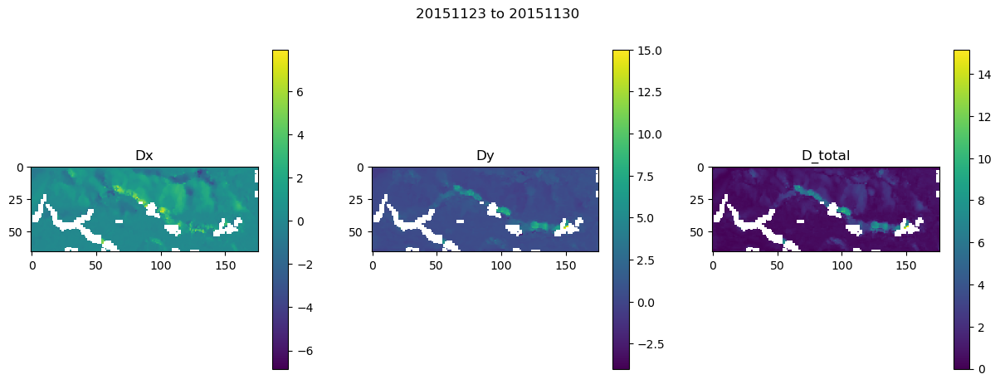

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021175861358642578
LC08_L1TP_062018_20151130_20200908_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20151216_20200908_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

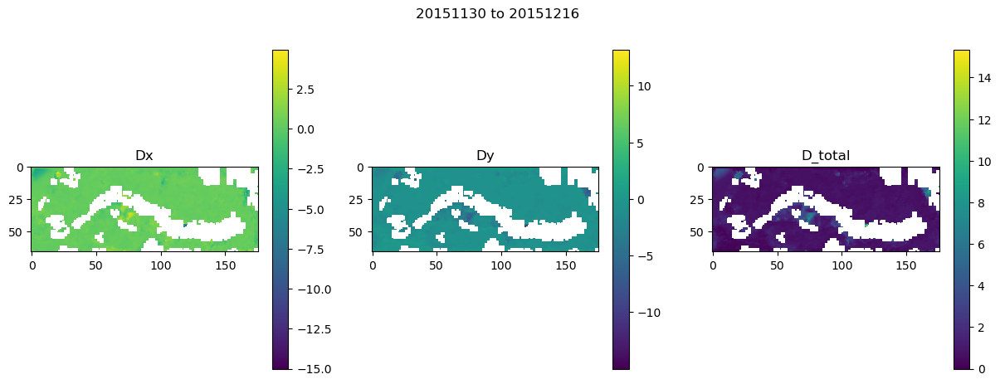

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2930421829223633
LC08_L1TP_062018_20151216_20200908_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20160110_20200907_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

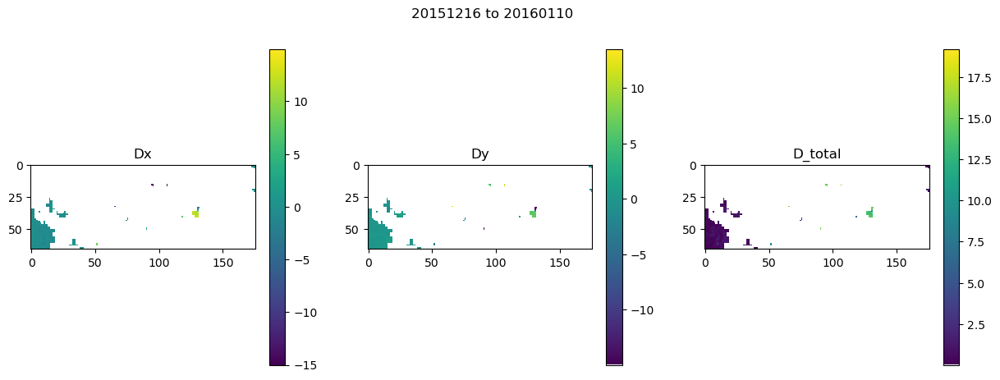

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01972198486328125
LC08_L1TP_061018_20160110_20200907_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20160117_20200907_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

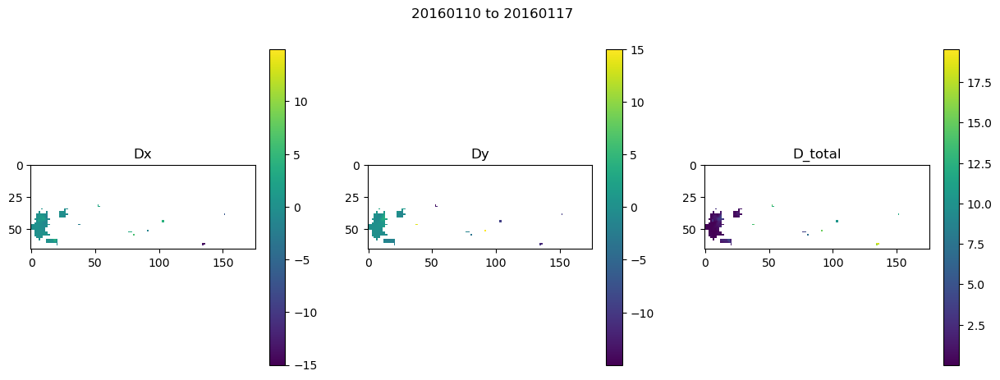

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019360065460205078
LC08_L1TP_062018_20160117_20200907_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20160314_20200907_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 4924800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

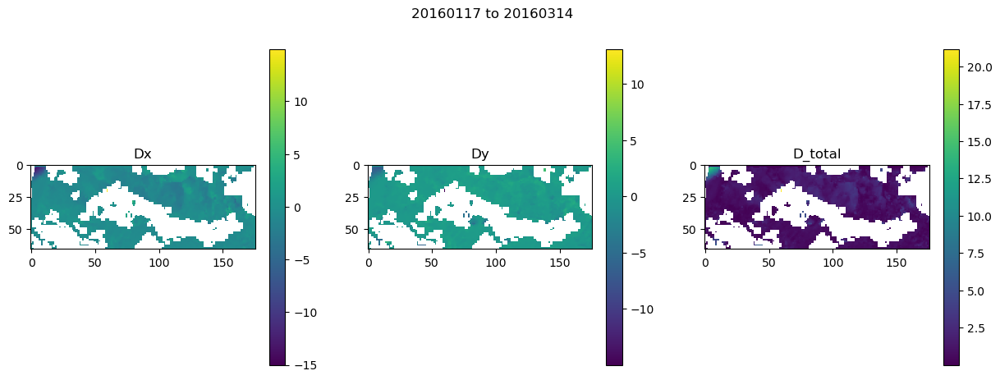

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019170761108398438
LC08_L1TP_061018_20160314_20200907_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20160321_20200907_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

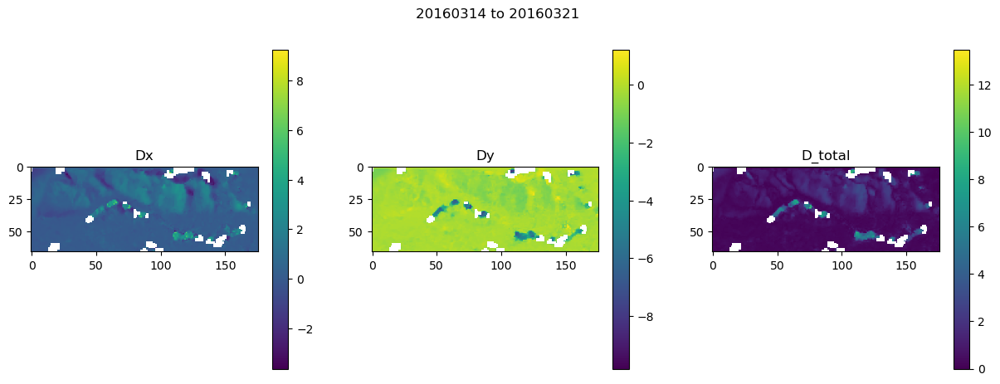

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01914811134338379
LC08_L1TP_062018_20160321_20200907_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20160330_20200907_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

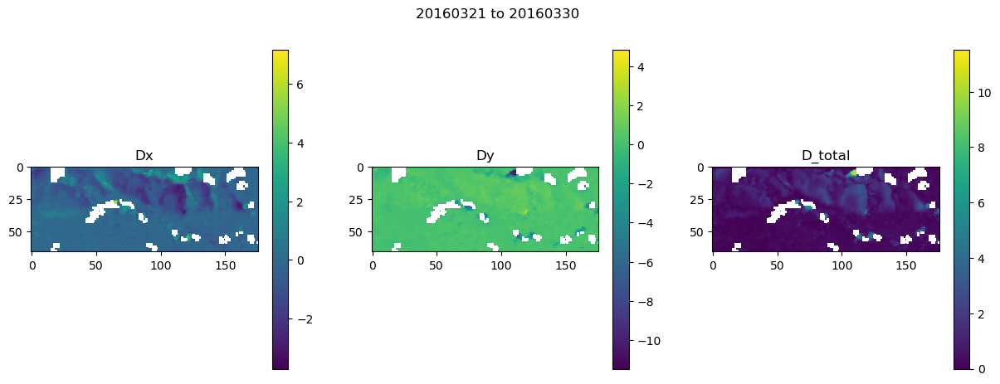

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019632816314697266
LC08_L1TP_061018_20160330_20200907_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20160508_20200907_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

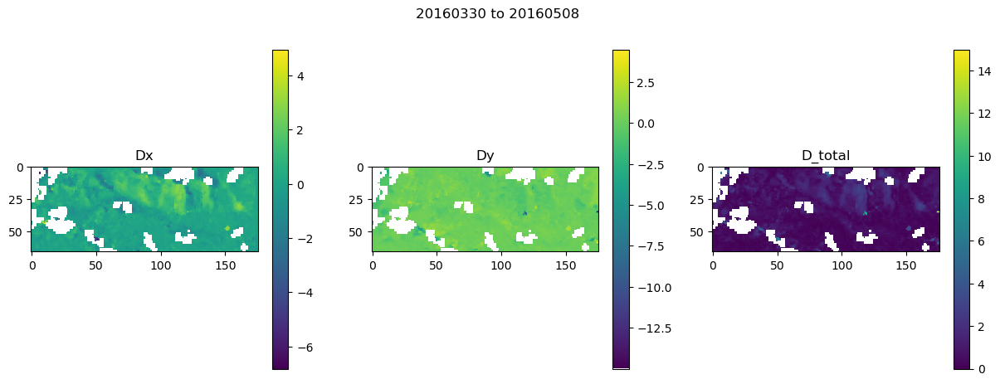

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.045053958892822266
LC08_L1TP_062018_20160508_20200907_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20160609_20200906_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

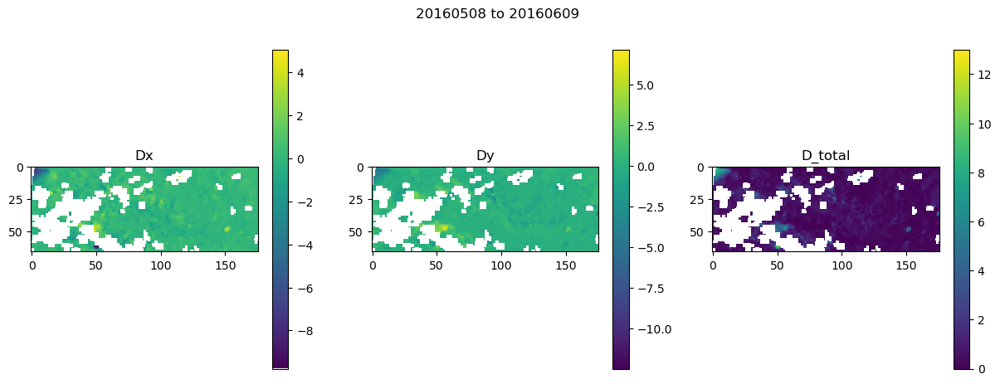

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019629716873168945
LC08_L1TP_062018_20160609_20200906_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20160711_20200906_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

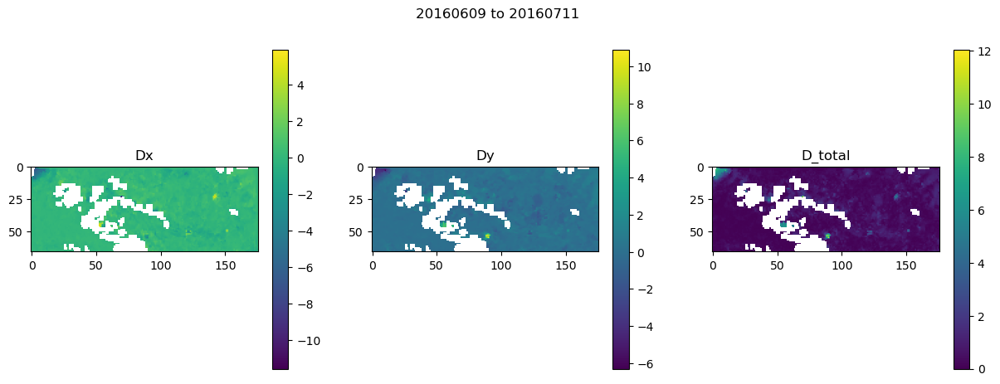

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01904606819152832
20160711 20161015
20160711 20161031
20160711 20161116
20160711 20161211
20160711 20170103
20160711 20170204
20160711 20170220
20160711 20170324
20160711 20170527
20160711 20171221
20160711 20171230
20160711 20180131
20160711 20180207
20160711 20180428
20160711 20180615
20160711 20180903
20160711 20181115
20160711 20190109
20160711 20190118
20160711 20190210
20160711 20190219
20160711 20190226
20160711 20190307
20160711 20190330
20160711 20190415
20160711 20190501
20160711 20190627
20160711 20190713
20160711 20200213
20160711 20200401
20160711 20200417
20160711 20200512
20160711 20200528
20160711 20200731
20160711 20201010
20160711 20201019
20160711 20201120
20160711 20211104
20160711 20220117
20160711 20220202
20160711 20220219
20160711 20220306
20160711 20220415
20160711 20220518
20160711 20220525
20160711 20220526
20160711 20220602
20160711 20220611
20160711 

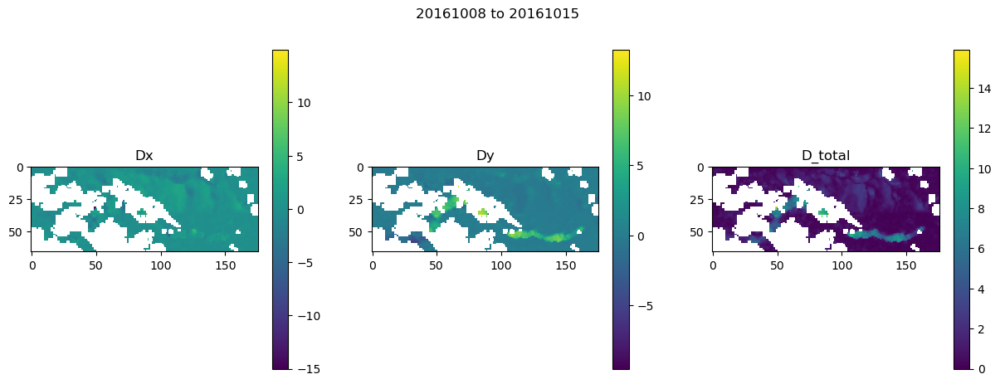

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01972031593322754
LC08_L1TP_062018_20161015_20200905_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20161031_20201015_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

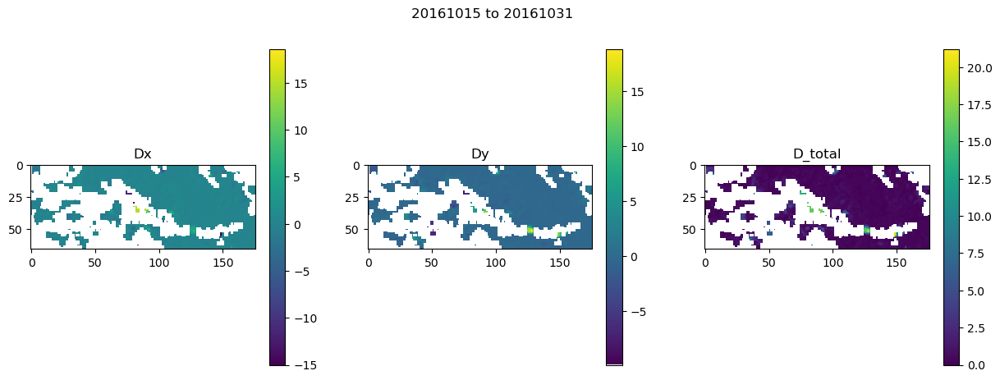

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020099878311157227
LC08_L1TP_062018_20161031_20201015_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20161116_20200905_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

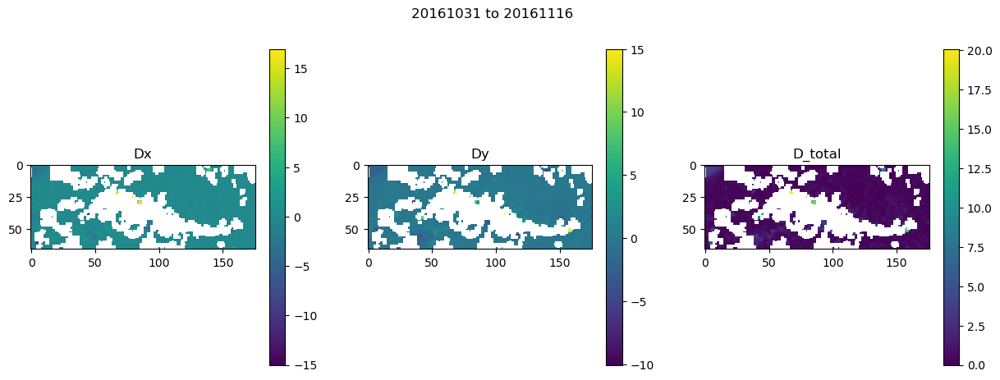

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019309043884277344
LC08_L1TP_062018_20161116_20200905_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20161211_20200905_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

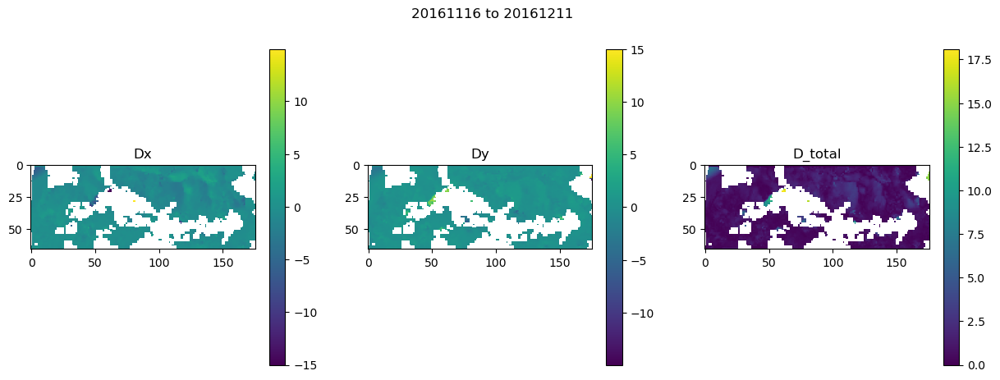

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020366907119750977
LC08_L1TP_061018_20161211_20200905_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20170103_20200905_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1987200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

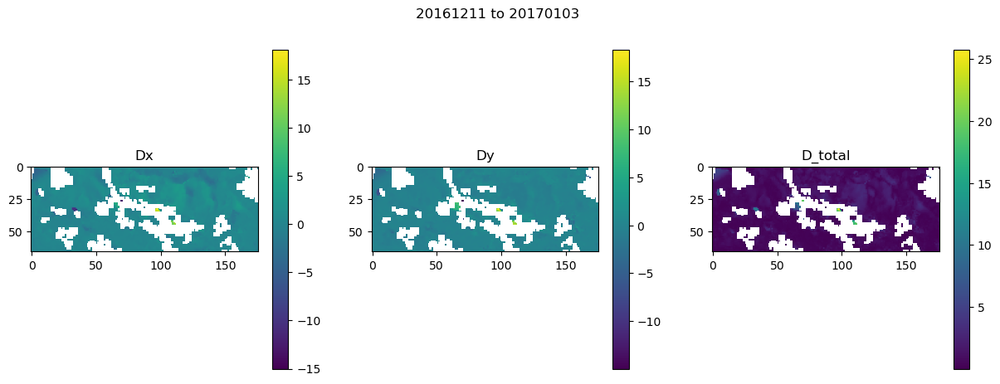

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02042388916015625
LC08_L1TP_062018_20170103_20200905_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20170204_20200905_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

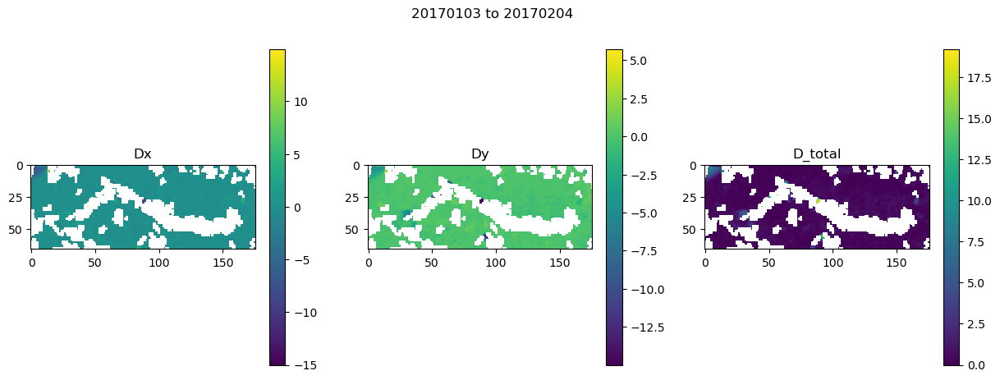

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01929497718811035
LC08_L1TP_062018_20170204_20200905_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20170220_20200905_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

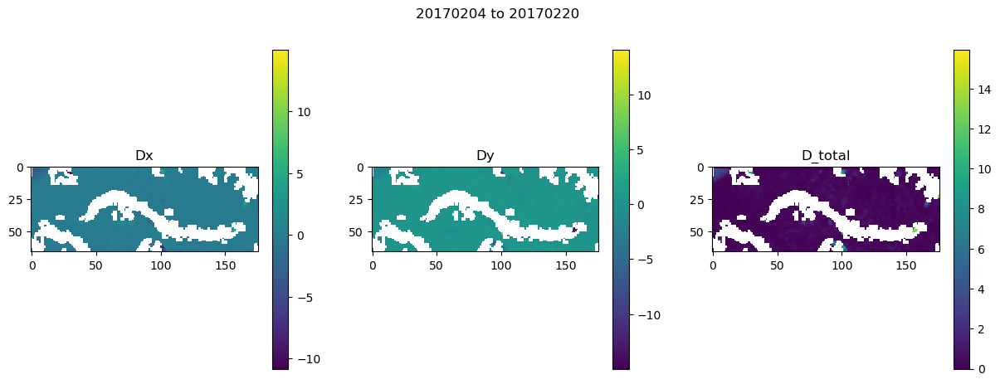

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018301963806152344
LC08_L1TP_062018_20170220_20200905_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20170324_20200904_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

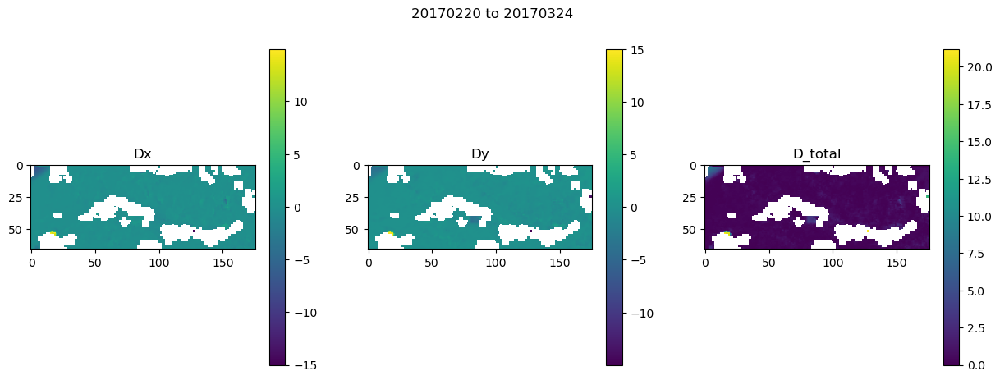

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019566059112548828
20170324 20171221
20170324 20171230
20170324 20180131
20170324 20180207
20170324 20180428
20170324 20180615
20170324 20180903
20170324 20181115
20170324 20190109
20170324 20190118
20170324 20190210
20170324 20190219
20170324 20190226
20170324 20190307
20170324 20190330
20170324 20190415
20170324 20190501
20170324 20190627
20170324 20190713
20170324 20200213
20170324 20200401
20170324 20200417
20170324 20200512
20170324 20200528
20170324 20200731
20170324 20201010
20170324 20201019
20170324 20201120
20170324 20211104
20170324 20220117
20170324 20220202
20170324 20220219
20170324 20220306
20170324 20220415
20170324 20220518
20170324 20220525
20170324 20220526
20170324 20220602
20170324 20220611
20170324 20220626
20170324 20220704
20170324 20220705
20170324 20220729
20170324 20221008
20170324 20221024
20170324 20221025
20170324 20221117
20170324 20221118
20170324

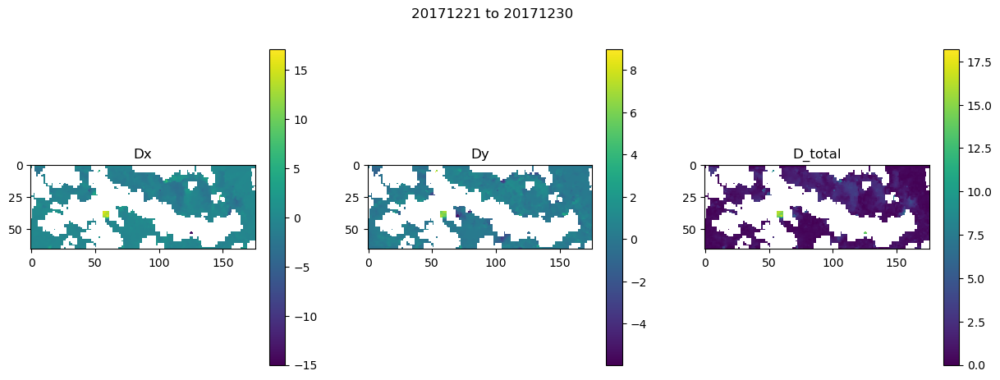

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019487857818603516
LC08_L1TP_061018_20171230_20200902_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20180131_20200902_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

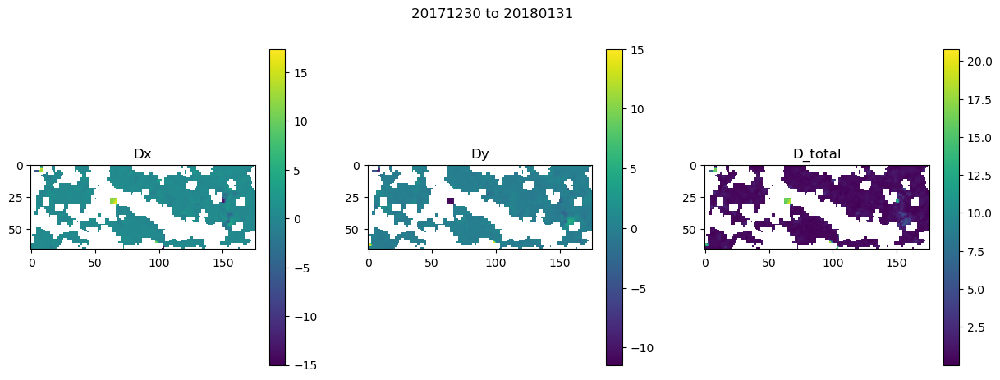

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02070784568786621
LC08_L1TP_061018_20180131_20200902_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20180207_20200902_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

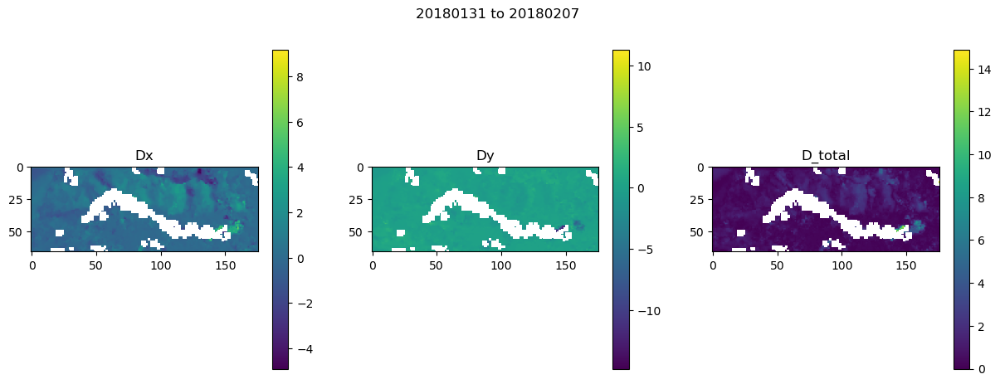

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019273996353149414
20180207 20180615
20180207 20180903
20180207 20181115
20180207 20190109
20180207 20190118
20180207 20190210
20180207 20190219
20180207 20190226
20180207 20190307
20180207 20190330
20180207 20190415
20180207 20190501
20180207 20190627
20180207 20190713
20180207 20200213
20180207 20200401
20180207 20200417
20180207 20200512
20180207 20200528
20180207 20200731
20180207 20201010
20180207 20201019
20180207 20201120
20180207 20211104
20180207 20220117
20180207 20220202
20180207 20220219
20180207 20220306
20180207 20220415
20180207 20220518
20180207 20220525
20180207 20220526
20180207 20220602
20180207 20220611
20180207 20220626
20180207 20220704
20180207 20220705
20180207 20220729
20180207 20221008
20180207 20221024
20180207 20221025
20180207 20221117
20180207 20221118
20180207 20221203
No image pair with correct time separation found. Skip to next.
LC08_L1TP_062018

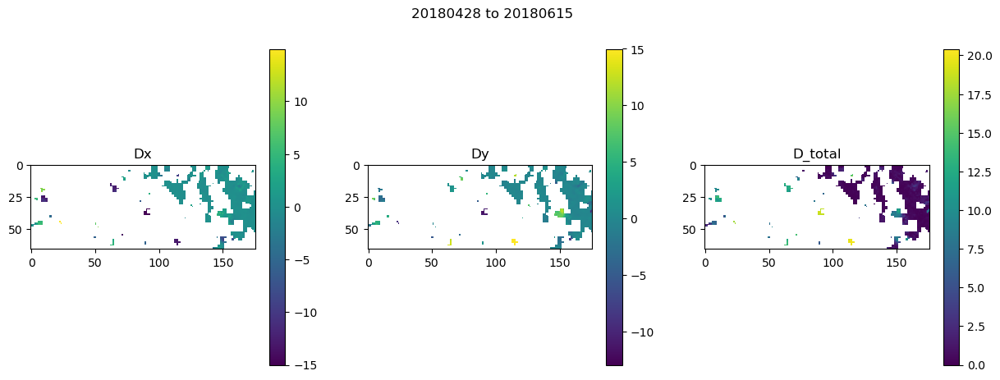

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.028998851776123047
20180615 20181115
20180615 20190109
20180615 20190118
20180615 20190210
20180615 20190219
20180615 20190226
20180615 20190307
20180615 20190330
20180615 20190415
20180615 20190501
20180615 20190627
20180615 20190713
20180615 20200213
20180615 20200401
20180615 20200417
20180615 20200512
20180615 20200528
20180615 20200731
20180615 20201010
20180615 20201019
20180615 20201120
20180615 20211104
20180615 20220117
20180615 20220202
20180615 20220219
20180615 20220306
20180615 20220415
20180615 20220518
20180615 20220525
20180615 20220526
20180615 20220602
20180615 20220611
20180615 20220626
20180615 20220704
20180615 20220705
20180615 20220729
20180615 20221008
20180615 20221024
20180615 20221025
20180615 20221117
20180615 20221118
20180615 20221203
No image pair with correct time separation found. Skip to next.
20180903 20190109
20180903 20190118
20180903 2019021

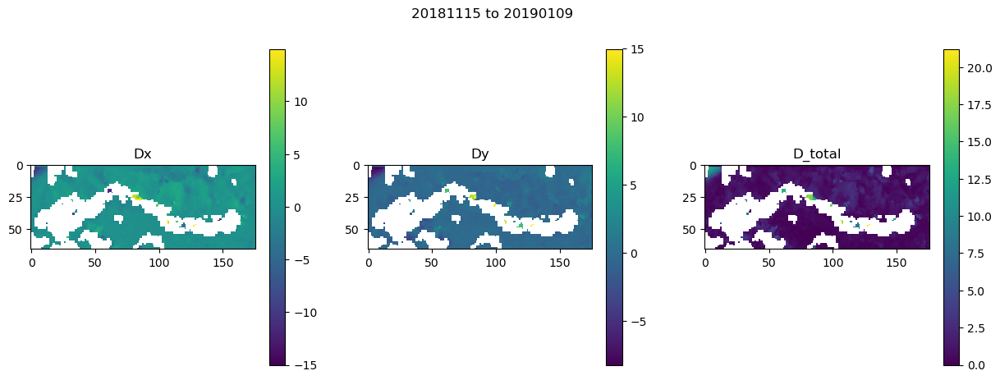

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018732070922851562
LC08_L1TP_062018_20190109_20200830_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20190118_20200830_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

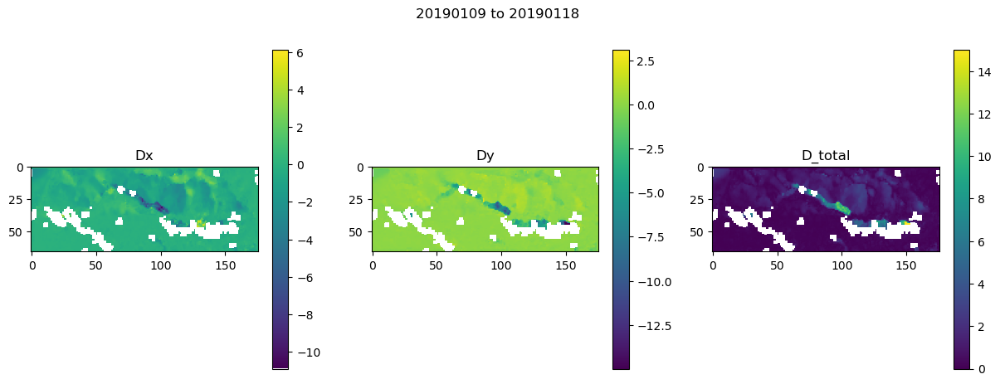

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02359914779663086
LC08_L1TP_061018_20190118_20200830_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20190210_20200829_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1987200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

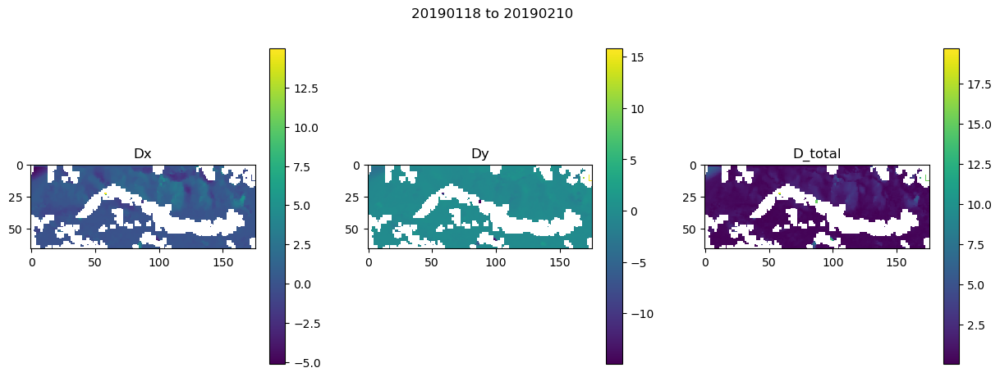

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018471956253051758
LC08_L1TP_062018_20190210_20200829_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20190219_20200829_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

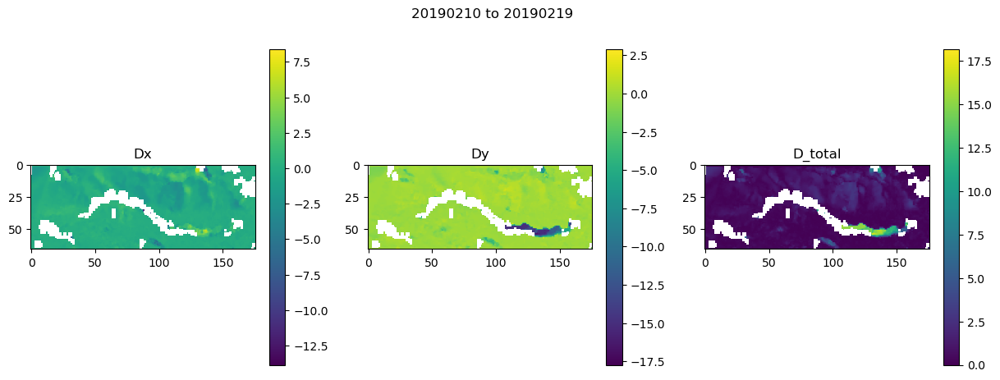

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02766704559326172
LC08_L1TP_061018_20190219_20200829_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20190226_20200829_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

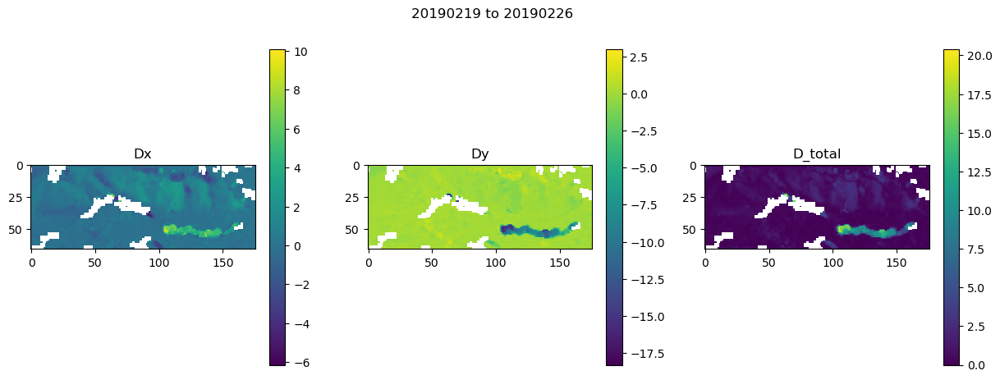

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021126985549926758
LC08_L1TP_062018_20190226_20200829_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20190307_20200829_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

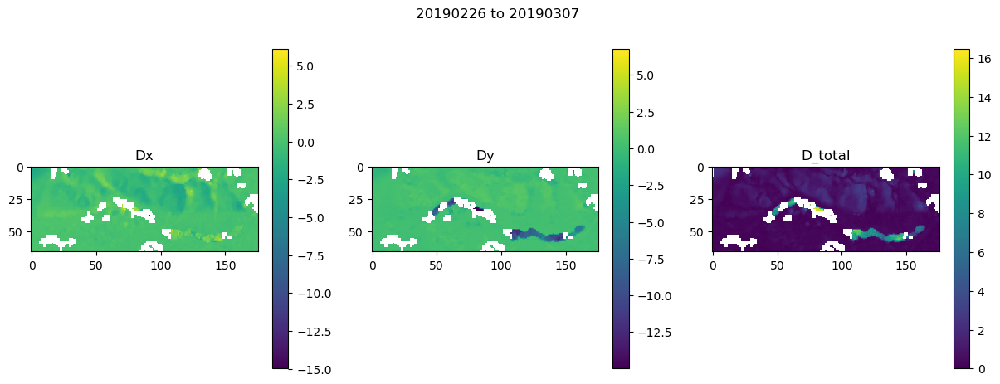

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020083904266357422
LC08_L1TP_061018_20190307_20200829_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20190330_20200829_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1987200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

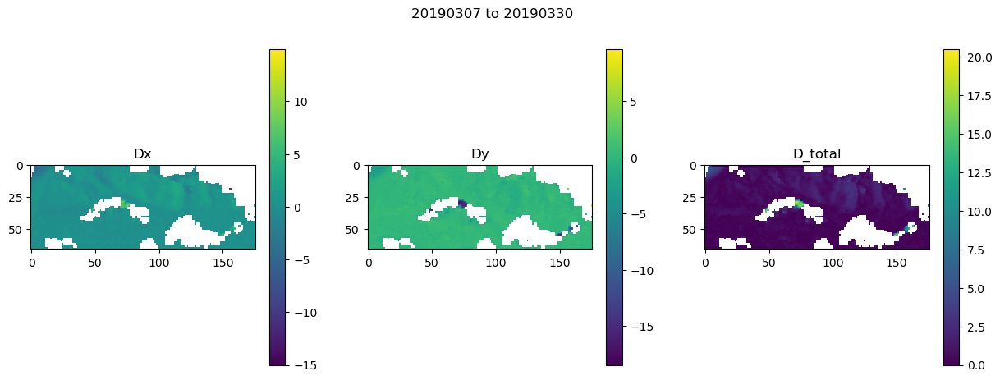

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018960952758789062
LC08_L1TP_062018_20190330_20200829_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20190415_20200829_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

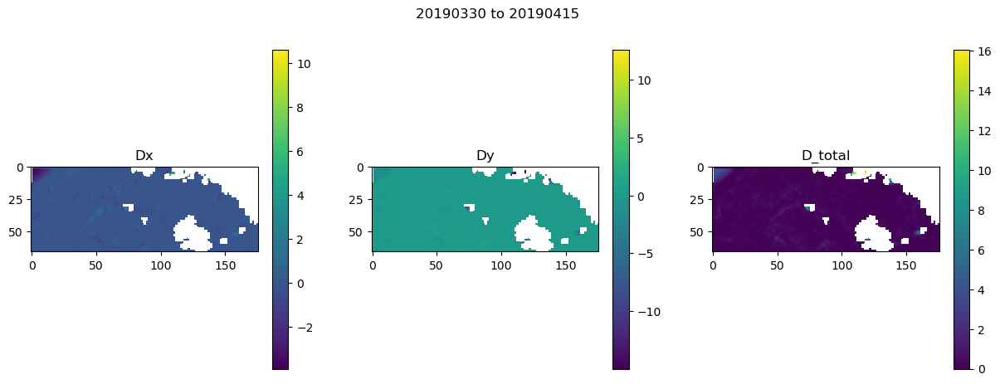

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01859307289123535
LC08_L1TP_062018_20190415_20200829_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20190501_20200829_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

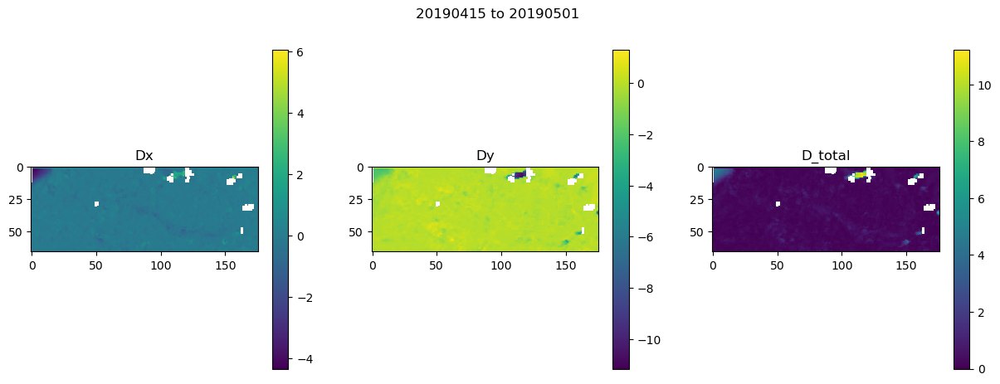

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019008874893188477
LC08_L1TP_062018_20190501_20200829_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20190627_20200827_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 4924800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

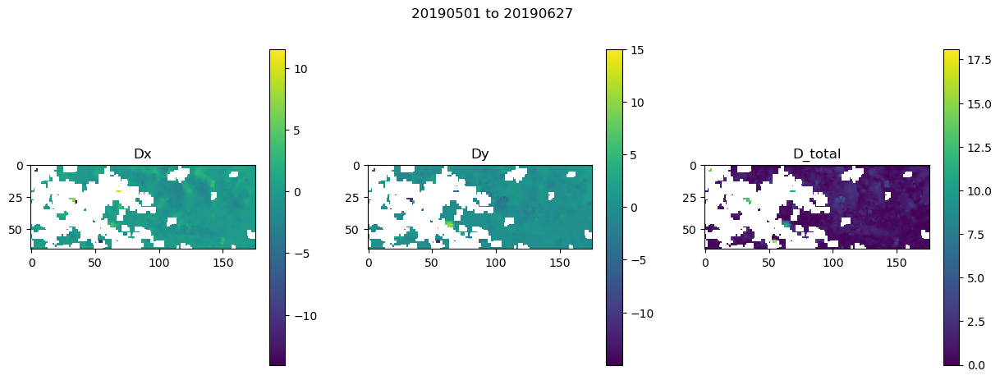

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01884007453918457
LC08_L1TP_061018_20190627_20200827_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20190713_20200827_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

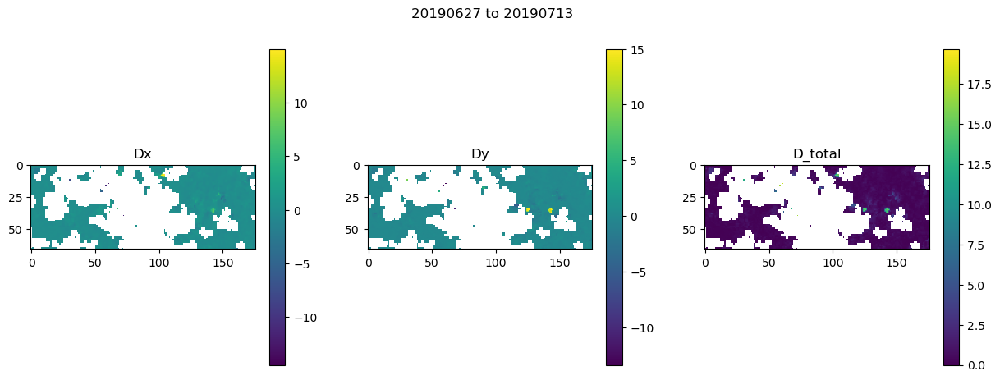

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02118825912475586
20190713 20200401
20190713 20200417
20190713 20200512
20190713 20200528
20190713 20200731
20190713 20201010
20190713 20201019
20190713 20201120
20190713 20211104
20190713 20220117
20190713 20220202
20190713 20220219
20190713 20220306
20190713 20220415
20190713 20220518
20190713 20220525
20190713 20220526
20190713 20220602
20190713 20220611
20190713 20220626
20190713 20220704
20190713 20220705
20190713 20220729
20190713 20221008
20190713 20221024
20190713 20221025
20190713 20221117
20190713 20221118
20190713 20221203
No image pair with correct time separation found. Skip to next.
LC08_L1TP_062018_20200213_20200823_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20200401_20200822_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.


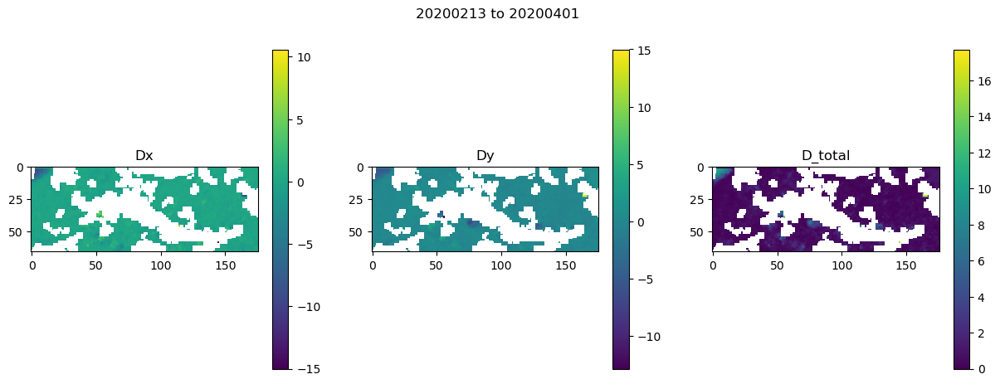

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018747329711914062
LC08_L1TP_062018_20200401_20200822_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20200417_20200822_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

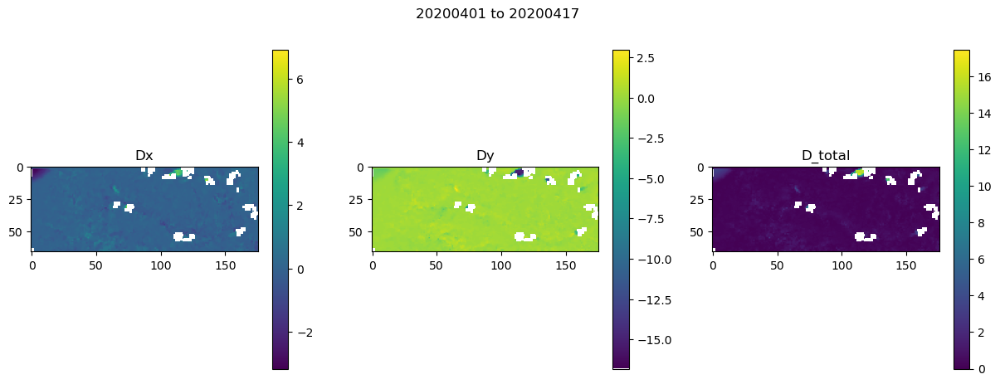

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018935203552246094
LC08_L1TP_062018_20200417_20200822_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20200512_20200820_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

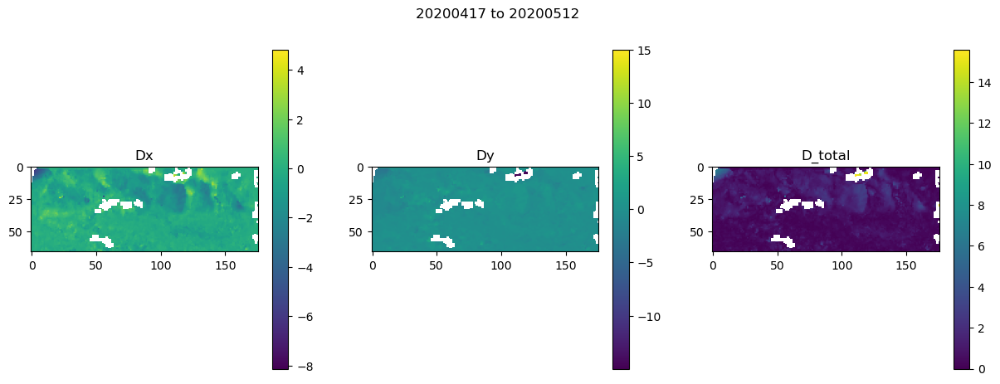

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01897907257080078
LC08_L1TP_061018_20200512_20200820_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20200528_20200820_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

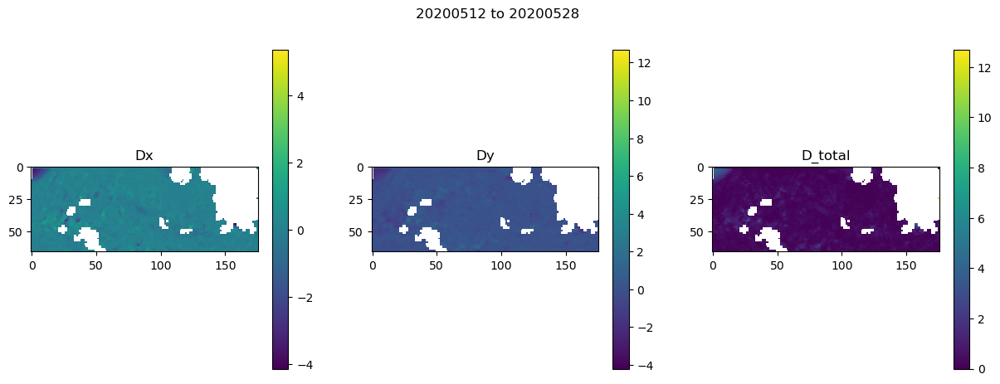

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019746065139770508
20200528 20201010
20200528 20201019
20200528 20201120
20200528 20211104
20200528 20220117
20200528 20220202
20200528 20220219
20200528 20220306
20200528 20220415
20200528 20220518
20200528 20220525
20200528 20220526
20200528 20220602
20200528 20220611
20200528 20220626
20200528 20220704
20200528 20220705
20200528 20220729
20200528 20221008
20200528 20221024
20200528 20221025
20200528 20221117
20200528 20221118
20200528 20221203
No image pair with correct time separation found. Skip to next.
20200731 20201019
20200731 20201120
20200731 20211104
20200731 20220117
20200731 20220202
20200731 20220219
20200731 20220306
20200731 20220415
20200731 20220518
20200731 20220525
20200731 20220526
20200731 20220602
20200731 20220611
20200731 20220626
20200731 20220704
20200731 20220705
20200731 20220729
20200731 20221008
20200731 20221024
20200731 20221025
20200731 2022111

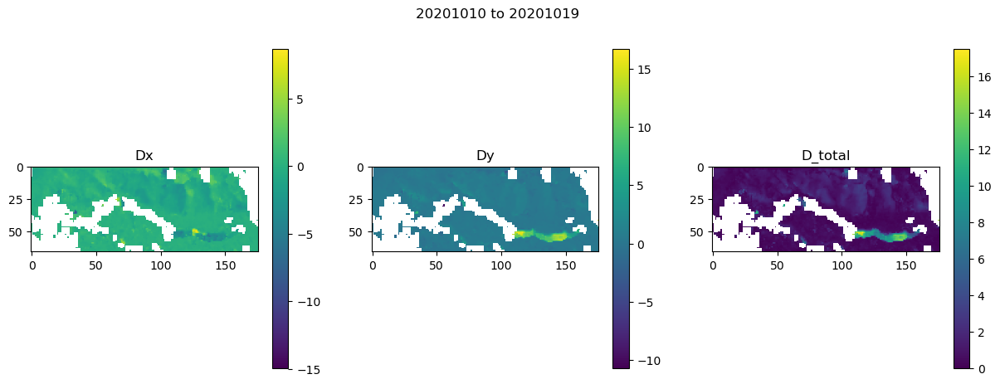

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01891493797302246
LC08_L1TP_061018_20201019_20201105_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20201120_20210314_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

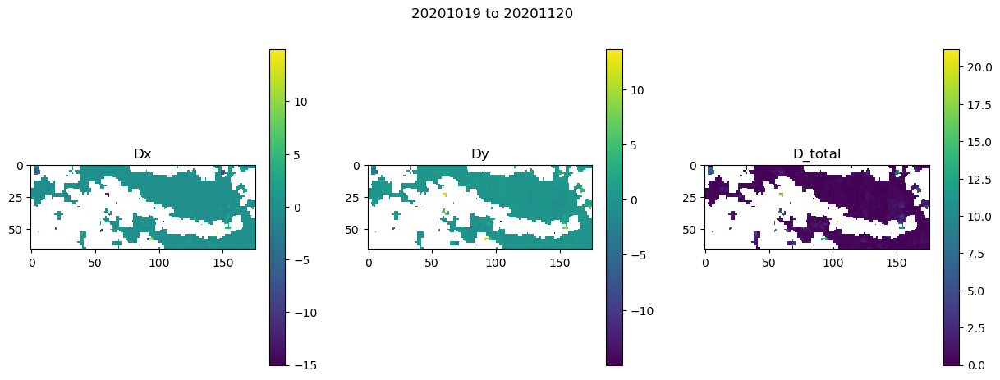

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01894998550415039
20201120 20220117
20201120 20220202
20201120 20220219
20201120 20220306
20201120 20220415
20201120 20220518
20201120 20220525
20201120 20220526
20201120 20220602
20201120 20220611
20201120 20220626
20201120 20220704
20201120 20220705
20201120 20220729
20201120 20221008
20201120 20221024
20201120 20221025
20201120 20221117
20201120 20221118
20201120 20221203
No image pair with correct time separation found. Skip to next.
20211104 20220202
20211104 20220219
20211104 20220306
20211104 20220415
20211104 20220518
20211104 20220525
20211104 20220526
20211104 20220602
20211104 20220611
20211104 20220626
20211104 20220704
20211104 20220705
20211104 20220729
20211104 20221008
20211104 20221024
20211104 20221025
20211104 20221117
20211104 20221118
20211104 20221203
No image pair with correct time separation found. Skip to next.
LC08_L1TP_062018_20220117_20220122_02_T1_B8

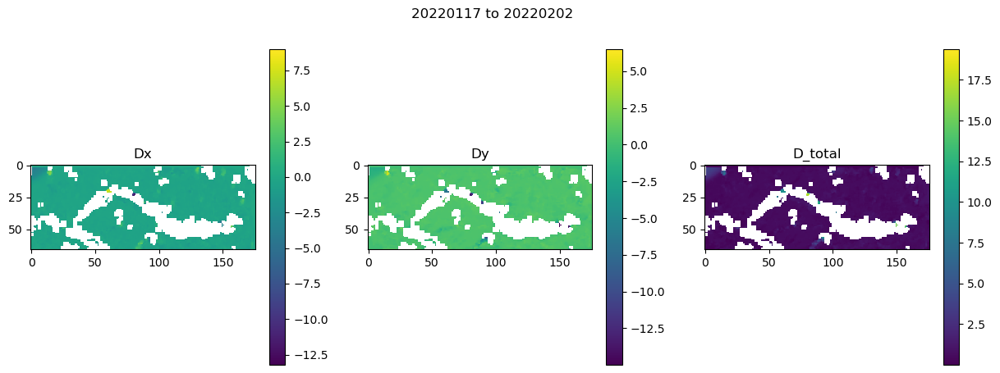

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018658161163330078
LC08_L1TP_062018_20220202_20220211_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_061018_20220219_20230427_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1468800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

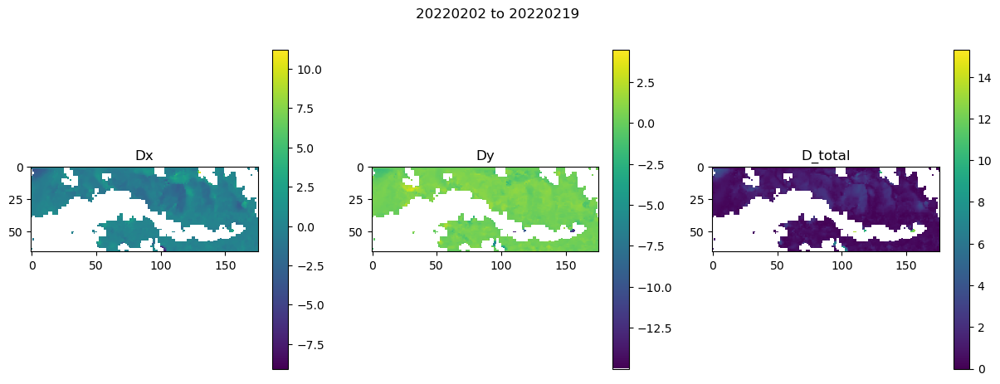

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018897056579589844
LC09_L1TP_061018_20220219_20230427_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20220306_20220314_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

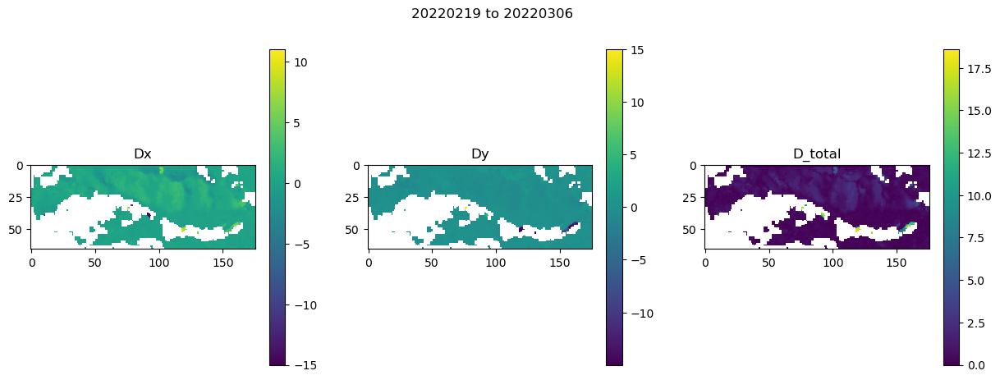

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020415067672729492
LC08_L1TP_062018_20220306_20220314_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_062018_20220415_20230422_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhd

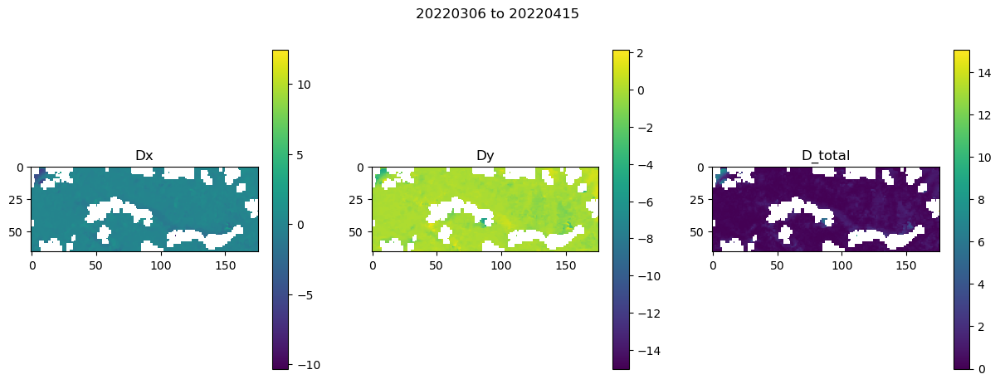

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01947188377380371
LC09_L1TP_062018_20220415_20230422_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_061018_20220518_20220525_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2851200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

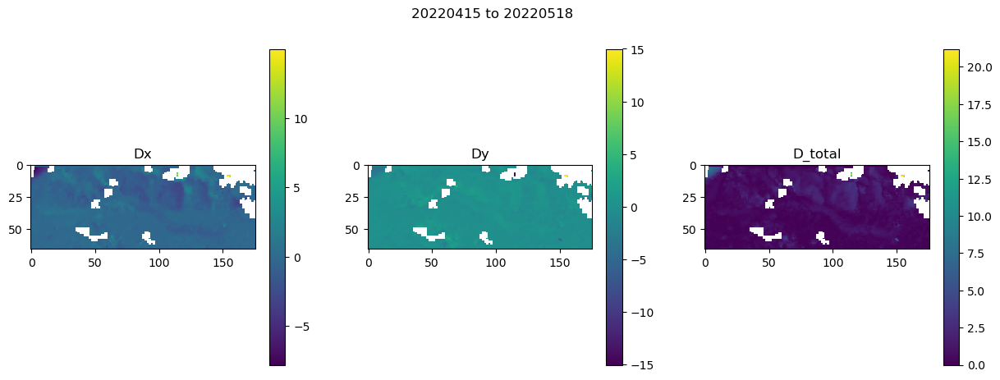

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019317150115966797
LC08_L1TP_061018_20220518_20220525_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20220525_20220602_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

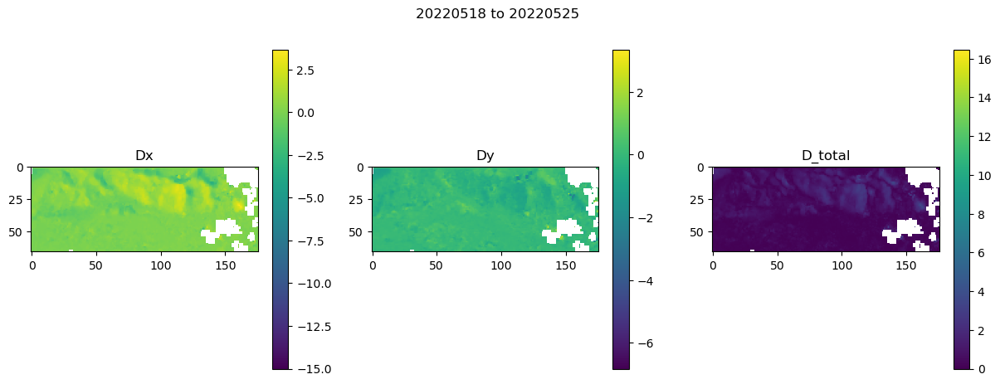

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.028956174850463867
20220525 20220602
LC08_L1TP_062018_20220525_20220602_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_062018_20220602_20230414_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_200709

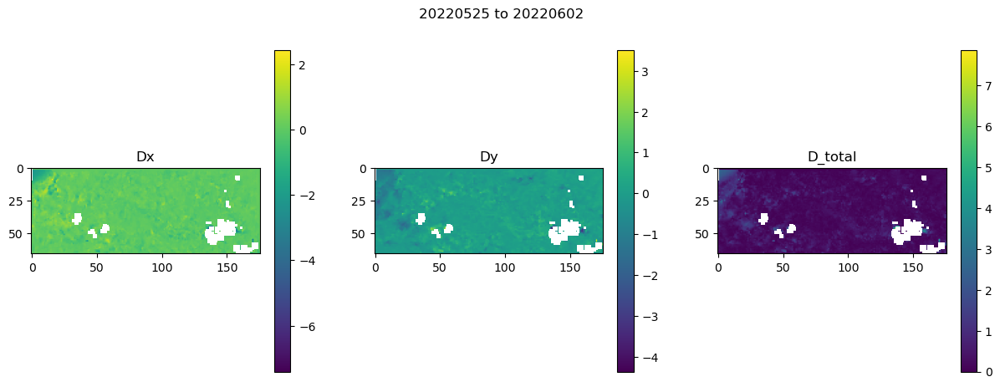

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02010798454284668
LC09_L1TP_062018_20220602_20230414_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_061018_20220611_20230413_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_

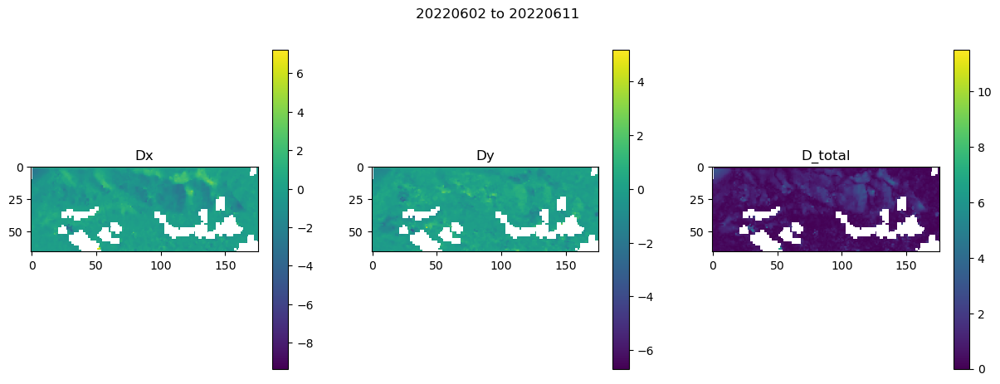

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01868414878845215
LC09_L1TP_061018_20220611_20230413_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20220626_20220706_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

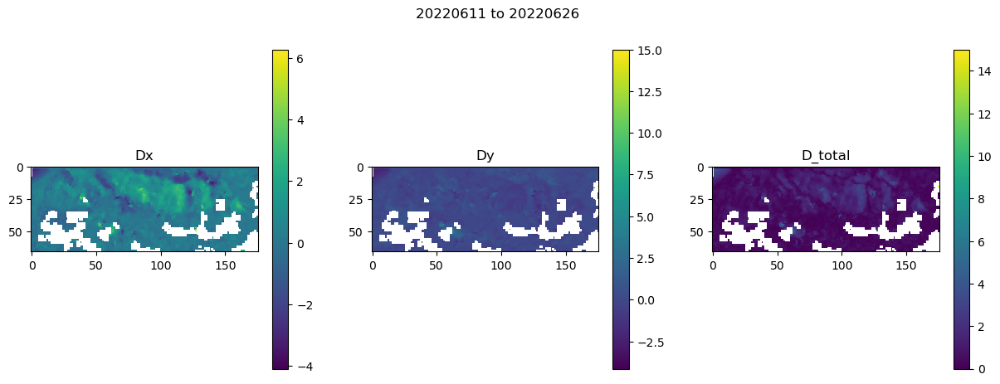

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018709897994995117
LC08_L1TP_062018_20220626_20220706_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_062018_20220704_20230408_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx

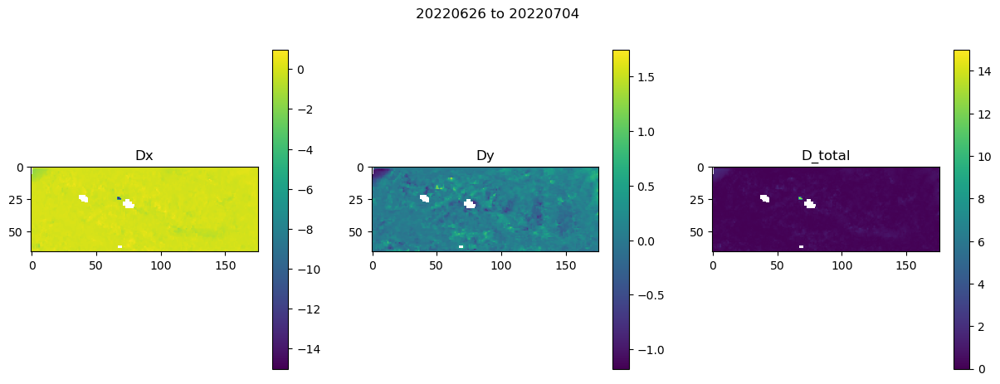

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01884007453918457
20220704 20220729
LC09_L1TP_062018_20220704_20230408_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_061018_20220729_20230405_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_200709

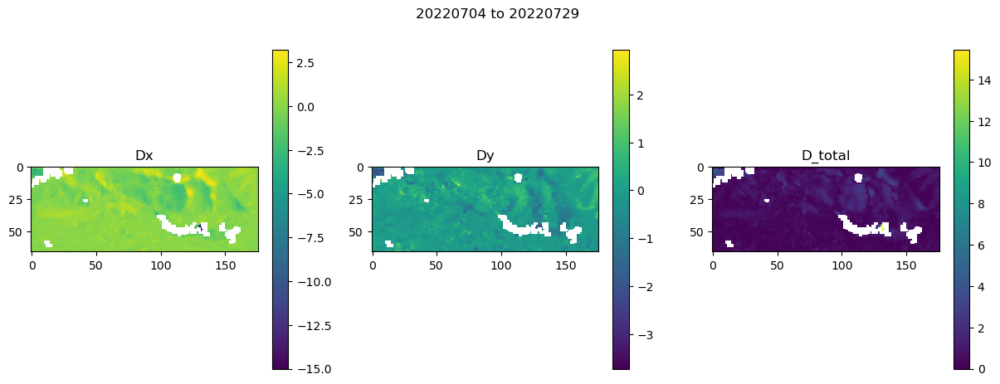

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018990278244018555
20220729 20221024
20220729 20221025
20220729 20221117
20220729 20221118
20220729 20221203
No image pair with correct time separation found. Skip to next.
LC09_L1TP_062018_20221008_20230326_02_T1_B8_BufferVariegated_clipped.TIF LC09_L1TP_062018_20221024_20230324_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/S

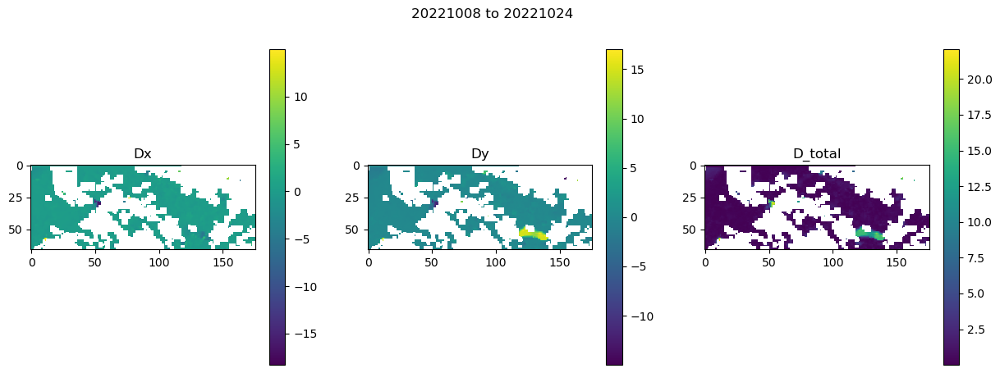

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02058124542236328
20221024 20221117
LC09_L1TP_062018_20221024_20230324_02_T1_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20221117_20221128_02_T2_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 2073600.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_200709

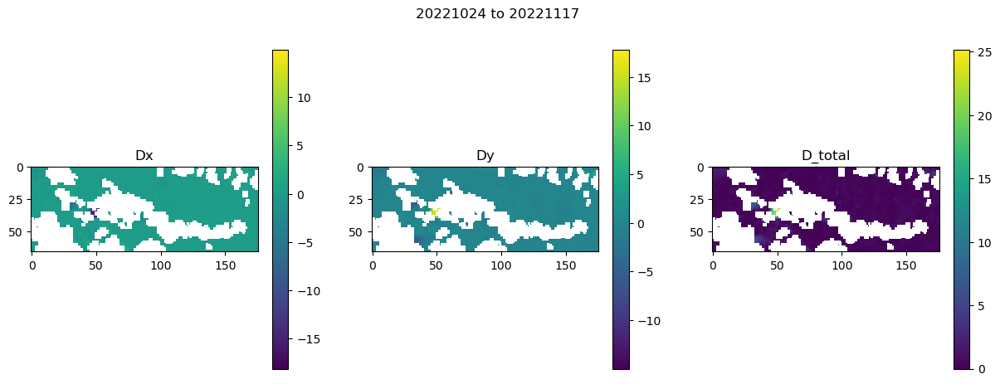

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019095182418823242
20221117 20221203
LC08_L1TP_062018_20221117_20221128_02_T2_B8_BufferVariegated_clipped.TIF LC08_L1TP_062018_20221203_20221212_02_T1_B8_BufferVariegated_clipped.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591232.5  15.0
Y-direction coordinate: 6656587.5  -15.0
Dimensions: 1173  450

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591232.5  608827.5
YLimits: 6649837.5  6656587.5
Extent in km: 17.595  6.75
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070

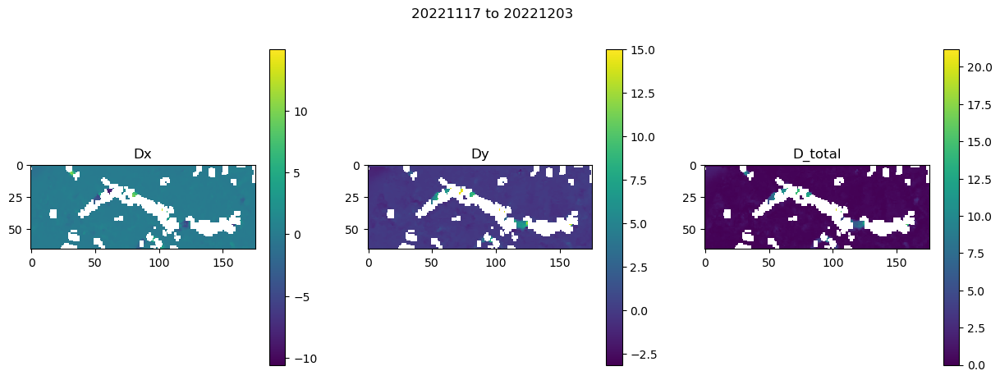

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019357919692993164
Finished searching.
Number of files found: 134
Nolan2021_ASTER_20070903_clipped_5m_100m.tif  already exists.
Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif and Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif already exist.
vx_100m.tif , vy_100m.tif , srx_100m.tif , sry_100m.tif already exist.
20200201 20200211
PS_20200201_clipped.tif PS_20200211_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 

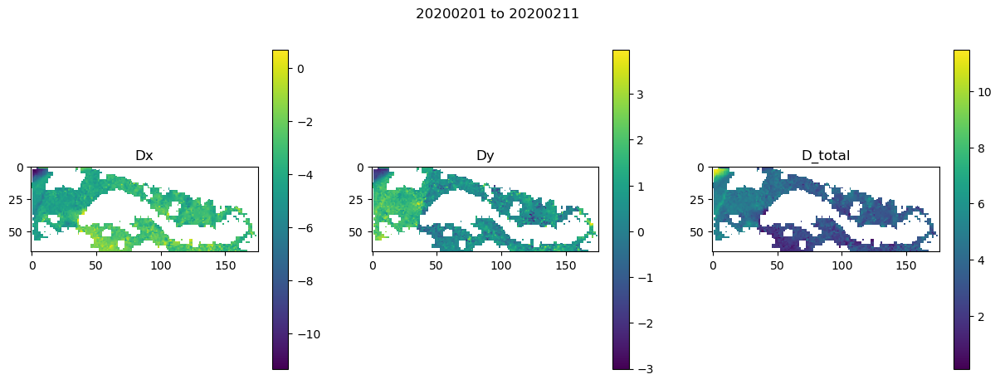

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018723011016845703
20200211 20200224
PS_20200211_clipped.tif PS_20200224_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1123200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m

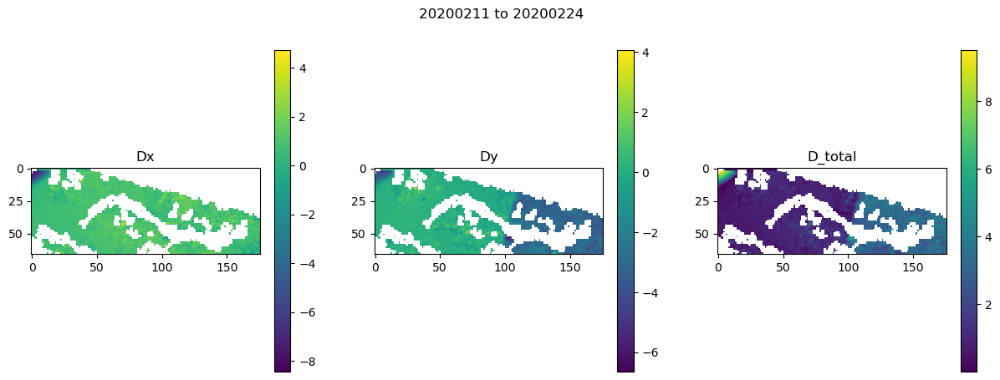

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019069910049438477
PS_20200224_clipped.tif PS_20200301_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

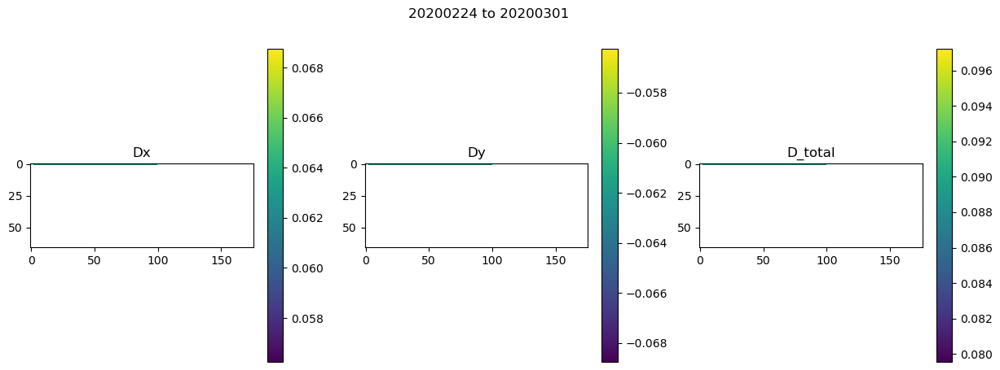

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019155025482177734
PS_20200301_clipped.tif PS_20200306_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

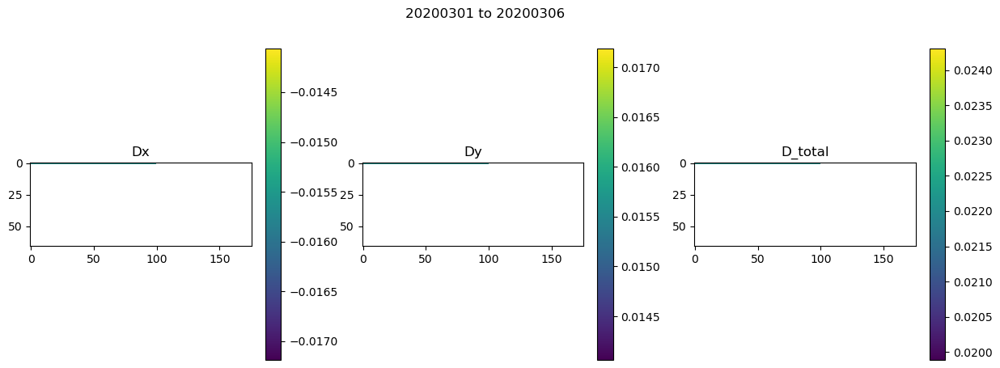

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01926898956298828
PS_20200306_clipped.tif PS_20200311_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

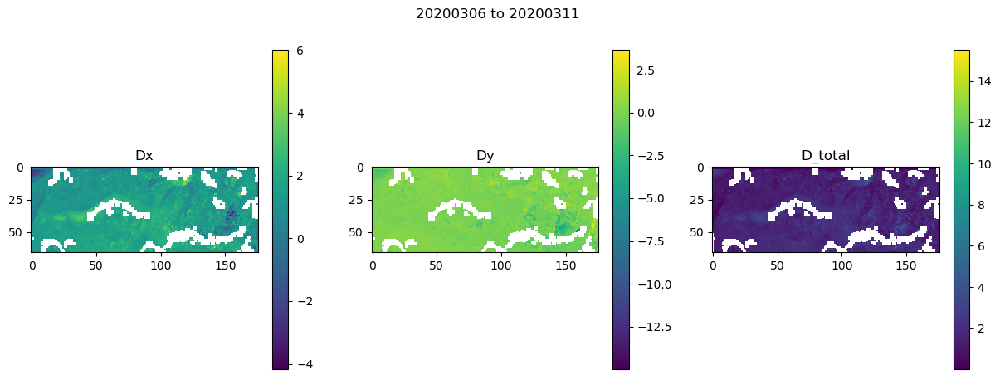

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021255970001220703
20200311 20200314
20200311 20200315
20200311 20200317
PS_20200311_clipped.tif PS_20200317_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/

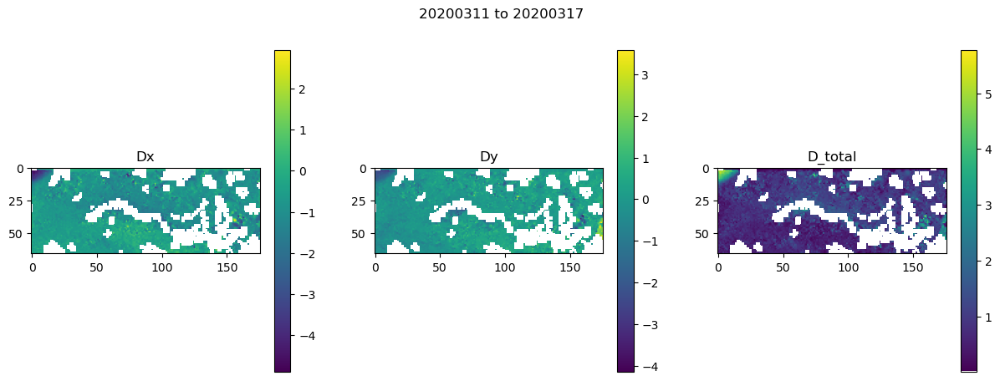

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01881122589111328
PS_20200317_clipped.tif PS_20200324_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

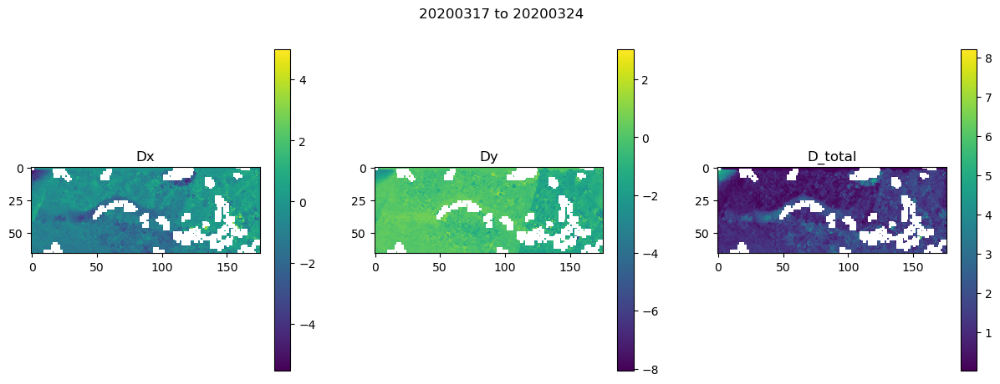

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019105911254882812
20200324 20200328
20200324 20200329
PS_20200324_clipped.tif PS_20200329_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20

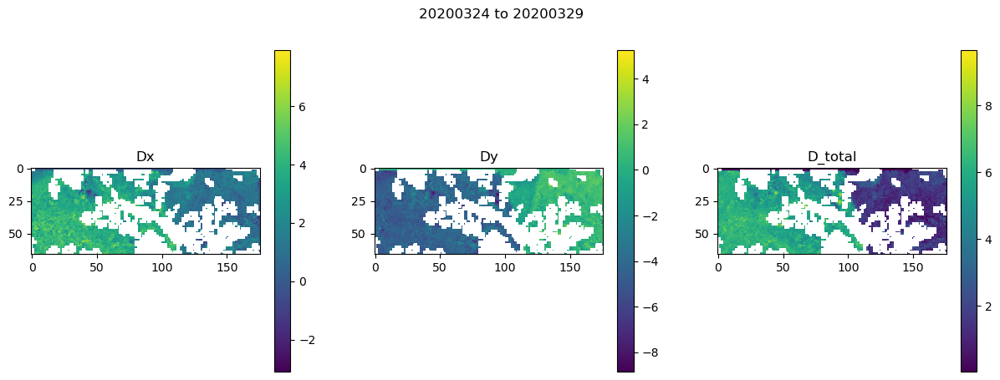

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01967597007751465
20200329 20200331
20200329 20200401
20200329 20200402
20200329 20200405
PS_20200329_clipped.tif PS_20200405_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/V

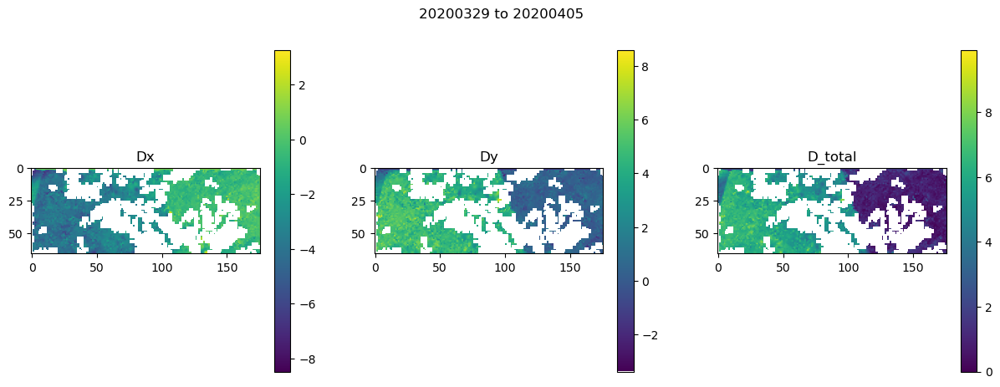

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01952219009399414
PS_20200405_clipped.tif PS_20200410_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

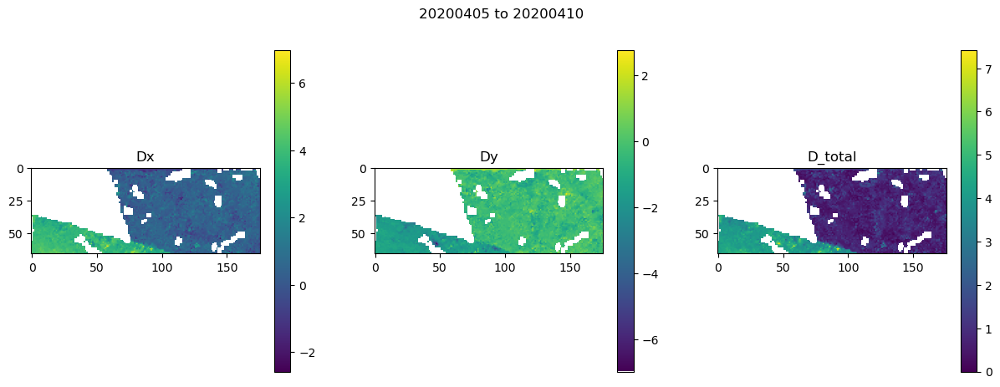

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02006220817565918
PS_20200410_clipped.tif PS_20200418_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

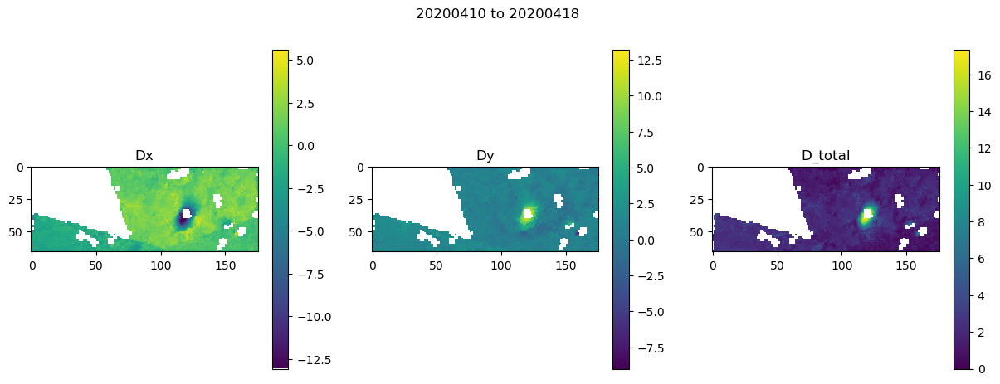

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019743919372558594
20200418 20200507
PS_20200418_clipped.tif PS_20200507_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1641600.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m

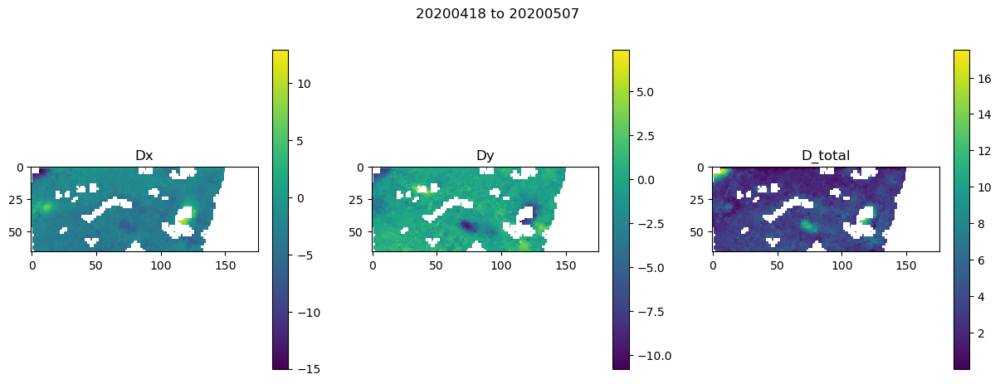

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023038864135742188
20200507 20200512
PS_20200507_clipped.tif PS_20200512_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

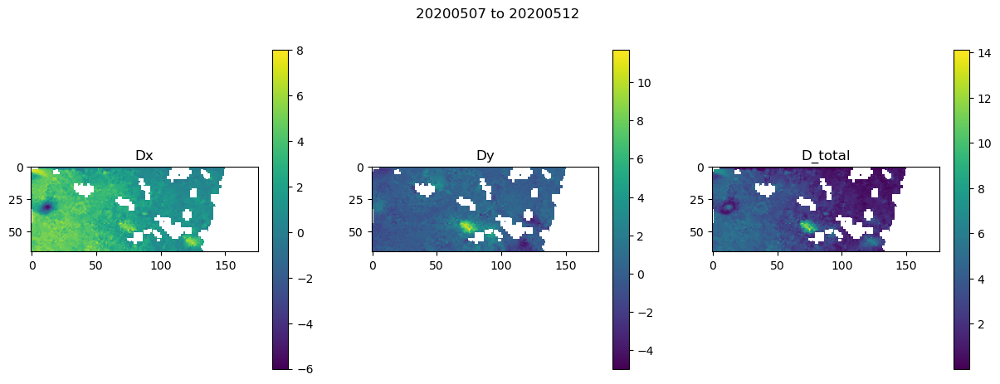

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020294189453125
20200512 20200516
20200512 20200517
PS_20200512_clipped.tif PS_20200517_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070

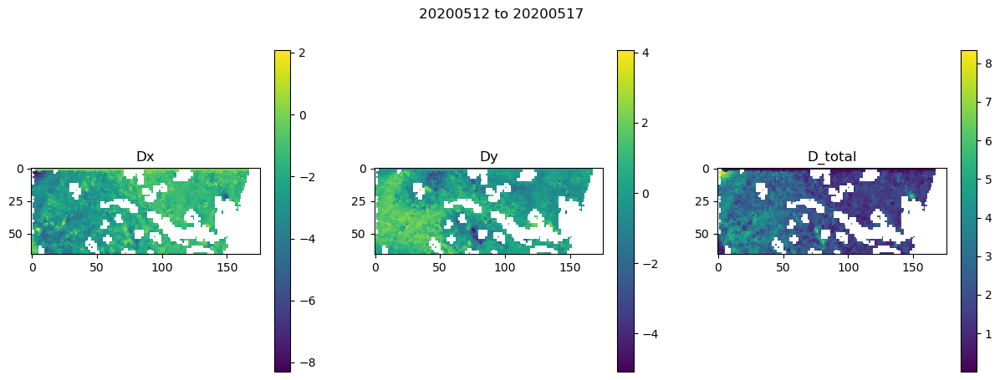

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019833087921142578
20200517 20200522
PS_20200517_clipped.tif PS_20200522_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

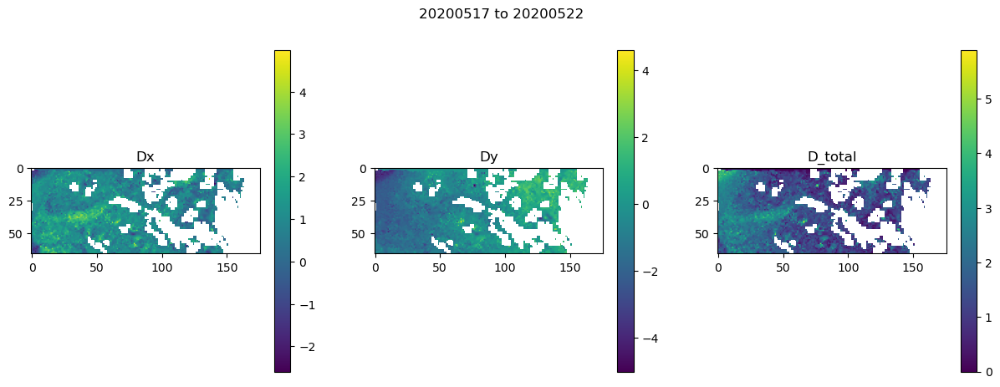

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021432876586914062
PS_20200522_clipped.tif PS_20200528_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

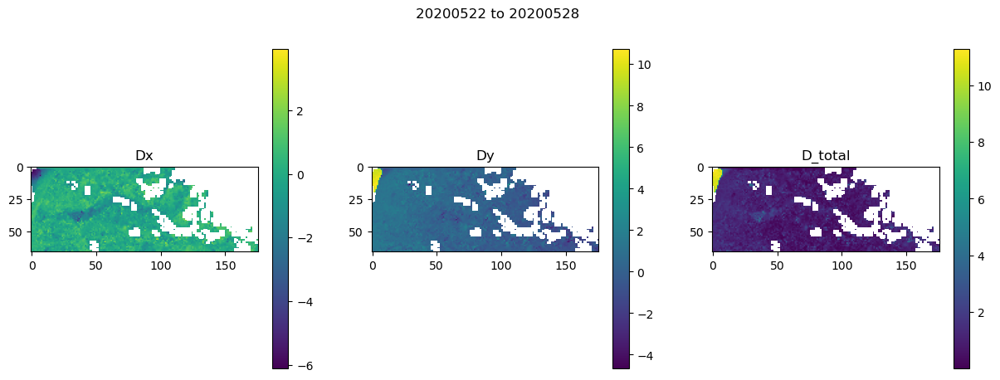

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020441055297851562
20200528 20200604
PS_20200528_clipped.tif PS_20200604_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

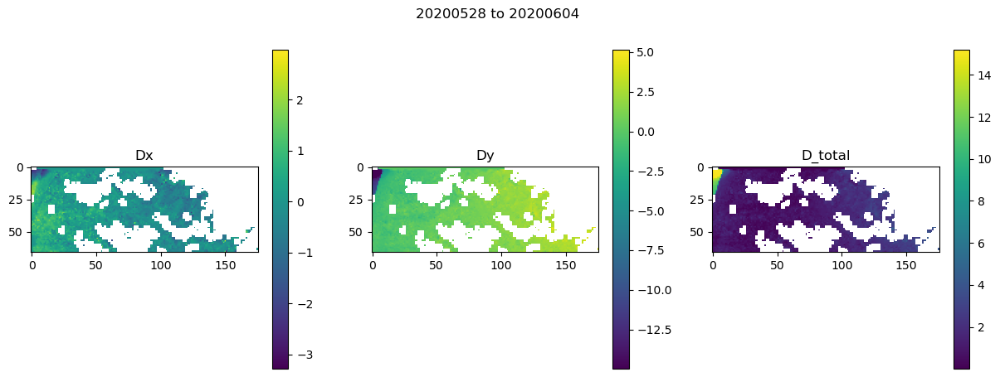

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019377946853637695
20200604 20200609
PS_20200604_clipped.tif PS_20200609_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

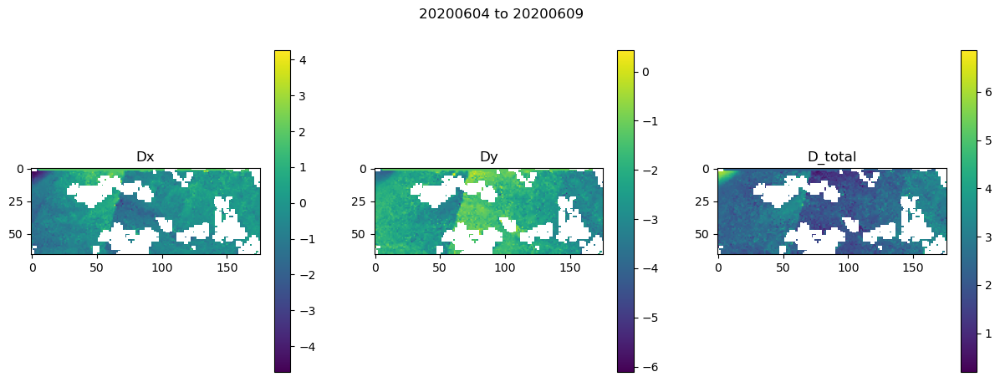

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019475936889648438
20200609 20200701
PS_20200609_clipped.tif PS_20200701_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1900800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m

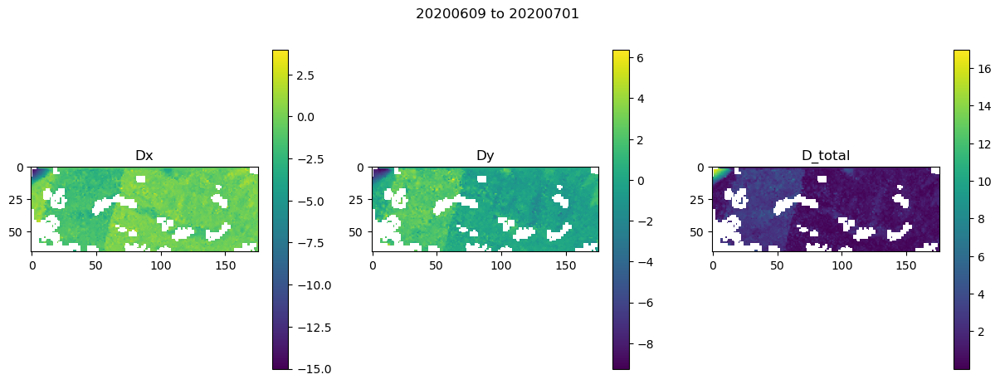

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019758224487304688
20200701 20200703
20200701 20200716
PS_20200701_clipped.tif PS_20200716_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_2

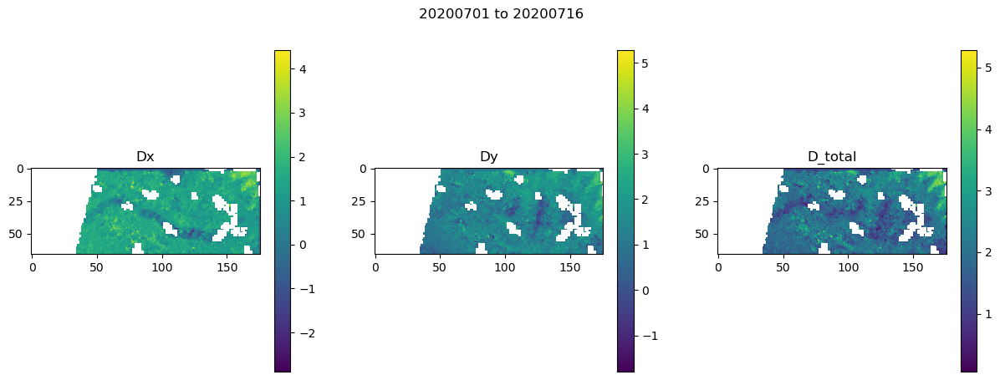

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020031213760375977
PS_20200716_clipped.tif PS_20200723_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

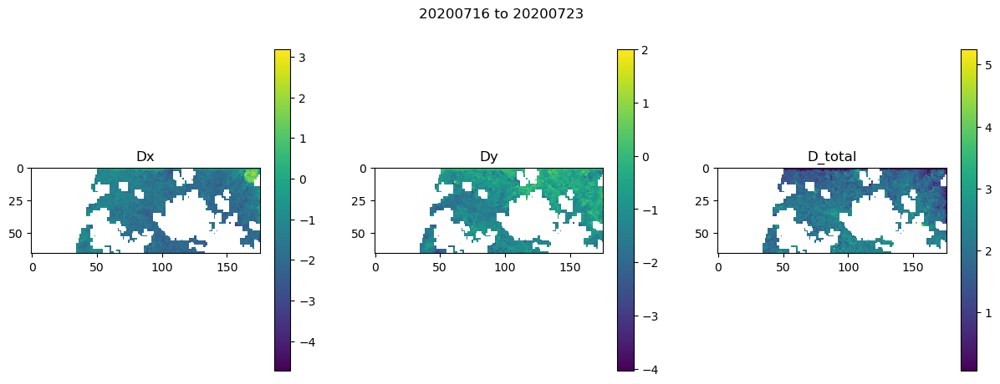

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019137144088745117
PS_20200723_clipped.tif PS_20200729_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

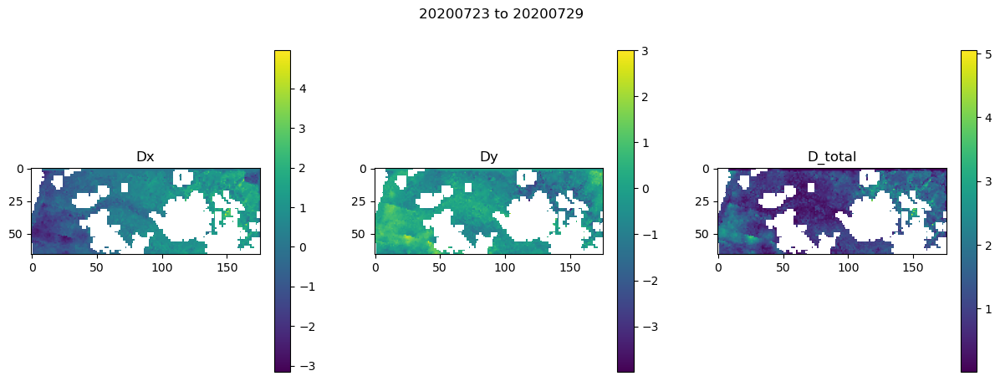

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0239410400390625
20200729 20200905
PS_20200729_clipped.tif PS_20200905_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3283200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_d

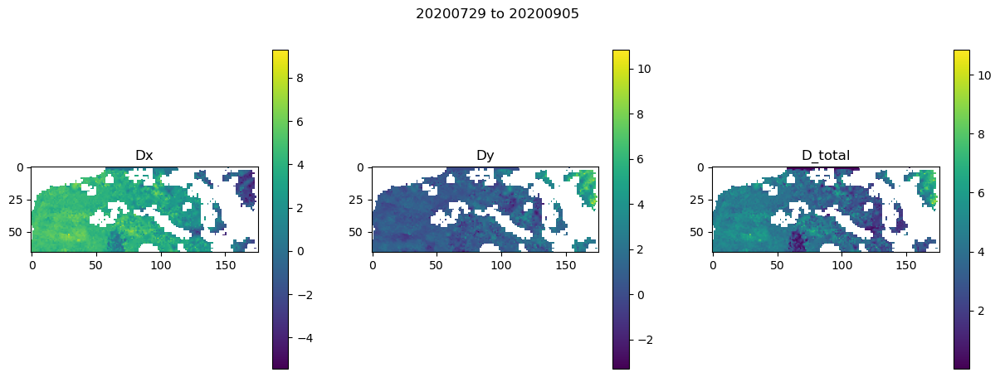

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02144789695739746
20200905 20200912
PS_20200905_clipped.tif PS_20200912_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_d

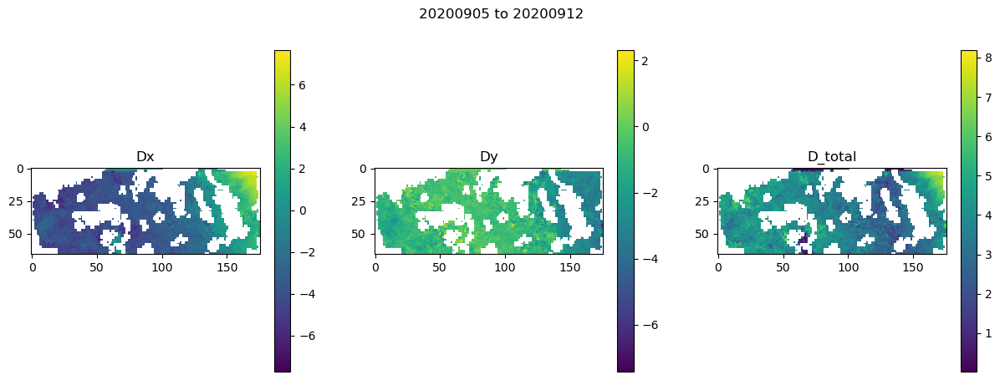

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019060134887695312
20200912 20200914
20200912 20200915
20200912 20201001
PS_20200912_clipped.tif PS_20201001_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1641600.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input

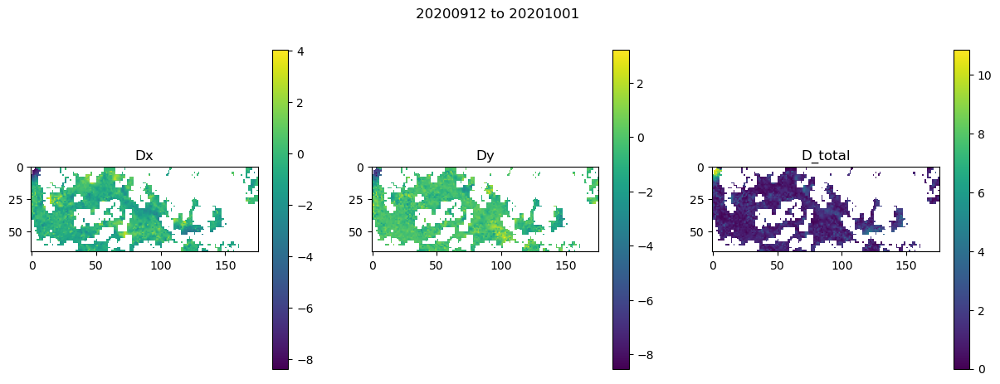

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019346952438354492
PS_20201001_clipped.tif PS_20201013_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Ou

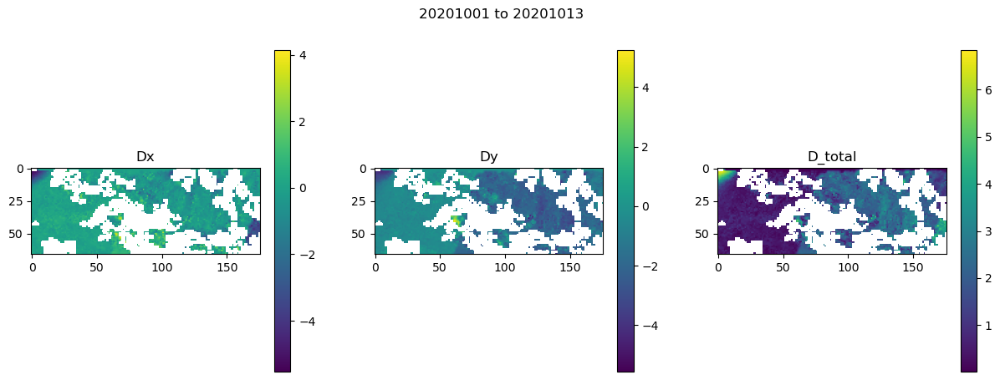

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019201040267944336
20201013 20201020
PS_20201013_clipped.tif PS_20201020_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

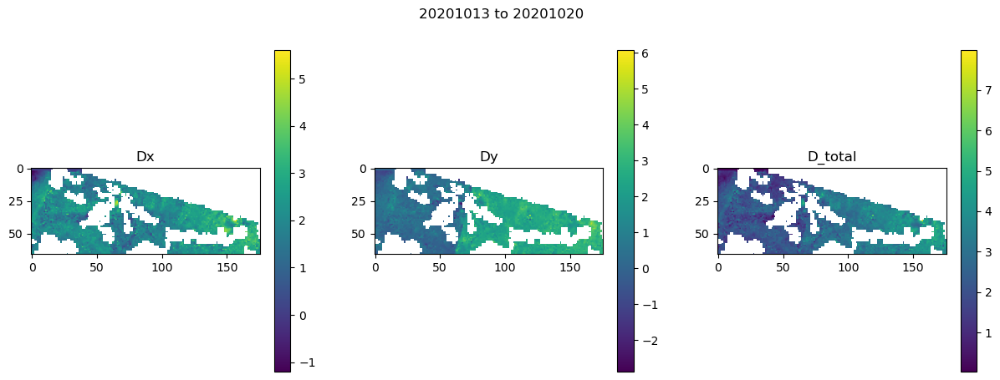

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018858909606933594
20201020 20201022
20201020 20201023
20201020 20201101
PS_20201020_clipped.tif PS_20201101_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input

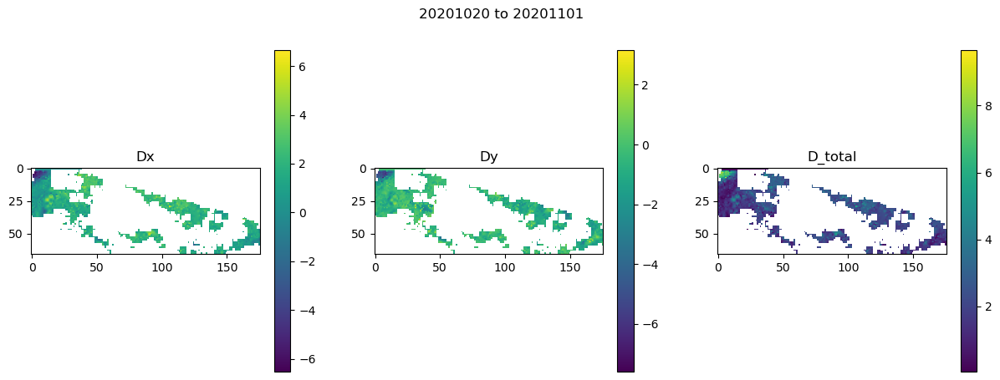

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020093917846679688
20201101 20201107
PS_20201101_clipped.tif PS_20201107_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

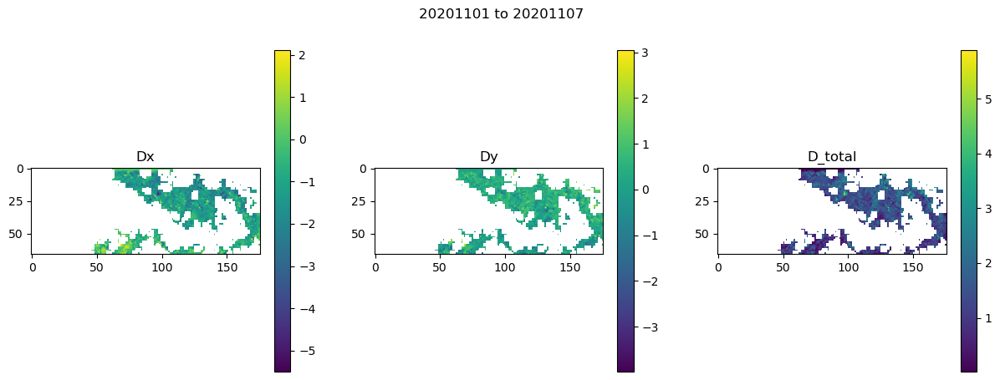

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019696950912475586
PS_20201107_clipped.tif PS_20201120_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1123200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Ou

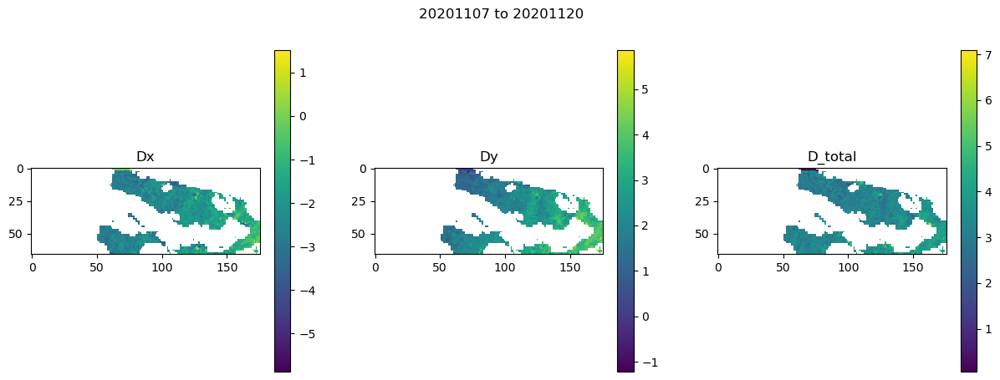

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01908707618713379
20201120 20210126
20201120 20210127
20201120 20210131
20201120 20210202
20201120 20210203
20201120 20210210
20201120 20210211
20201120 20210212
20201120 20210213
20201120 20210214
20201120 20210215
20201120 20210303
20201120 20210305
20201120 20210307
20201120 20210309
20201120 20210312
20201120 20210313
20201120 20210319
20201120 20210402
20201120 20210407
20201120 20210415
20201120 20210418
20201120 20210422
20201120 20210425
20201120 20210426
20201120 20210503
20201120 20210519
20201120 20210525
20201120 20210608
20201120 20210609
20201120 20210610
20201120 20210612
20201120 20210622
20201120 20210627
20201120 20210701
20201120 20210702
20201120 20210703
20201120 20210705
20201120 20210716
20201120 20210717
20201120 20210719
20201120 20210720
20201120 20210721
20201120 20210726
20201120 20210730
20201120 20210731
20201120 20210801
20201120 20210803
20201120 

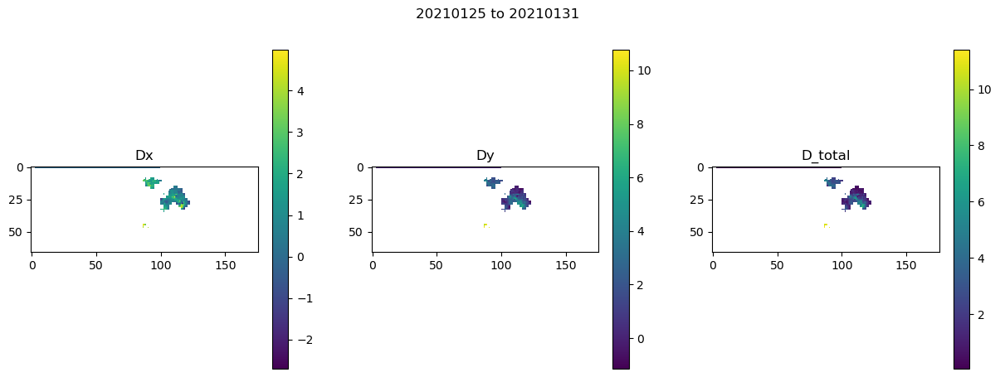

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01913762092590332
20210131 20210203
20210131 20210210
PS_20210131_clipped.tif PS_20210210_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_200

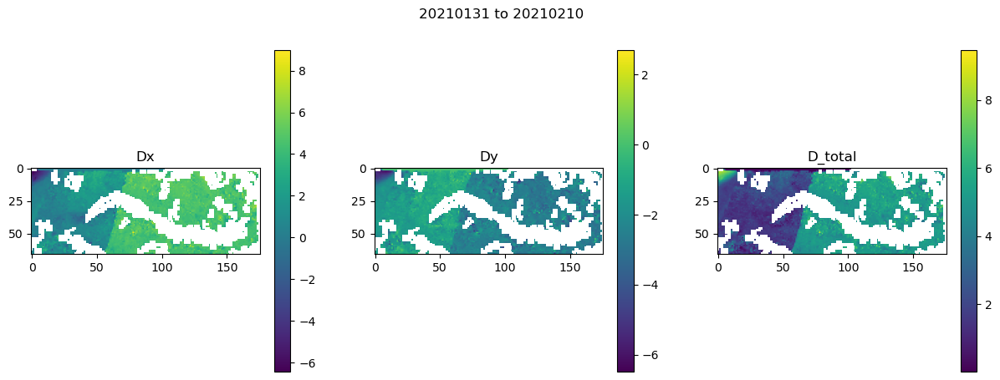

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0192868709564209
20210210 20210212
20210210 20210213
20210210 20210214
20210210 20210215
PS_20210210_clipped.tif PS_20210215_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG

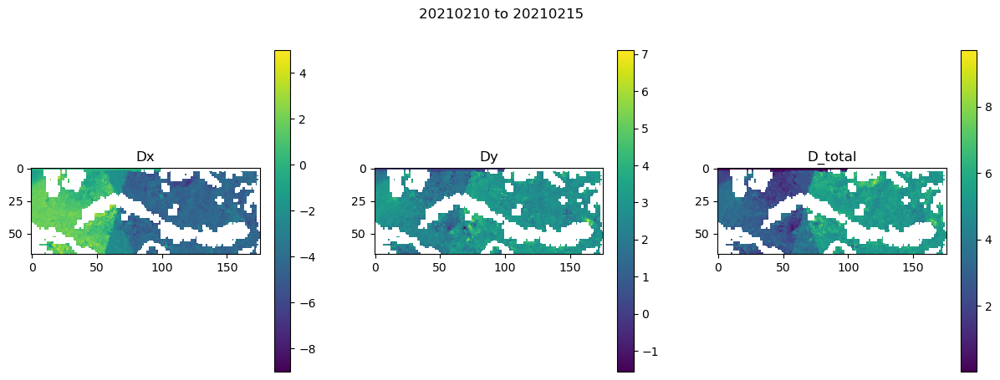

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019613981246948242
PS_20210215_clipped.tif PS_20210303_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Ou

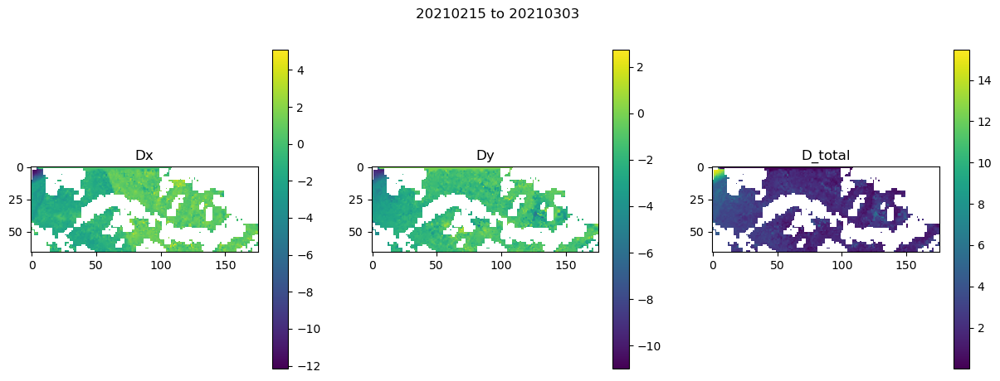

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019443988800048828
20210303 20210307
20210303 20210309
PS_20210303_clipped.tif PS_20210309_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20

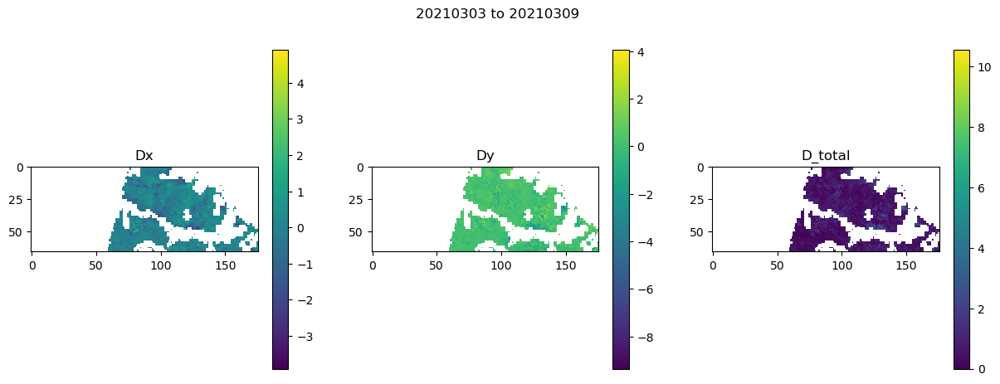

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019122838973999023
20210309 20210313
20210309 20210319
PS_20210309_clipped.tif PS_20210319_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20

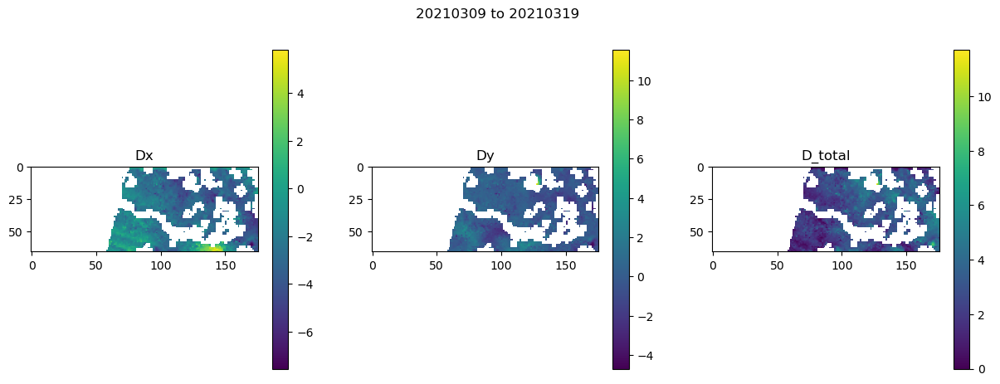

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019144058227539062
PS_20210319_clipped.tif PS_20210402_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1209600.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Ou

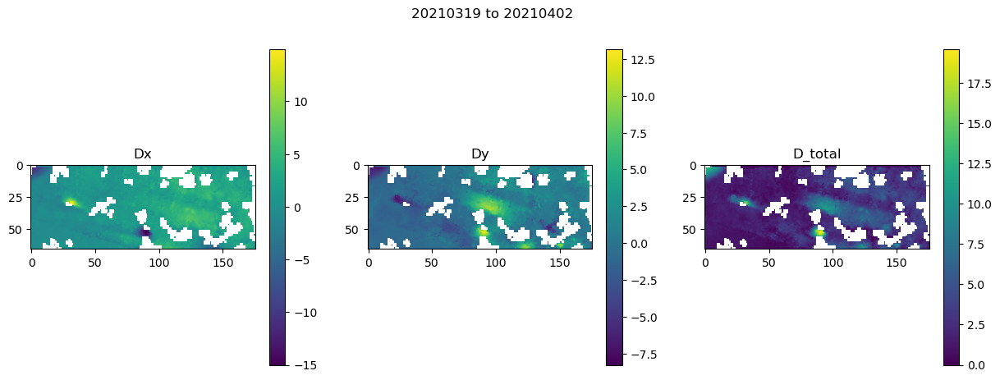

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020687103271484375
PS_20210402_clipped.tif PS_20210407_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

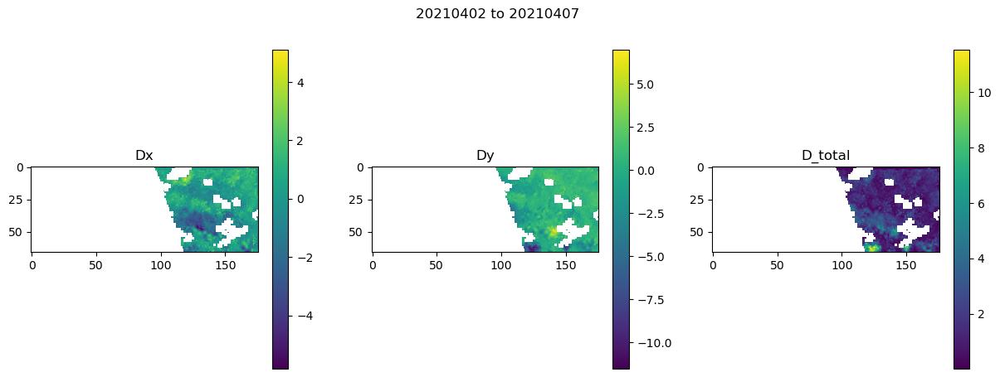

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019370079040527344
PS_20210407_clipped.tif PS_20210415_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

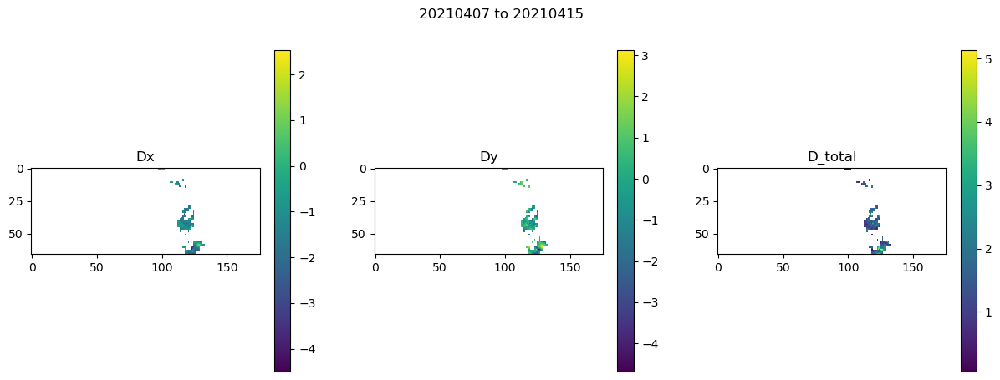

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019032716751098633
20210415 20210422
PS_20210415_clipped.tif PS_20210422_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

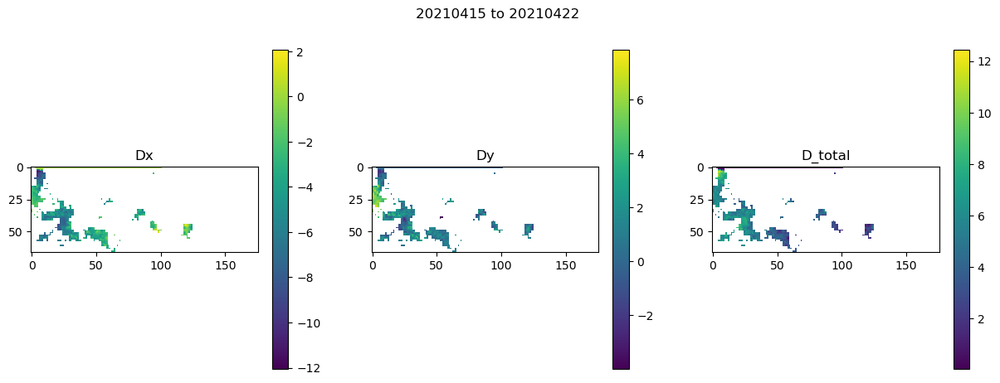

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01885986328125
20210422 20210426
20210422 20210503
PS_20210422_clipped.tif PS_20210503_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 950400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_200709

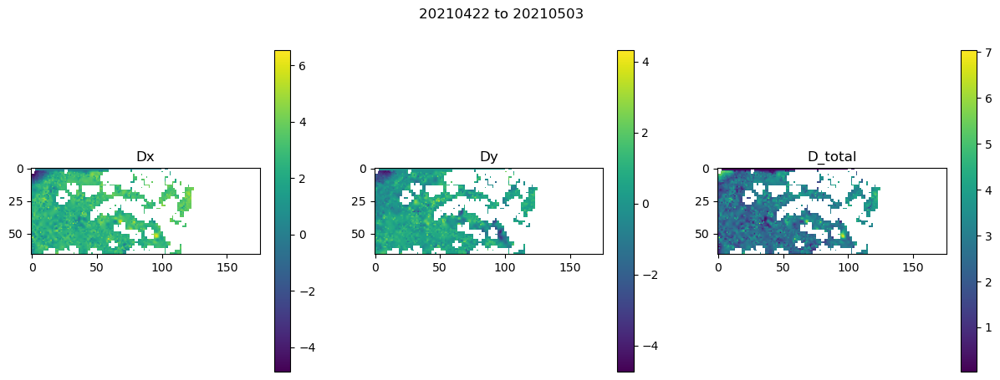

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020005226135253906
PS_20210503_clipped.tif PS_20210519_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Ou

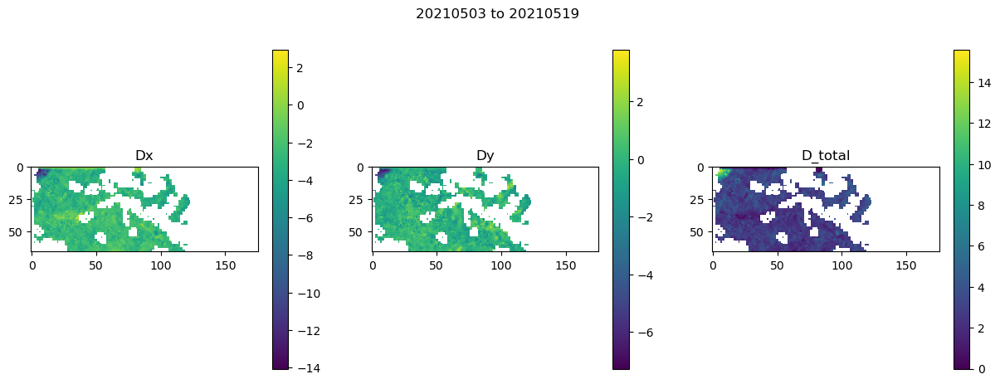

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01923680305480957
PS_20210519_clipped.tif PS_20210525_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

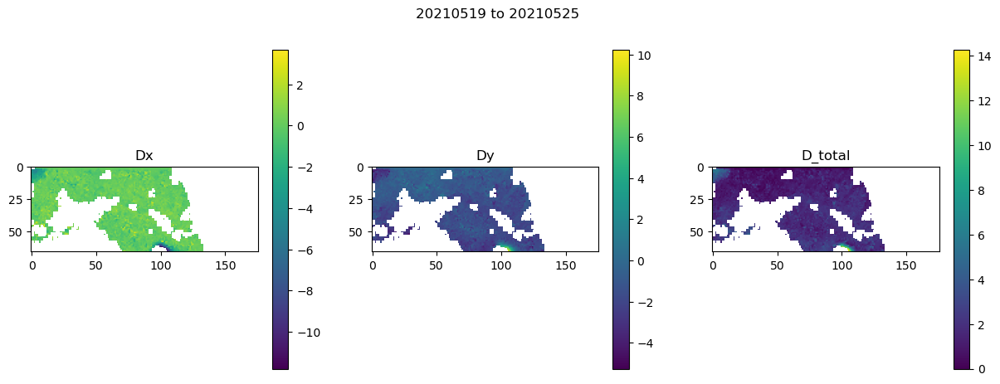

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01909494400024414
PS_20210525_clipped.tif PS_20210608_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1209600.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

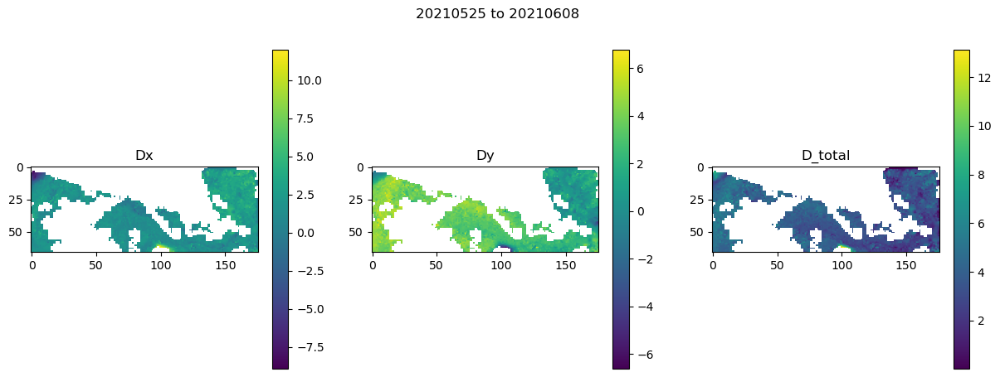

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024029970169067383
20210608 20210610
20210608 20210612
20210608 20210622
PS_20210608_clipped.tif PS_20210622_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1209600.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input

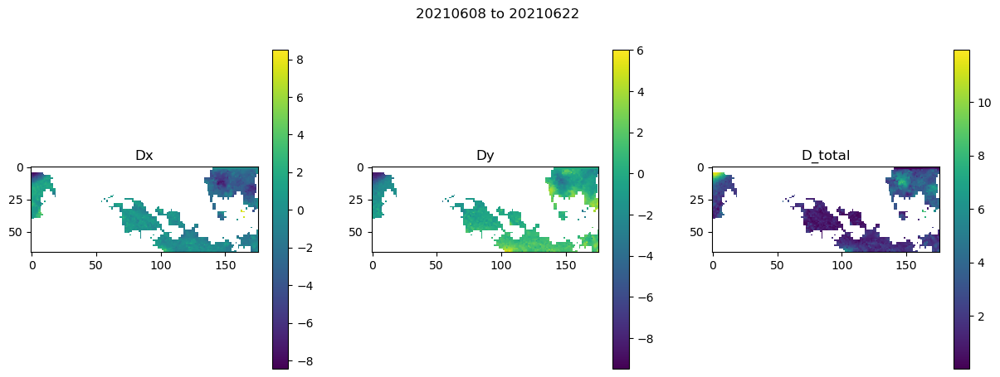

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019304990768432617
PS_20210622_clipped.tif PS_20210627_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

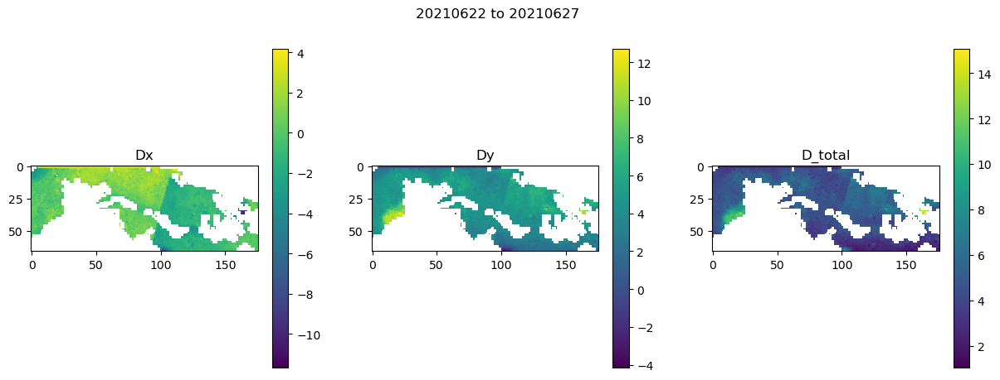

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01879596710205078
20210627 20210702
PS_20210627_clipped.tif PS_20210702_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_d

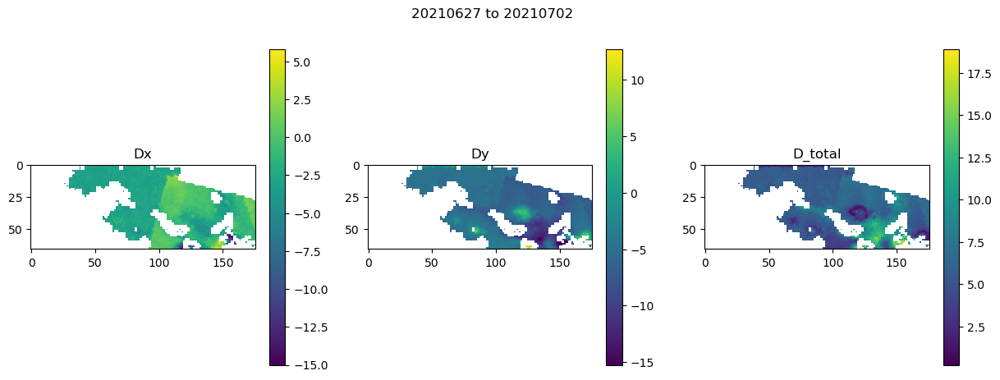

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019070148468017578
20210702 20210705
20210702 20210716
PS_20210702_clipped.tif PS_20210716_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1209600.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_2

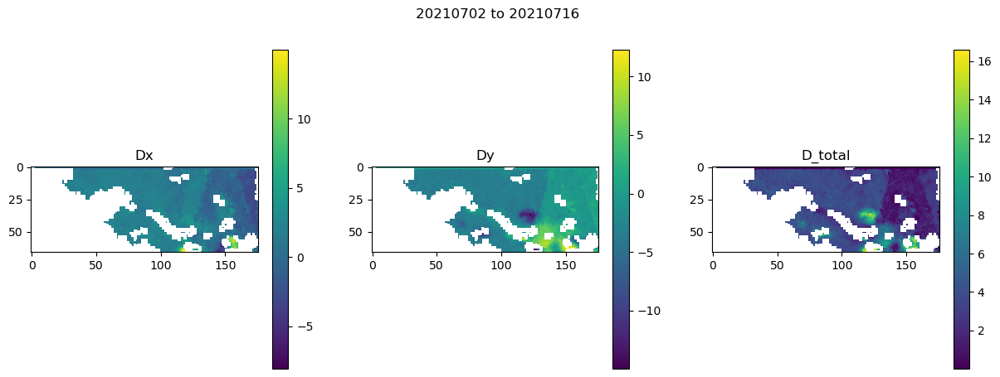

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020747900009155273
20210716 20210719
20210716 20210720
20210716 20210721
PS_20210716_clipped.tif PS_20210721_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/

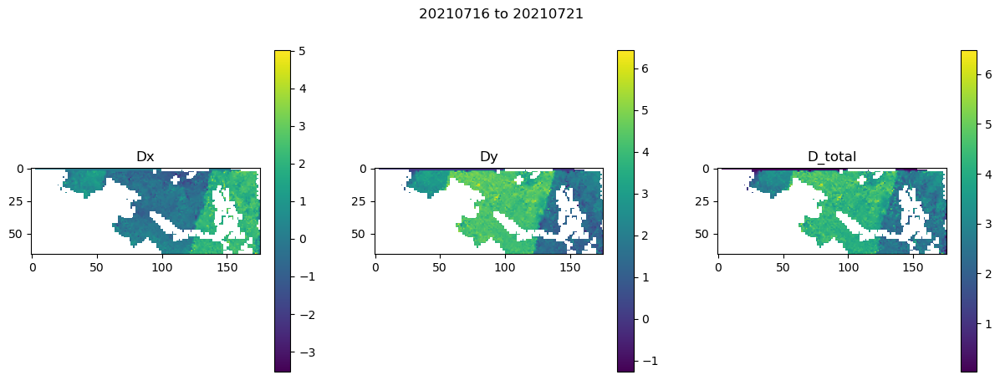

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02182292938232422
PS_20210721_clipped.tif PS_20210726_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

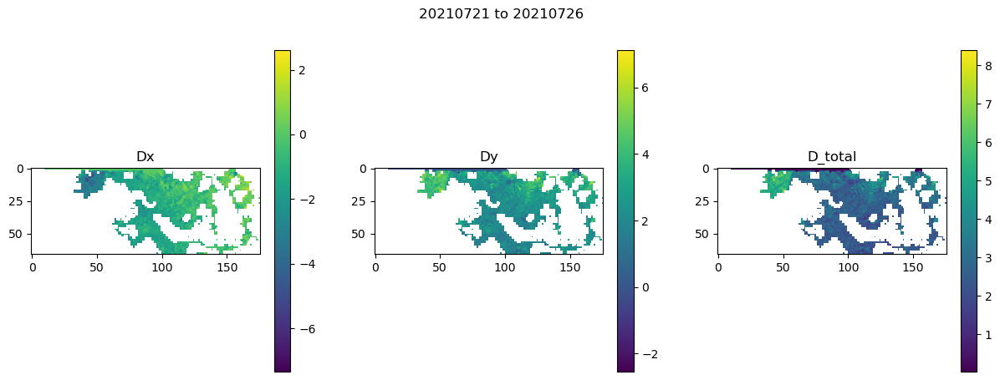

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01934075355529785
20210726 20210731
PS_20210726_clipped.tif PS_20210731_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_d

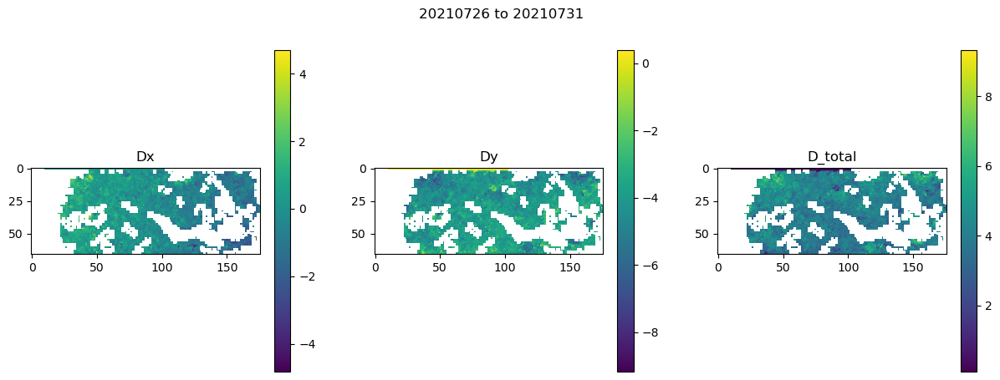

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019942045211791992
20210731 20210803
20210731 20210815
PS_20210731_clipped.tif PS_20210815_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_2

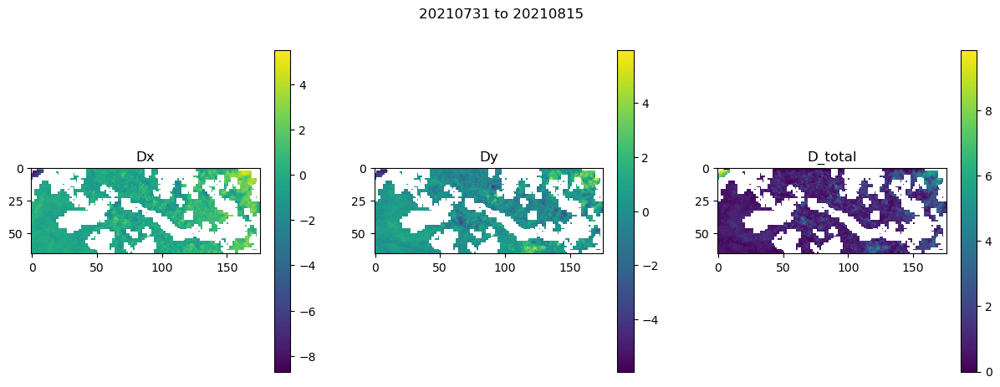

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01986098289489746
PS_20210815_clipped.tif PS_20210821_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Outp

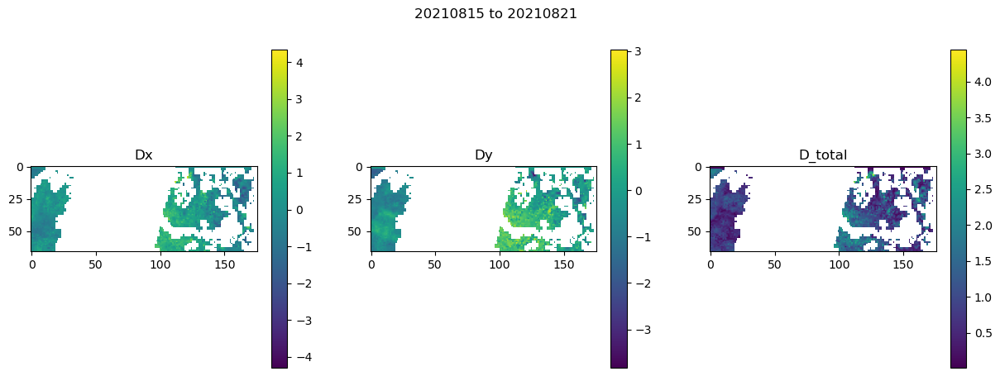

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019498109817504883
20210821 20210823
20210821 20210829
PS_20210821_clipped.tif PS_20210829_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20

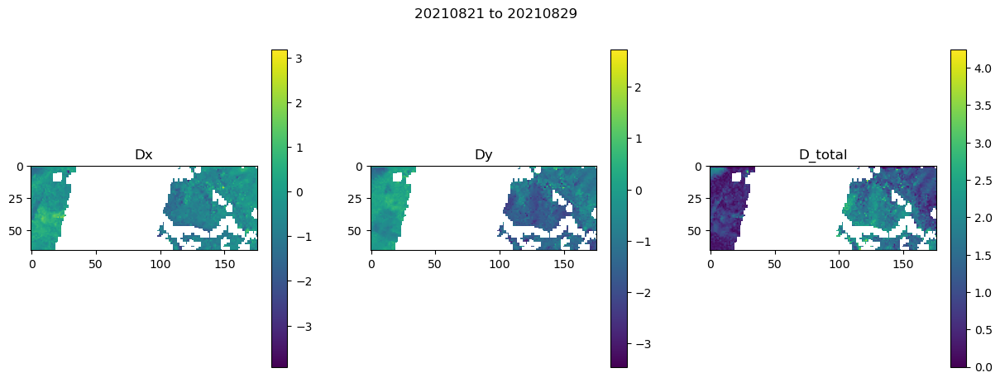

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0181732177734375
20210829 20210831
20210829 20210904
PS_20210829_clipped.tif PS_20210904_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_2007

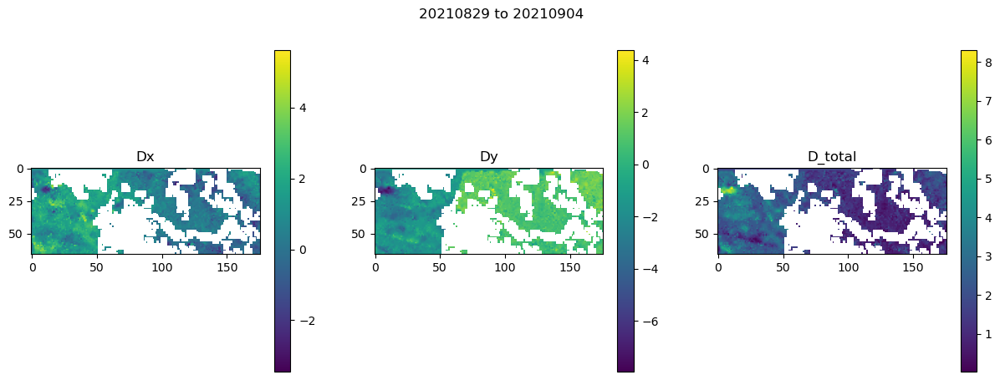

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01926589012145996
20210904 20210911
PS_20210904_clipped.tif PS_20210911_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_d

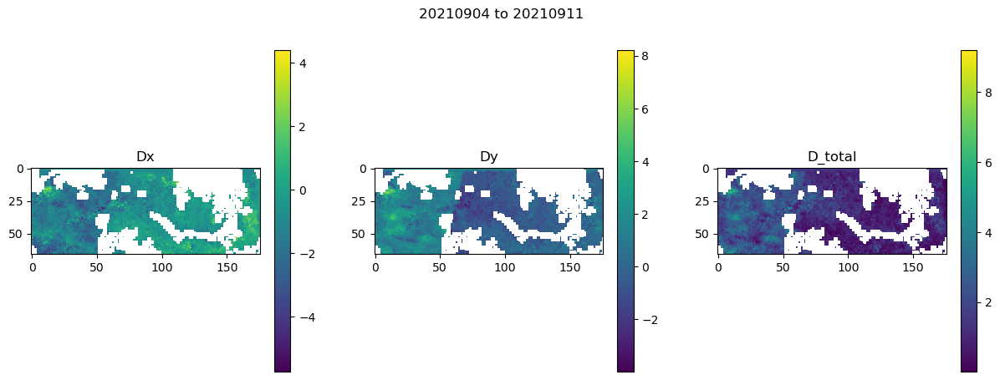

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019238948822021484
PS_20210911_clipped.tif PS_20210918_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

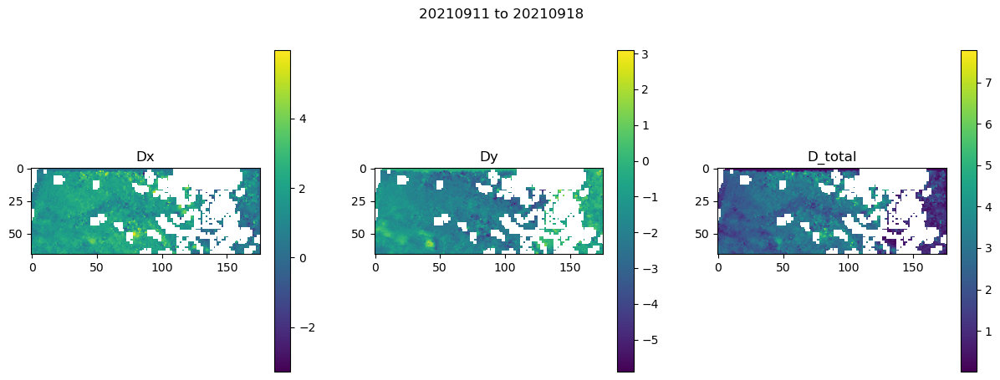

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019622802734375
20210918 20211004
PS_20210918_clipped.tif PS_20211004_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dh

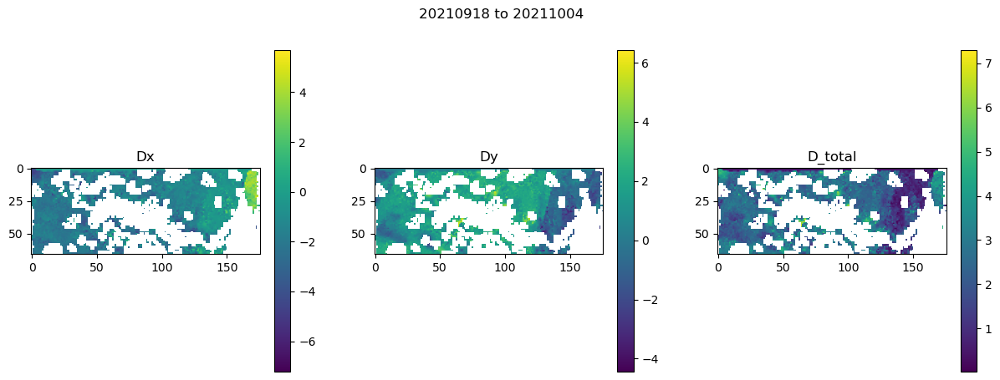

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02094411849975586
20211004 20211010
PS_20211004_clipped.tif PS_20211010_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_d

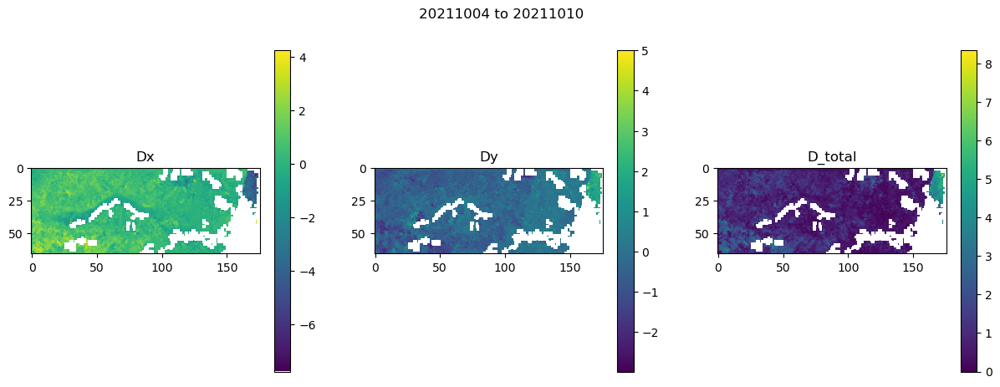

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020936250686645508
PS_20211010_clipped.tif PS_20211016_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdy_100m.tif

Out

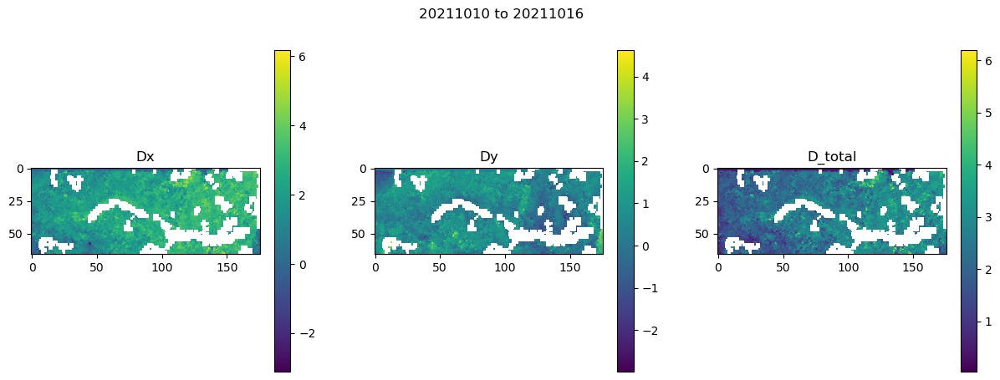

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019128084182739258
20211016 20211021
PS_20211016_clipped.tif PS_20211021_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

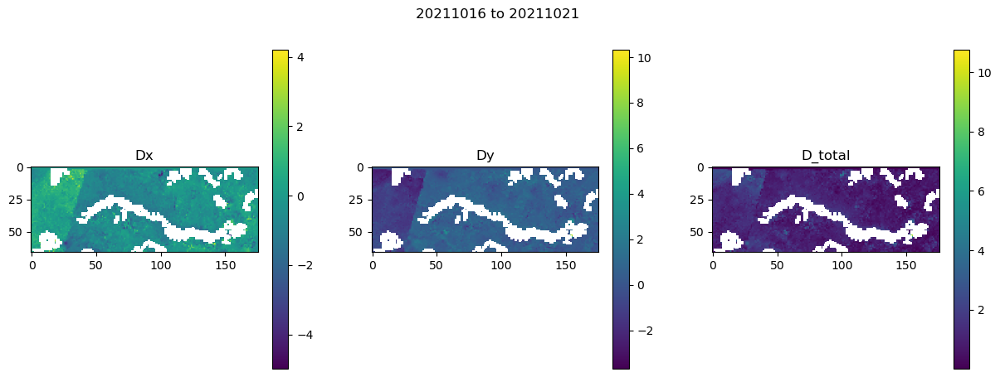

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020328998565673828
20211021 20211031
PS_20211021_clipped.tif PS_20211031_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

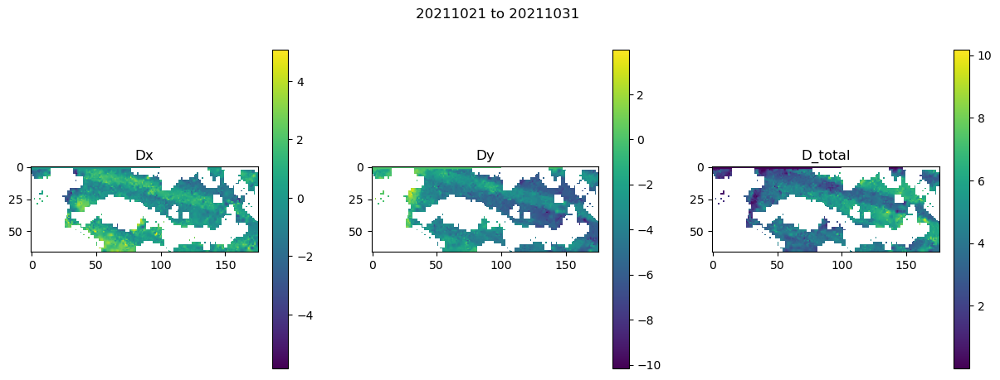

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019466876983642578
20211031 20211107
PS_20211031_clipped.tif PS_20211107_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 591230.0  5.0
Y-direction coordinate: 6656590.0  -5.0
Dimensions: 3520  1352

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 591230.0  608830.0
YLimits: 6649830.0  6656590.0
Extent in km: 17.6  6.76
DEM: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_100m.tif
Slopes: /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_dhdx_100m.tif  /Volumes/SGlacier/VG/autorift_input/Nolan2021_ASTER_20070903_clipped_5m_

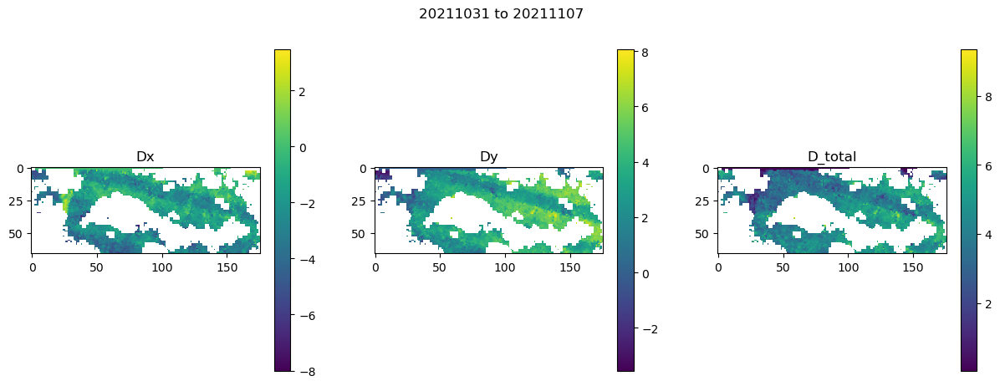

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01977705955505371
No image pair with correct time separation found. Skip to next.
Finished searching.


In [319]:
# try multiple chip sizes and sats
for platform in PLATFORM_LIST:
    # assign the folder path based on the platform
    if platform == 'S2': # sentinel-2
        path = s2path
        ext = '_clipped.tif' # image filename extension
        img_type = 'OPT'
        date_split_idx = 2 # split filename by underscore, index corresponds to image date
    elif platform == 'LS': # landsat
        path = LSpath
        ext = '_clipped.TIF'
        img_type = 'OPT'
        date_split_idx = 3
    elif platform == 'PS': # PlanetScope
        path = PSpath
        ext = '.tif' 
        img_type = 'OPT'
        date_split_idx = 1
    else:
        print('Platform', platform, 'not recognized. Options are "S2", "LS", "PS"')

    # record all possible images and their dates
    dates = []; files = []  
    for file in os.listdir(path):
        if file.endswith(ext):
            date = file.split('_')[date_split_idx] # grab the date from the filename
            dates.append(date); files.append(file) # store the date and filename
    files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
    files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
    files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
    files_df = files_df.reset_index(drop=True) # reset index for searching
    print("Number of files found:",len(files_df))
    
    for min_chipsize in CHIPSIZE_LIST: # MULTIPLE CHIP SIZES
        MINCHIPSIZE = min_chipsize
        # generate geogrid inputs and grab outfilenames
#         [dem_outfile, dhdx_outfile, dhdy_outfile, 
#          vx_outfile, vy_outfile, srx_outfile, 
#          sry_outfile, ssm_outfile, tg_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
#                                                                          refvpath, vx_fname, vy_fname, 
#                                                                          sr_scaling)
        [dem_outfile, dhdx_outfile, dhdy_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
                                                                         refvpath, vx_fname, vy_fname, 
                                                                         sr_scaling)
        #######################################################################
        # # CHOOSE OPTIONAL INPUTS: (set as '' to leave blank)
        # # 1) surface slope:
        #   dhdx = ''; dhdy = ''  
        dhdx = dempath+dhdx_outfile; dhdy = dempath+dhdy_outfile
        
        # # 2) reference velocity:
#         vx = ''; vy = ''    
#         vx = refvpath+'vx_'+str(MINCHIPSIZE)+'m.tif'; vy = refvpath+'vy_'+str(MINCHIPSIZE)+'m.tif'
        
        # # 3) chip sizes:
        csminx = ''; csminy = ''
        csmaxx = ''; csmaxy = ''  
        #             csminx = refvpath+csminx_fname; csminy = refvpath+csminy_fname
        #             csmaxx = refvpath+csmaxx_fname; csmaxy = refvpath+csmaxy_fname
        
        # # 4) stable surface mask:
        ssm = ''
        #             ssm = refvpath+ssm_outfile # stable surface mask 
        
        # # 5) search range limit:
        srx = ''; sry = '' # for best results, never input search range limit
        #######################################################################
        
        for rownum in range(0,len(files_df)-1):
            if rownum == 0: # for the first row, idx1 = 0 and idx2 = 1
                idx1 = rownum
            idx2 = idx1+1 # reset index 2 as the next item 

            if idx1 < len(files_df) and idx2 < len(files_df): # don't surpass the end of the data
                # identify the successive image pairs:
                m = files_df.loc[idx1,'filename']; s = files_df.loc[idx2, 'filename']

                # grab the two dates and convert to datetime objects
                d1s = m.split('_')[date_split_idx]; d2s = s.split('_')[date_split_idx]
#                 if platform == 'PS':
#                     d1s = d1s[:-4]; d2s = d2s[:-4]
                
                # Skip if output already exists for this combination of parameters
                if not os.path.exists(out_path+'velocity_'+d1s+'_'+d2s+'_'+str(min_chipsize)+'m_'+platform+'.tif'):
                    # calculate time separation
                    d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
                    dt = d2-d1; dt = int(dt.days)

                    # evaluate if dates are within the appropriate time separation
                    while (dt < min_dt or dt > max_dt): # dt is outside of appropriate time separation
                        idx2 += 1 # increment index 2

                        if idx2 > len(files_df)-1:
                            print('No image pair with correct time separation found. Skip to next.')
                            idx2 = idx1+1 # reset index 2 as the next item 
                            m = None; s = None
                            break

                        # Keep looking for the correct time separation:
                        m = files_df.loc[idx1,'filename']; s = files_df.loc[idx2, 'filename']

                        # grab the two dates and convert to datetime objects
                        d1s = m.split('_')[date_split_idx]; d2s = s.split('_')[date_split_idx]
                        print(d1s, d2s)
                        if platform == 'S1': # S1 filenames need another split
                            d1s = d1s[:8]; d2s = d2s[:8]
                        d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
                        dt = d2-d1; dt = int(dt.days)

                    # run geogrid and autoRIFT
                    if m is not None and s is not None:
                        print(m,s)
                        indir_m = path+m; indir_s = path+s # path to the two images
                        
                        # ADJUST CODE TO NOT HAVE TO CHANGE THIS BETWEEN SK AND LOWELL
                        dem = dempath+dem_outfile
                        dhdx = dempath+dhdx_outfile
                        dhdy = dempath+dhdy_outfile
                        ###################### RUN GEOGRID ################################
                        run_geogrid_inhouse(out_path, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                                            dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm)
                        
                        ##################### PREP AUTORIFT ##############################
                        gp = out_path # identify files produced from geogrid
                        # remove all empty grids
                        for grid in os.listdir(gp): 
                            if grid.startswith('window') and grid.endswith('.tif'):
                                reader = rio.open(gp+grid) # read dataset
                                data_found = False 
                                for band in range(1,reader.count+1):
                                    testband = reader.read(band) # read in the band
                                    if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                                        data_found = True
                                if not data_found:
                                    print(grid, 'has no data. Removed.')
                                    os.remove(gp+grid)

                        # fill in AutoRIFT parameters using the files
                        mpflag = 0 # leave multiprocessing off

                        # GRID LOCATION (required) from window_location.tif
                        grid_location = rio.open(gp+'window_location.tif')
                        xGrid = grid_location.read(1) # 1st band in window location
                        yGrid = grid_location.read(2) # 2nd band in window location

                        # optional parameters (default None or zero until filled)
                        init_offset = None; search_range = None
                        chip_size_min = None; chip_size_max = None
                        offset2vx = None; offset2vy = None; stable_surface_mask = None
                        Dx0 = None; Dy0 = None; CSMINx0 = None
                        SRx0 = None; SRy0 = None;
                        CSMAXx0 = None; CSMAXy0 = None; SSM = None
                        noDataMask = np.zeros(xGrid.shape).astype(int)

                        if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
                            init_offset = rio.open(gp+'window_offset.tif')
                            Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
                        if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
                            search_range = rio.open(gp+'window_search_range.tif')
                            SRx0 = search_range.read(1); SRy0 = search_range.read(2)
                        if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
                            chip_size_min = rio.open(gp+'window_chip_size_min.tif')
                            CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
                        if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
                            chip_size_max = rio.open(gp+'window_chip_size_max.tif')
                            CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
                        if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
                            offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
                        if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
                            offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
                        if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
                            stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
                            noDataMask = stable_surface_mask.read(1)

                        # other parameters
                        nodata = NO_DATA_VAL # use same as in previous steps
                        geogrid_run_info=None
                        print('AutoRIFT parameters loaded.')

                        ##################### RUN AUTORIFT ##############################
                        # run autoRIFT with function
                        run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                                                 FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, 
                                                 OVERSAMPLE_RATIO, MINCHIPSIZE,
                                                 Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                                             noDataMask, nodata, geogrid_run_info=None)
                else:
                    print('velocity_'+d1s+'_'+d2s+'_'+str(min_chipsize)+'m_'+platform+'.tif already exists.')
                idx1 = idx2 # set the second image index as the new first image index
                if idx2 >= len(files_df)-1:
                    print('Finished searching.')
                    break
